# Credit EDA Assignment

## EDA  Approach-<br>

##### 1. Importing all important Libraries<br>
##### 2. Setting The Jupyter Notebook
   * Changing directory location
   * Setting view options for DataFrame
   * Suppresing unnecessary warnings
   
##### 3. Loading Datasets
##### 4. Data Understanding
   * Checking Structure of data sets
   * Checking other attributes like using info(), describe(), etc 
   
##### 5. Data Cleaning
   * Deleting unnecessary columns and rows
   * Data Quality check - Analysing missing values, improper dtypes, duplicated rows
   * Imputing Missing values 
   * Changing improper data types

##### 6. Binning
   
##### 7. Handling Outliers
   
##### 8. Data Analysis
   * Imbalance Analysis
   * Defining functions for plotting
   * Univariate/Bivariate and Multivariate 

##### 9. Merged dataset analysis
   * Imbalance Analysis
   * Defining functions for plotting
   * Univariate/Bivariate and Multivariate 

# Data cleaning approach
<hr>

* For columns with more than 40% data missing, deleting these columns as imputing these many missing values will add bias to the data<br><br>

* plotting heatmaps of correlation matrix to determine the effect of a particular column on target variable, thus to understand which columns are useful for analysis and which to delete<br><br>

* Remaining columns are imputed using appropriate methods<br><br>

* Categorical columns are imputed using modal value of that particular column<br><br>

* Numeric columns are imputed using mean, median or mode.<br><br>

* Numeric columns with highly skewed data are imputed using median<br><br>

* Using kdeplots to find best imputation value for numeric columns out of mean, median or mode if unsure of best imputation value<br><br>

* Identifying outliers using boxplots<br><br> 

* Creating new columns by binning continuous variables into fixed size bins for range-wise analysis<br><br>

* After binning, deleting the outliers which are extremely far away from the expected range

# Importing Important Libraries

In [1]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt, plotly.express as px

# Setting the Jupyter Notebook

###### Importing 'warnings' library to filter warnings and ignore it

In [2]:
import warnings
warnings.filterwarnings('ignore')

###### Importing os module to change the working directory to current file location

In [3]:
import os
os.chdir('C:\\Users\\91703\\Downloads')

###### setting options in pandas to view all columns, all rows, with full width of rows and columns without any truncation

In [4]:
pd.set_option('max_rows',None, 'max_columns', None, 'display.width', None, 'display.max_colwidth', None, 'display.max_rows', None)  

In [5]:
#setting the float format so to display only 6 digits after the decimal
pd.options.display.float_format = '{:.6f}'.format 

# Loading Datasets

###### reading the 'column_description' file

In [6]:
column_description = pd.read_csv('columns_description.csv')

###### reading the 'application_data' file

In [7]:
application = pd.read_csv('application_data.csv')

###### reading the 'prev_application'  file

In [8]:
prev_application = pd.read_csv('previous_application.csv')

# Data Understanding

### Column description dataset

In [9]:
column_description   # understanding each column and its meaning

,Unnamed: 0,Table,Row,Description,Special
0,1,application_data,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_data,TARGET,"Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)",NaN
2,5,application_data,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_data,CODE_GENDER,Gender of the client,NaN
4,7,application_data,FLAG_OWN_CAR,Flag if the client owns a car,NaN
5,8,application_data,FLAG_OWN_REALTY,Flag if client owns a house or flat,NaN
6,9,application_data,CNT_CHILDREN,Number of children the client has,NaN
7,10,application_data,AMT_INCOME_TOTAL,Income of the client,NaN
8,11,application_data,AMT_CREDIT,Credit amount of the loan,NaN
9,12,application_data,AMT_ANNUITY,Loan annuity,NaN


### application dataset

In [10]:
application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.000000,406597.500000,24700.500000,351000.000000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.000000,-2120,NaN,1,1,0,1,1,0,Laborers,1.000000,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.024700,0.036900,0.972200,0.619200,0.014300,0.000000,0.069000,0.083300,0.125000,0.036900,0.020200,0.019000,0.000000,0.000000,0.025200,0.038300,0.972200,0.634100,0.014400,0.000000,0.069000,0.083300,0.125000,0.037700,0.022000,0.019800,0.000000,0.000000,0.025000,0.036900,0.972200,0.624300,0.014400,0.000000,0.069000,0.083300,0.125000,0.037500,0.020500,0.019300,0.000000,0.000000,reg oper account,block of flats,0.014900,"Stone, brick",No,2.000000,2.000000,2.000000,2.000000,-1134.000000,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
1,100003,0,Cash loans,F,N,N,0,270000.000000,1293502.500000,35698.500000,1129500.000000,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.000000,-291,NaN,1,1,0,1,1,0,Core staff,2.000000,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.095900,0.052900,0.985100,0.796000,0.060500,0.080000,0.034500,0.291700,0.333300,0.013000,0.077300,0.054900,0.003900,0.009800,0.092400,0.053800,0.985100,0.804000,0.049700,0.080600,0.034500,0.291700,0.333300,0.012800,0.079000,0.055400,0.000000,0.000000,0.096800,0.052900,0.985100,0.798700,0.060800,0.080000,0.034500,0.291700,0.333300,0.013200,0.078700,0.055800,0.003900,0.010000,reg oper account,block of flats,0.071400,Block,No,1.000000,0.000000,1.000000,0.000000,-828.000000,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,100004,0,Revolving loans,M,Y,Y,0,675

In [11]:
application.shape # checking the shape of this file

(307511, 122)

In [12]:
application.info(verbose=True)    # checking the summary of this dataset
# checking the summary of application_data file with 'verbose=True' for having no truncation

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Dtype  
---   ------                        -----  
 0    SK_ID_CURR                    int64  
 1    TARGET                        int64  
 2    NAME_CONTRACT_TYPE            object 
 3    CODE_GENDER                   object 
 4    FLAG_OWN_CAR                  object 
 5    FLAG_OWN_REALTY               object 
 6    CNT_CHILDREN                  int64  
 7    AMT_INCOME_TOTAL              float64
 8    AMT_CREDIT                    float64
 9    AMT_ANNUITY                   float64
 10   AMT_GOODS_PRICE               float64
 11   NAME_TYPE_SUITE               object 
 12   NAME_INCOME_TYPE              object 
 13   NAME_EDUCATION_TYPE           object 
 14   NAME_FAMILY_STATUS            object 
 15   NAME_HOUSING_TYPE             object 
 16   REGION_POPULATION_RELATIVE    float64
 17   DAYS_BIRTH                    int64  
 18   DA

In [13]:
application.describe()  #checking statistical information of application data set

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307499.000000,307233.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,306851.000000,246546.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,168797.919297,599025.999706,27108.573909,538396.207429,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,0.514393,0.510853,0.117440,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,0.042553,0.074490,0.145193,0.222315,0.228058,0.064958,0.105645,0.105975,0.008076,0.027022,0.117850,0.08795

In [14]:
application.dtypes    #checking dtypes 

SK_ID_CURR                        int64
TARGET                            int64
NAME_CONTRACT_TYPE               object
CODE_GENDER                      object
FLAG_OWN_CAR                     object
FLAG_OWN_REALTY                  object
CNT_CHILDREN                      int64
AMT_INCOME_TOTAL                float64
AMT_CREDIT                      float64
AMT_ANNUITY                     float64
AMT_GOODS_PRICE                 float64
NAME_TYPE_SUITE                  object
NAME_INCOME_TYPE                 object
NAME_EDUCATION_TYPE              object
NAME_FAMILY_STATUS               object
NAME_HOUSING_TYPE                object
REGION_POPULATION_RELATIVE      float64
DAYS_BIRTH                        int64
DAYS_EMPLOYED                     int64
DAYS_REGISTRATION               float64
DAYS_ID_PUBLISH                   int64
OWN_CAR_AGE                     float64
FLAG_MOBIL                        int64
FLAG_EMP_PHONE                    int64
FLAG_WORK_PHONE                   int64


### previous application dataset

In [15]:
prev_application.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430000,17145.000000,17145.000000,0.000000,17145.000000,SATURDAY,15,Y,1,0.000000,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.000000,middle,POS mobile with interest,365243.000000,-42.000000,300.000000,-42.000000,-37.000000,0.000000
1,2802425,108129,Cash loans,25188.615000,607500.000000,679671.000000,NaN,607500.000000,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.000000,low_action,Cash X-Sell: low,365243.000000,-134.000000,916.000000,365243.000000,365243.000000,1.000000
2,2523466,122040,Cash loans,15060.735000,112500.000000,136444.500000,NaN,112500.000000,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.000000,high,Cash X-Sell: high,365243.000000,-271.000000,59.000000,365243.000000,365243.000000,1.000000
3,2819243,176158,Cash loans,47041.335000,450000.000000,470790.000000,NaN,450000.000000,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.000000,middle,Cash X-Sell: middle,365243.000000,-482.000000,-152.000000,-182.000000,-177.000000,1.000000
4,1784265,202054,Cash loans,31924.395000,337500.000000,404055.000000,NaN,337500.000000,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.000000,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
prev_application.shape # checking the shape of this file

(1670214, 37)

In [17]:
prev_application.info()   #checking the summary of this dataset

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [18]:
prev_application.describe()   #checking statistical information of application data set

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1670214.000000,1670214.000000,1297979.000000,1670214.000000,1670213.000000,774370.000000,1284699.000000,1670214.000000,1670214.000000,774370.000000,5951.000000,5951.000000,1670214.000000,1670214.000000,1297984.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1923089.135331,278357.174099,15955.120659,175233.860360,196114.021218,6697.402139,227847.279283,12.484182,0.996468,0.079637,0.188357,0.773503,-880.679668,313.951115,16.054082,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,532597.958696,102814.823849,14782.137335,292779.762387,318574.616546,20921.495410,315396.557937,3.334028,0.059330,0.107823,0.087671,0.100879,779.099667,7127.443459,14.567288,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1000001.000000,100001.000000,0.000000,0.000000,0.000000,-0.900000,0.000000,0.000000,0.000000,-0.000015,0.034781,0.373150,-2922.000000,-1.000000,0.000000,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1461857.250000,189329.000000,6321.780000,18720.000000,24160.500000,0.000000,50841.000000,10.000000,1.000000,0.000000,0.160716,0.715645,-1300.000000,-1.000000,6.000000,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1923110.500000,278714.500000,11250.000000,71046.000000,80541.000000,1638.000000,112320.000000,12.000000,1.000000,0.051605,0.189122,0.835095,-581.000000,3.000000,12.000000,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2384279.750000,367514.000000,20658.420000,180360.000000,216418.500000,7740.000000,234000.000000,15.000000,1.000000,0.108909,0.193330,0.852537,-280.000000,82.000000,24.000000,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2845382.000000,456255.000000,418058.145000,6905160.000000,6905160.000000,3060045.000000,6905160.000000,23.000000,1.000000,1.000000,1.000000,1.000000,-1.000000,4000000.000000,84.000000,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


In [19]:
prev_application.dtypes   #checking dtypes

SK_ID_PREV                       int64
SK_ID_CURR                       int64
NAME_CONTRACT_TYPE              object
AMT_ANNUITY                    float64
AMT_APPLICATION                float64
AMT_CREDIT                     float64
AMT_DOWN_PAYMENT               float64
AMT_GOODS_PRICE                float64
WEEKDAY_APPR_PROCESS_START      object
HOUR_APPR_PROCESS_START          int64
FLAG_LAST_APPL_PER_CONTRACT     object
NFLAG_LAST_APPL_IN_DAY           int64
RATE_DOWN_PAYMENT              float64
RATE_INTEREST_PRIMARY          float64
RATE_INTEREST_PRIVILEGED       float64
NAME_CASH_LOAN_PURPOSE          object
NAME_CONTRACT_STATUS            object
DAYS_DECISION                    int64
NAME_PAYMENT_TYPE               object
CODE_REJECT_REASON              object
NAME_TYPE_SUITE                 object
NAME_CLIENT_TYPE                object
NAME_GOODS_CATEGORY             object
NAME_PORTFOLIO                  object
NAME_PRODUCT_TYPE               object
CHANNEL_TYPE             

# Data Cleaning

###### Firstly cleaning the application dataset and then prev_application

## Cleaning application dataset

### Data Quality check - Analysing missing values, improper dtypes, duplicated rows

In [20]:
application.duplicated().sum() 

0

In [21]:
application.isnull().sum()   # cheking the null value count for each column

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                         12
AMT_GOODS_PRICE                    278
NAME_TYPE_SUITE                   1292
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     202929
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

In [22]:
application.isnull().sum()/len(application)*100 
# checking for the percentages of null values in each column

SK_ID_CURR                      0.000000
TARGET                          0.000000
NAME_CONTRACT_TYPE              0.000000
CODE_GENDER                     0.000000
FLAG_OWN_CAR                    0.000000
FLAG_OWN_REALTY                 0.000000
CNT_CHILDREN                    0.000000
AMT_INCOME_TOTAL                0.000000
AMT_CREDIT                      0.000000
AMT_ANNUITY                     0.003902
AMT_GOODS_PRICE                 0.090403
NAME_TYPE_SUITE                 0.420148
NAME_INCOME_TYPE                0.000000
NAME_EDUCATION_TYPE             0.000000
NAME_FAMILY_STATUS              0.000000
NAME_HOUSING_TYPE               0.000000
REGION_POPULATION_RELATIVE      0.000000
DAYS_BIRTH                      0.000000
DAYS_EMPLOYED                   0.000000
DAYS_REGISTRATION               0.000000
DAYS_ID_PUBLISH                 0.000000
OWN_CAR_AGE                    65.990810
FLAG_MOBIL                      0.000000
FLAG_EMP_PHONE                  0.000000
FLAG_WORK_PHONE 

#####  Checking for null values in object dtype columns other than NaN values

In [23]:
application.NAME_CONTRACT_TYPE.value_counts()   #we dont have any missing val in NAME_CONTRACT_TYPE variable   

Cash loans         278232
Revolving loans     29279
Name: NAME_CONTRACT_TYPE, dtype: int64

In [24]:
application.FLAG_OWN_CAR.value_counts()  #we dont have any missing value

N    202924
Y    104587
Name: FLAG_OWN_CAR, dtype: int64

In [25]:
application.FLAG_OWN_REALTY.value_counts()  #we dont have any missing value

Y    213312
N     94199
Name: FLAG_OWN_REALTY, dtype: int64

In [26]:
application.NAME_TYPE_SUITE.value_counts()  #we dont have any missing value

Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, dtype: int64

In [27]:
application.NAME_INCOME_TYPE.value_counts()  #we dont have any missing value

Working                 158774
Commercial associate     71617
Pensioner                55362
State servant            21703
Unemployed                  22
Student                     18
Businessman                 10
Maternity leave              5
Name: NAME_INCOME_TYPE, dtype: int64

In [28]:
application.NAME_EDUCATION_TYPE.value_counts()  #we dont have any missing value

Secondary / secondary special    218391
Higher education                  74863
Incomplete higher                 10277
Lower secondary                    3816
Academic degree                     164
Name: NAME_EDUCATION_TYPE, dtype: int64

In [29]:
application.NAME_FAMILY_STATUS.value_counts()  #we dont have any missing value

Married                 196432
Single / not married     45444
Civil marriage           29775
Separated                19770
Widow                    16088
Unknown                      2
Name: NAME_FAMILY_STATUS, dtype: int64

In [30]:
application.NAME_HOUSING_TYPE.value_counts()  #we dont have any missing value

House / apartment      272868
With parents            14840
Municipal apartment     11183
Rented apartment         4881
Office apartment         2617
Co-op apartment          1122
Name: NAME_HOUSING_TYPE, dtype: int64

In [31]:
application.OCCUPATION_TYPE.value_counts(normalize=True)*100  #we dont have any missing value

Laborers                26.139636
Sales staff             15.205570
Core staff              13.058924
Managers                10.122679
Drivers                  8.811576
High skill tech staff    5.390299
Accountants              4.648067
Medicine staff           4.043672
Security staff           3.183498
Cooking staff            2.816408
Cleaning staff           2.203960
Private service staff    1.256158
Low-skill Laborers       0.991379
Waiters/barmen staff     0.638499
Secretaries              0.618132
Realty agents            0.355722
HR staff                 0.266673
IT staff                 0.249147
Name: OCCUPATION_TYPE, dtype: float64

In [32]:
application.WEEKDAY_APPR_PROCESS_START.value_counts() #we dont have any missing value

TUESDAY      53901
WEDNESDAY    51934
MONDAY       50714
THURSDAY     50591
FRIDAY       50338
SATURDAY     33852
SUNDAY       16181
Name: WEEKDAY_APPR_PROCESS_START, dtype: int64

In [33]:
application.CODE_GENDER.value_counts(normalize=True)  
# we are having XNA as missing values in CODE_GENDER column which are significantly less
# so we can impute them with the modal value i.e. F

F     0.658344
M     0.341643
XNA   0.000013
Name: CODE_GENDER, dtype: float64

In [34]:
application.ORGANIZATION_TYPE.value_counts()  # we having XNA as missing values in ORGANIZATION_TYPE column

Business Entity Type 3    67992
XNA                       55374
Self-employed             38412
Other                     16683
Medicine                  11193
Business Entity Type 2    10553
Government                10404
School                     8893
Trade: type 7              7831
Kindergarten               6880
Construction               6721
Business Entity Type 1     5984
Transport: type 4          5398
Trade: type 3              3492
Industry: type 9           3368
Industry: type 3           3278
Security                   3247
Housing                    2958
Industry: type 11          2704
Military                   2634
Bank                       2507
Agriculture                2454
Police                     2341
Transport: type 2          2204
Postal                     2157
Security Ministries        1974
Trade: type 2              1900
Restaurant                 1811
Services                   1575
University                 1327
Industry: type 7           1307
Transpor

### Deleting unnecessary columns and rows

###### Dropping all cloumns with greater than 40% missing values

In [35]:
col_to_drop = (application.isnull().sum()/len(application)*100)[(application.isnull().sum()/len(application)*100 > 40)].index.tolist()        
#creating a variable containing cloumn names having >40% misiing values

In [36]:
application.drop(labels=col_to_drop, axis=1, inplace= True) #dropping all columns having >40% misiing values

In [37]:
application.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 73 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   307511 non-null  int64  
 1   TARGET                       307511 non-null  int64  
 2   NAME_CONTRACT_TYPE           307511 non-null  object 
 3   CODE_GENDER                  307511 non-null  object 
 4   FLAG_OWN_CAR                 307511 non-null  object 
 5   FLAG_OWN_REALTY              307511 non-null  object 
 6   CNT_CHILDREN                 307511 non-null  int64  
 7   AMT_INCOME_TOTAL             307511 non-null  float64
 8   AMT_CREDIT                   307511 non-null  float64
 9   AMT_ANNUITY                  307499 non-null  float64
 10  AMT_GOODS_PRICE              307233 non-null  float64
 11  NAME_TYPE_SUITE              306219 non-null  object 
 12  NAME_INCOME_TYPE             307511 non-null  object 
 13 

In [38]:
# checking submission count of each document
for i in range(47,67):
    print((application.iloc[:,i]==1).sum())

13
218340
25
4648
27078
59
25024
1198
7
1203
2
1084
903
372
3053
82
2500
183
156
103


In [39]:
# checking submission percentage of each document
for i in range(47,67):
    print((application.iloc[:,i]==1).sum()/len(application)*100)

0.004227491049100683
71.00233812774177
0.008129790479039774
1.5114906458630748
8.80553866365756
0.019186305530533868
8.137595077899652
0.389579559755586
0.0022763413341311367
0.3912055178513939
0.0006503832383231819
0.3525077151711646
0.2936480321029166
0.12097128232811183
0.9928100133003372
0.026665712771250457
0.8129790479039775
0.05951006630657115
0.05072989258920819
0.03349473677364387


# Insight
<hr>

* Most documments are not submited by significant amount of people

* Only document 3,5,6 and 8 have more than 1% submission with document 3 having 71% submission rate and doc 5 and 8 having 8   

###### dropping all other FLAG_DOCUMENT columns except FLAG_DOC_3

In [40]:
Flag_doc_drop = list(application.iloc[:,50:67].columns.values)   
Flag_doc_drop.extend(['FLAG_DOCUMENT_2','FLAG_DOCUMENT_4'])   
Flag_doc_drop
# creating a list of all FLAG_DOCUMENT column names to drop

['FLAG_DOCUMENT_5',
 'FLAG_DOCUMENT_6',
 'FLAG_DOCUMENT_7',
 'FLAG_DOCUMENT_8',
 'FLAG_DOCUMENT_9',
 'FLAG_DOCUMENT_10',
 'FLAG_DOCUMENT_11',
 'FLAG_DOCUMENT_12',
 'FLAG_DOCUMENT_13',
 'FLAG_DOCUMENT_14',
 'FLAG_DOCUMENT_15',
 'FLAG_DOCUMENT_16',
 'FLAG_DOCUMENT_17',
 'FLAG_DOCUMENT_18',
 'FLAG_DOCUMENT_19',
 'FLAG_DOCUMENT_20',
 'FLAG_DOCUMENT_21',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_4']

In [41]:
application.drop(labels=Flag_doc_drop, axis=1, inplace=True) #dropping the above columns

In [42]:
application.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 54 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   307511 non-null  int64  
 1   TARGET                       307511 non-null  int64  
 2   NAME_CONTRACT_TYPE           307511 non-null  object 
 3   CODE_GENDER                  307511 non-null  object 
 4   FLAG_OWN_CAR                 307511 non-null  object 
 5   FLAG_OWN_REALTY              307511 non-null  object 
 6   CNT_CHILDREN                 307511 non-null  int64  
 7   AMT_INCOME_TOTAL             307511 non-null  float64
 8   AMT_CREDIT                   307511 non-null  float64
 9   AMT_ANNUITY                  307499 non-null  float64
 10  AMT_GOODS_PRICE              307233 non-null  float64
 11  NAME_TYPE_SUITE              306219 non-null  object 
 12  NAME_INCOME_TYPE             307511 non-null  object 
 13 

In [43]:
application.shape

(307511, 54)

In [44]:
(application.isnull().sum()/len(application)*100)
# checking all the columns with null values again

SK_ID_CURR                     0.000000
TARGET                         0.000000
NAME_CONTRACT_TYPE             0.000000
CODE_GENDER                    0.000000
FLAG_OWN_CAR                   0.000000
FLAG_OWN_REALTY                0.000000
CNT_CHILDREN                   0.000000
AMT_INCOME_TOTAL               0.000000
AMT_CREDIT                     0.000000
AMT_ANNUITY                    0.003902
AMT_GOODS_PRICE                0.090403
NAME_TYPE_SUITE                0.420148
NAME_INCOME_TYPE               0.000000
NAME_EDUCATION_TYPE            0.000000
NAME_FAMILY_STATUS             0.000000
NAME_HOUSING_TYPE              0.000000
REGION_POPULATION_RELATIVE     0.000000
DAYS_BIRTH                     0.000000
DAYS_EMPLOYED                  0.000000
DAYS_REGISTRATION              0.000000
DAYS_ID_PUBLISH                0.000000
FLAG_MOBIL                     0.000000
FLAG_EMP_PHONE                 0.000000
FLAG_WORK_PHONE                0.000000
FLAG_CONT_MOBILE               0.000000


###### Checking for correlation of EXT_SOURCE_2 and EXT_SOURCE_3 with TARGET variable as we don't have much info about them

In [45]:
corr = application[['TARGET','EXT_SOURCE_3','EXT_SOURCE_2']].corr() # creating a correlation matrix and storing it in a variable corr

<AxesSubplot:>

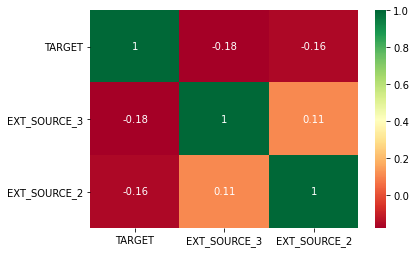

In [46]:
sns.heatmap(corr, annot=True, cmap='RdYlGn')  #ploting heatmap of above correlation matrix

###### We can see that there is a very weak correlation between TARGET variable and EXT_SOURCE_3 and TARGET variable and EXT_SOURCE_2, so we can drop them

In [47]:
application.drop(labels=['EXT_SOURCE_3','EXT_SOURCE_2'], axis=1, inplace=True)   # dropping EXT_SOURCE_2 and EXT_SOURCE_3 columnss   

In [48]:
application.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 52 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   307511 non-null  int64  
 1   TARGET                       307511 non-null  int64  
 2   NAME_CONTRACT_TYPE           307511 non-null  object 
 3   CODE_GENDER                  307511 non-null  object 
 4   FLAG_OWN_CAR                 307511 non-null  object 
 5   FLAG_OWN_REALTY              307511 non-null  object 
 6   CNT_CHILDREN                 307511 non-null  int64  
 7   AMT_INCOME_TOTAL             307511 non-null  float64
 8   AMT_CREDIT                   307511 non-null  float64
 9   AMT_ANNUITY                  307499 non-null  float64
 10  AMT_GOODS_PRICE              307233 non-null  float64
 11  NAME_TYPE_SUITE              306219 non-null  object 
 12  NAME_INCOME_TYPE             307511 non-null  object 
 13 

### Imputing Missing values

#### Imputing Missing Values of categorical variables with Modal values

###### OCCUPATION_TYPE

* As OCCUPATION_TYPE is a very neccesary variable for the analysis we cannot drop is also imputing this many amount of values will result in incorrect data representation<br><br>
So creating a new category "Unknown"for the missing values

In [49]:
application.OCCUPATION_TYPE.fillna('Unknown' , inplace=True)  # imputing missing values with 'Unknown'

In [50]:
application.OCCUPATION_TYPE.value_counts()

Unknown                  96391
Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, dtype: int64

* We have an unknown value 'XNA' but the number of total XNA values is very large so it is best to not change it

###### NAME_TYPE_SUITE

In [51]:
application.NAME_TYPE_SUITE.value_counts(normalize=True)
# we have 81% of values as 'Unaccompanied' - so imputing missing values with the modal value 'Unaccompanied'

Unaccompanied     0.811596
Family            0.131112
Spouse, partner   0.037130
Children          0.010669
Other_B           0.005780
Other_A           0.002828
Group of people   0.000885
Name: NAME_TYPE_SUITE, dtype: float64

In [52]:
application.NAME_TYPE_SUITE.fillna(application.NAME_TYPE_SUITE.mode()[0], inplace=True)  # imputing missing values

In [53]:
application.NAME_TYPE_SUITE.value_counts(normalize=True)

Unaccompanied     0.812387
Family            0.130561
Spouse, partner   0.036974
Children          0.010624
Other_B           0.005756
Other_A           0.002816
Group of people   0.000881
Name: NAME_TYPE_SUITE, dtype: float64

###### CODE_GENDER 

In [54]:
application.CODE_GENDER.value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

In [55]:
application.CODE_GENDER = application.CODE_GENDER.apply(lambda x: 'F' if x=='XNA' else x)
application.CODE_GENDER.value_counts()

F    202452
M    105059
Name: CODE_GENDER, dtype: int64

###### NAME_FAMILY_STATUS

In [56]:
application.NAME_FAMILY_STATUS.value_counts(normalize=True)

Married                0.638780
Single / not married   0.147780
Civil marriage         0.096826
Separated              0.064290
Widow                  0.052317
Unknown                0.000007
Name: NAME_FAMILY_STATUS, dtype: float64

In [57]:
# Converting 'Unknown' values to 'Married'
application.NAME_FAMILY_STATUS = application.NAME_FAMILY_STATUS.apply(lambda x: 'Married' if x=='Unknown' else x)

#### Imputing Missing Values of Numerical variables with Median or Mean values

###### DAYS_LAST_PHONE_CHANGE

In [58]:
application.DAYS_LAST_PHONE_CHANGE.head()   # we can see days being -ve which is not possible 

0   -1134.000000
1    -828.000000
2    -815.000000
3    -617.000000
4   -1106.000000
Name: DAYS_LAST_PHONE_CHANGE, dtype: float64

In [59]:
application.DAYS_LAST_PHONE_CHANGE = application.DAYS_LAST_PHONE_CHANGE.apply(lambda x: abs(x))   #changing -ve values to +ve

In [60]:
application.DAYS_LAST_PHONE_CHANGE.value_counts()

0.000000       37672
1.000000        2812
2.000000        2318
3.000000        1763
4.000000        1285
5.000000         824
6.000000         537
7.000000         442
8.000000         278
476.000000       222
352.000000       213
392.000000       211
364.000000       209
479.000000       204
329.000000       203
358.000000       203
293.000000       202
350.000000       201
399.000000       200
441.000000       200
404.000000       199
463.000000       198
9.000000         198
11.000000        198
301.000000       197
483.000000       195
362.000000       195
496.000000       195
304.000000       195
308.000000       195
355.000000       194
500.000000       194
427.000000       193
334.000000       193
391.000000       193
448.000000       192
347.000000       192
413.000000       191
415.000000       191
469.000000       190
546.000000       190
447.000000       190
499.000000       189
353.000000       188
566.000000       188
428.000000       187
420.000000       187
417.000000   

In [61]:
application.DAYS_LAST_PHONE_CHANGE.fillna(application.DAYS_LAST_PHONE_CHANGE.mode()[0], inplace=True)

###### CNT_FAM_MEMBERS

In [62]:
application.CNT_FAM_MEMBERS.fillna(application.CNT_FAM_MEMBERS.median(), inplace=True)  #imputing missing values in CNT_FAM_MEMBERS withs its median     

###### AMT_ANNUITY

In [63]:
application.AMT_ANNUITY.describe()

count   307499.000000
mean     27108.573909
std      14493.737315
min       1615.500000
25%      16524.000000
50%      24903.000000
75%      34596.000000
max     258025.500000
Name: AMT_ANNUITY, dtype: float64

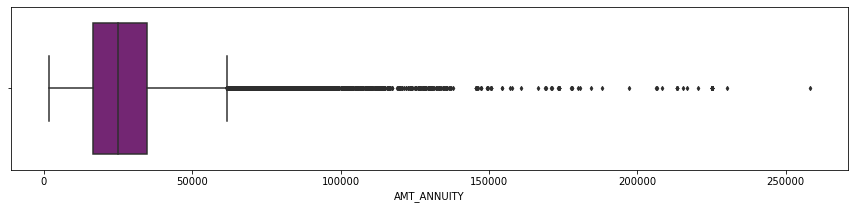

In [64]:
plt.figure(figsize=[15,3])
sns.boxplot(application.AMT_ANNUITY, color=[0.5,0.1,0.5], fliersize=3)
plt.show()         # checking for skewness of data using boxplot

In [65]:
application.AMT_ANNUITY.fillna(application.AMT_ANNUITY.median(), inplace= True)

###### Similarly imputing all the numeric columns having <1% missing data with median

In [66]:
application.AMT_GOODS_PRICE.fillna(application.AMT_GOODS_PRICE.median(), inplace=True)
application.OBS_30_CNT_SOCIAL_CIRCLE.fillna(application.OBS_30_CNT_SOCIAL_CIRCLE.median(), inplace=True)
application.OBS_60_CNT_SOCIAL_CIRCLE.fillna(application.OBS_60_CNT_SOCIAL_CIRCLE.median(), inplace=True)
application.DEF_30_CNT_SOCIAL_CIRCLE.fillna(application.DEF_30_CNT_SOCIAL_CIRCLE.median(), inplace=True)
application.DEF_60_CNT_SOCIAL_CIRCLE.fillna(application.DEF_60_CNT_SOCIAL_CIRCLE.median(), inplace=True)

###### Now imputing missing values of remaining columns

In [67]:
application[['AMT_REQ_CREDIT_BUREAU_HOUR','AMT_REQ_CREDIT_BUREAU_DAY','AMT_REQ_CREDIT_BUREAU_WEEK','AMT_REQ_CREDIT_BUREAU_MON',
     'AMT_REQ_CREDIT_BUREAU_QRT','AMT_REQ_CREDIT_BUREAU_YEAR']].describe()
# checking statistical data of each column

,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [68]:
col_names = ['AMT_REQ_CREDIT_BUREAU_HOUR','AMT_REQ_CREDIT_BUREAU_DAY','AMT_REQ_CREDIT_BUREAU_WEEK','AMT_REQ_CREDIT_BUREAU_MON',
     'AMT_REQ_CREDIT_BUREAU_QRT']

for i in col_names:
    application[i].fillna(application[i].median(), inplace=True)

###### Now analysing which is the best value to impute in AMT_REQ_CREDIT_BUREAU_YEAR column by observing change in kdeplots wrt mean median and mode

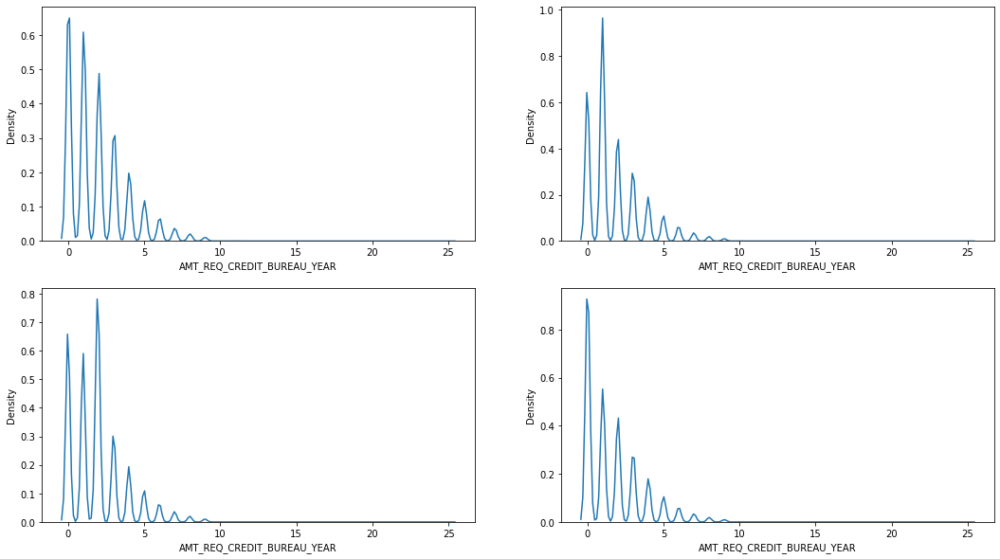

In [69]:
# plotting kdeplots to check the which imputation method whill detain the distribution of data
plt.figure(figsize=(18,10))
plt.subplot(221)
sns.kdeplot(application['AMT_REQ_CREDIT_BUREAU_YEAR'])

plt.subplot(222)
sns.kdeplot(application['AMT_REQ_CREDIT_BUREAU_YEAR'].fillna(application.AMT_REQ_CREDIT_BUREAU_YEAR.median()))

plt.subplot(223)
sns.kdeplot(application['AMT_REQ_CREDIT_BUREAU_YEAR'].fillna(application.AMT_REQ_CREDIT_BUREAU_YEAR.mean()))

plt.subplot(224)
sns.kdeplot(application['AMT_REQ_CREDIT_BUREAU_YEAR'].fillna(application.AMT_REQ_CREDIT_BUREAU_YEAR.mode()[0]))
plt.show()

In [70]:
# imputing missing values in AMT_REQ_CREDIT_BUREAU_YEAR
application['AMT_REQ_CREDIT_BUREAU_YEAR'].fillna(application['AMT_REQ_CREDIT_BUREAU_YEAR'].mode()[0], inplace=True)

In [71]:
application.isnull().sum()/len(application)*100  # checking missing value percentage again

SK_ID_CURR                    0.000000
TARGET                        0.000000
NAME_CONTRACT_TYPE            0.000000
CODE_GENDER                   0.000000
FLAG_OWN_CAR                  0.000000
FLAG_OWN_REALTY               0.000000
CNT_CHILDREN                  0.000000
AMT_INCOME_TOTAL              0.000000
AMT_CREDIT                    0.000000
AMT_ANNUITY                   0.000000
AMT_GOODS_PRICE               0.000000
NAME_TYPE_SUITE               0.000000
NAME_INCOME_TYPE              0.000000
NAME_EDUCATION_TYPE           0.000000
NAME_FAMILY_STATUS            0.000000
NAME_HOUSING_TYPE             0.000000
REGION_POPULATION_RELATIVE    0.000000
DAYS_BIRTH                    0.000000
DAYS_EMPLOYED                 0.000000
DAYS_REGISTRATION             0.000000
DAYS_ID_PUBLISH               0.000000
FLAG_MOBIL                    0.000000
FLAG_EMP_PHONE                0.000000
FLAG_WORK_PHONE               0.000000
FLAG_CONT_MOBILE              0.000000
FLAG_PHONE               

In [72]:
application.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 52 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   307511 non-null  int64  
 1   TARGET                       307511 non-null  int64  
 2   NAME_CONTRACT_TYPE           307511 non-null  object 
 3   CODE_GENDER                  307511 non-null  object 
 4   FLAG_OWN_CAR                 307511 non-null  object 
 5   FLAG_OWN_REALTY              307511 non-null  object 
 6   CNT_CHILDREN                 307511 non-null  int64  
 7   AMT_INCOME_TOTAL             307511 non-null  float64
 8   AMT_CREDIT                   307511 non-null  float64
 9   AMT_ANNUITY                  307511 non-null  float64
 10  AMT_GOODS_PRICE              307511 non-null  float64
 11  NAME_TYPE_SUITE              307511 non-null  object 
 12  NAME_INCOME_TYPE             307511 non-null  object 
 13 

### Changing improper data types

In [73]:
# Chaging DAYS_REGISTRATION col from float to int
application.DAYS_REGISTRATION = application.DAYS_REGISTRATION.astype('int64')

In [74]:
application.CNT_FAM_MEMBERS = application.CNT_FAM_MEMBERS.astype('int64') #changing the dtype of CNT_FAM_MEMBERS to its appropiate dtype
# here we are using the Int64 dtype so to not get an error while converting NaN values to int as they are of type float

###### We have many columns which are actually categorical but are of int type
<hr>
1. Cheking for number fo unique values to identify categorical variables<br>
2. Changing their data type to 'Categorical'

In [75]:
col_names = (application.nunique()[application.dtypes=='int64'])[(application.nunique()[application.dtypes=='int64']<5).values].index.tolist()
# this will give us a list of col names which are of int type having no. of unique values <5 

In [76]:
for i in col_names:
    application[col_names] = application[col_names].astype('category')

Keeping the TARGET column numeric so we can manipulate it as we want

In [77]:
application.TARGET = pd.to_numeric(application.TARGET)

###### For days related columns checking for -ve values as days can't be -ve and converting them to +ve value
<hr>

* DAYS_REGISTRATION
* DAYS_BIRTH
* DAYS_EMPLOYED
* DAYS_ID_PUBLISH

In [78]:
(application.DAYS_REGISTRATION<0).sum()  # checking for negative values

307431

In [79]:
(application.DAYS_BIRTH<0).sum()   # checking for negative values

307511

In [80]:
(application.DAYS_EMPLOYED<0).sum()   # checking for negative values

252135

In [81]:
(application.DAYS_ID_PUBLISH<0).sum()    # checking for negative values

307495

In [82]:
application.DAYS_REGISTRATION = application.DAYS_REGISTRATION.apply(lambda x: abs(x))

application.DAYS_BIRTH = application.DAYS_BIRTH.apply(lambda x: abs(x))

application.DAYS_EMPLOYED = application.DAYS_EMPLOYED.apply(lambda x: abs(x))

application.DAYS_ID_PUBLISH = application.DAYS_ID_PUBLISH.apply(lambda x: abs(x))

In [83]:
(application.DAYS_REGISTRATION<0).sum()     # checking for negative values again

0

In [84]:
(application.DAYS_BIRTH<0).sum()     # checking for negative values again

0

In [85]:
(application.DAYS_EMPLOYED<0).sum()     # checking for negative values again

0

In [86]:
(application.DAYS_ID_PUBLISH<0).sum()     # checking for negative values again

0

## Cleaning prev_application dataset

### Deleting unnecessary columns and rows

In [87]:
prev_application.isnull().sum()/len(prev_application)*100  # checking null value percentage

SK_ID_PREV                     0.000000
SK_ID_CURR                     0.000000
NAME_CONTRACT_TYPE             0.000000
AMT_ANNUITY                   22.286665
AMT_APPLICATION                0.000000
AMT_CREDIT                     0.000060
AMT_DOWN_PAYMENT              53.636480
AMT_GOODS_PRICE               23.081773
WEEKDAY_APPR_PROCESS_START     0.000000
HOUR_APPR_PROCESS_START        0.000000
FLAG_LAST_APPL_PER_CONTRACT    0.000000
NFLAG_LAST_APPL_IN_DAY         0.000000
RATE_DOWN_PAYMENT             53.636480
RATE_INTEREST_PRIMARY         99.643698
RATE_INTEREST_PRIVILEGED      99.643698
NAME_CASH_LOAN_PURPOSE         0.000000
NAME_CONTRACT_STATUS           0.000000
DAYS_DECISION                  0.000000
NAME_PAYMENT_TYPE              0.000000
CODE_REJECT_REASON             0.000000
NAME_TYPE_SUITE               49.119754
NAME_CLIENT_TYPE               0.000000
NAME_GOODS_CATEGORY            0.000000
NAME_PORTFOLIO                 0.000000
NAME_PRODUCT_TYPE              0.000000


###### Dropping Columns with >40% missing values

In [88]:
# creating List of columns with >40% data missing
columns_to_drop = prev_application.isnull().sum()[((prev_application.isnull().sum()/len(prev_application)*100)>40)].index.tolist()
columns_to_drop

['AMT_DOWN_PAYMENT',
 'RATE_DOWN_PAYMENT',
 'RATE_INTEREST_PRIMARY',
 'RATE_INTEREST_PRIVILEGED',
 'NAME_TYPE_SUITE',
 'DAYS_FIRST_DRAWING',
 'DAYS_FIRST_DUE',
 'DAYS_LAST_DUE_1ST_VERSION',
 'DAYS_LAST_DUE',
 'DAYS_TERMINATION',
 'NFLAG_INSURED_ON_APPROVAL']

In [89]:
prev_application.drop(labels=columns_to_drop, axis=1, inplace=True)

In [90]:
prev_application.isnull().sum()/len(prev_application)*100

SK_ID_PREV                     0.000000
SK_ID_CURR                     0.000000
NAME_CONTRACT_TYPE             0.000000
AMT_ANNUITY                   22.286665
AMT_APPLICATION                0.000000
AMT_CREDIT                     0.000060
AMT_GOODS_PRICE               23.081773
WEEKDAY_APPR_PROCESS_START     0.000000
HOUR_APPR_PROCESS_START        0.000000
FLAG_LAST_APPL_PER_CONTRACT    0.000000
NFLAG_LAST_APPL_IN_DAY         0.000000
NAME_CASH_LOAN_PURPOSE         0.000000
NAME_CONTRACT_STATUS           0.000000
DAYS_DECISION                  0.000000
NAME_PAYMENT_TYPE              0.000000
CODE_REJECT_REASON             0.000000
NAME_CLIENT_TYPE               0.000000
NAME_GOODS_CATEGORY            0.000000
NAME_PORTFOLIO                 0.000000
NAME_PRODUCT_TYPE              0.000000
CHANNEL_TYPE                   0.000000
SELLERPLACE_AREA               0.000000
NAME_SELLER_INDUSTRY           0.000000
CNT_PAYMENT                   22.286366
NAME_YIELD_GROUP               0.000000


### Imputing Missing values 

###### We cannot drop the columns AMT_ANNUITY,AMT_GOODS_PRICE and CNT_PAYMENT as they are important variables for our analysis

###### AMT_ANNUITY

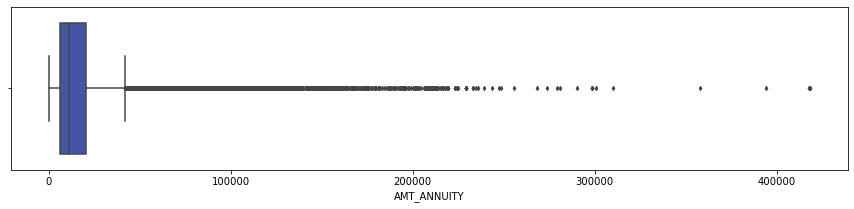

In [91]:
prev_application.AMT_ANNUITY.describe() #we have significant difference between mean and median

#looking for outliers with boxplot 
plt.figure(figsize=[15,3]) 
sns.boxplot(prev_application.AMT_ANNUITY, color=[0.2,0.3,0.7], fliersize=3)
plt.show()

# we have highly skewed data

In [92]:
prev_application.AMT_ANNUITY.fillna(prev_application.AMT_ANNUITY.median(), inplace=True)

###### AMT_GOODS_PRICE

In [93]:
prev_application.AMT_GOODS_PRICE.describe()

count   1284699.000000
mean     227847.279283
std      315396.557937
min           0.000000
25%       50841.000000
50%      112320.000000
75%      234000.000000
max     6905160.000000
Name: AMT_GOODS_PRICE, dtype: float64

<AxesSubplot:xlabel='AMT_GOODS_PRICE'>

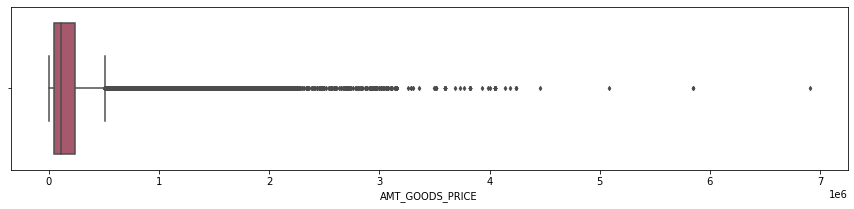

In [94]:
#looking for outliers with boxplot
plt.figure(figsize=[15,3])
sns.boxplot(prev_application.AMT_GOODS_PRICE, color=[0.7,0.3,0.4], fliersize=3)
# we have highly skewed data

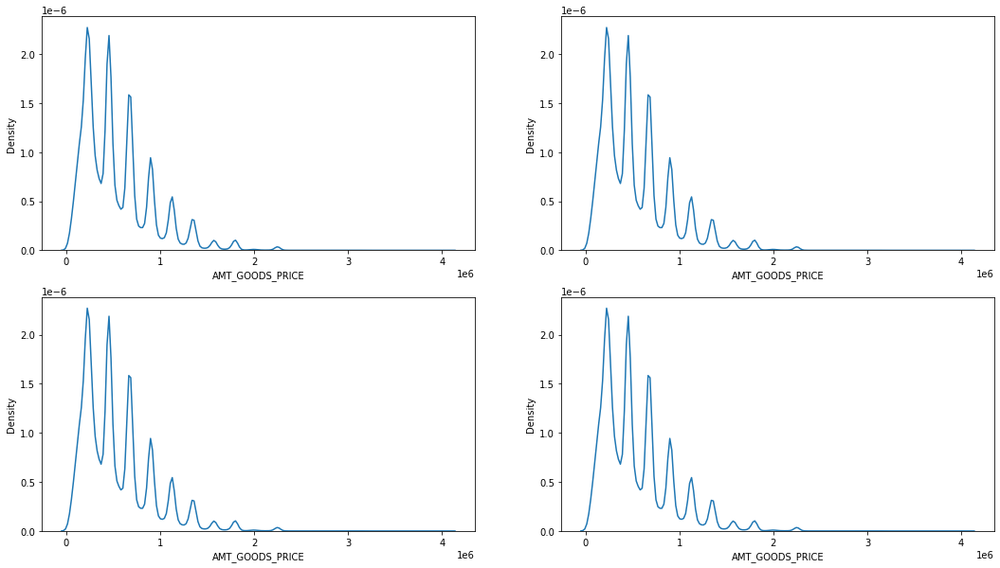

In [95]:
#looking for best imputation value between mean median and mode using kde plots
plt.figure(figsize=(18,10))
plt.subplot(221)
sns.kdeplot(application['AMT_GOODS_PRICE'])

plt.subplot(222)
sns.kdeplot(application['AMT_GOODS_PRICE'].fillna(application.AMT_GOODS_PRICE.median()))

plt.subplot(223)
sns.kdeplot(application['AMT_GOODS_PRICE'].fillna(application.AMT_GOODS_PRICE.mean()))

plt.subplot(224)
sns.kdeplot(application['AMT_GOODS_PRICE'].fillna(application.AMT_GOODS_PRICE.mode()[0]))
plt.show()

In [96]:
prev_application.AMT_GOODS_PRICE.fillna(prev_application.AMT_GOODS_PRICE.median(), inplace=True)

###### CNT_PAYMENT

In [97]:
prev_application.CNT_PAYMENT.describe()

count   1297984.000000
mean         16.054082
std          14.567288
min           0.000000
25%           6.000000
50%          12.000000
75%          24.000000
max          84.000000
Name: CNT_PAYMENT, dtype: float64

<AxesSubplot:xlabel='CNT_PAYMENT'>

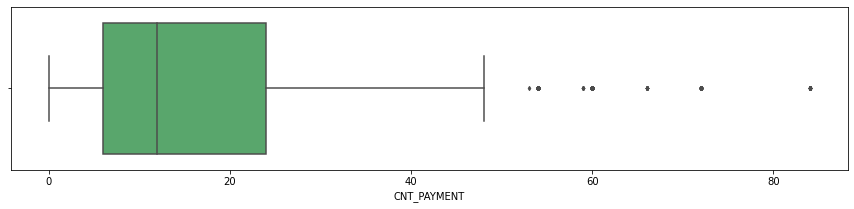

In [98]:
#looking for outliers with boxplot
plt.figure(figsize=[15,3])
sns.boxplot(prev_application.CNT_PAYMENT, color=[0.3,0.7,0.4], fliersize=3)
# we have very less skewed data

###### As we dont have continuos values in CNT_PAYMENT we cannot plot the kdeplots for each immputation method

As CNT_PAYMENT tells us the term of loan the null values may correspod to the term being 0 i.e. loan not being started or being cancelled/rejected
Checking this with NAME_CONTRACT_STATUS column

* so imputing the missing values in CNT_PAYMENT with 0 as the term not starting corresponds to 0 value

In [99]:
prev_application.CNT_PAYMENT.fillna(0, inplace=True)

###### PRODUCT_COMBINATION

In [100]:
prev_application.PRODUCT_COMBINATION.value_counts(normalize=True)*100
# from this we can see that the values counts for each category are very close to each other

Cash                             17.126503
POS household with interest      15.786996
POS mobile with interest         13.214817
Cash X-Sell: middle               8.616430
Cash X-Sell: low                  7.799898
Card Street                       6.741970
POS industry with interest        5.918612
POS household without interest    4.964943
Card X-Sell                       4.825651
Cash Street: high                 3.571480
Cash X-Sell: high                 3.551239
Cash Street: middle               2.075493
Cash Street: low                  2.026148
POS mobile without interest       1.442150
POS other with interest           1.429993
POS industry without interest     0.754670
POS others without interest       0.153006
Name: PRODUCT_COMBINATION, dtype: float64

###### As the modal value and is not significantly large than other values we can drop the rows having null values in column PRODUCT_CATEGORY as it is only 0.02% of the total data

In [101]:
prev_application = prev_application[-(prev_application.PRODUCT_COMBINATION.isnull())]

###### AMT_CREDIT

In [102]:
prev_application = prev_application[-(prev_application.AMT_CREDIT.isnull())]

### Data Quality check - Analysing missing values, improper dtypes

In [103]:
prev_application.isnull().sum()    # checking for missing values again

SK_ID_PREV                     0
SK_ID_CURR                     0
NAME_CONTRACT_TYPE             0
AMT_ANNUITY                    0
AMT_APPLICATION                0
AMT_CREDIT                     0
AMT_GOODS_PRICE                0
WEEKDAY_APPR_PROCESS_START     0
HOUR_APPR_PROCESS_START        0
FLAG_LAST_APPL_PER_CONTRACT    0
NFLAG_LAST_APPL_IN_DAY         0
NAME_CASH_LOAN_PURPOSE         0
NAME_CONTRACT_STATUS           0
DAYS_DECISION                  0
NAME_PAYMENT_TYPE              0
CODE_REJECT_REASON             0
NAME_CLIENT_TYPE               0
NAME_GOODS_CATEGORY            0
NAME_PORTFOLIO                 0
NAME_PRODUCT_TYPE              0
CHANNEL_TYPE                   0
SELLERPLACE_AREA               0
NAME_SELLER_INDUSTRY           0
CNT_PAYMENT                    0
NAME_YIELD_GROUP               0
PRODUCT_COMBINATION            0
dtype: int64

In [104]:
prev_application.isnull().sum()/len(prev_application)*100

SK_ID_PREV                    0.000000
SK_ID_CURR                    0.000000
NAME_CONTRACT_TYPE            0.000000
AMT_ANNUITY                   0.000000
AMT_APPLICATION               0.000000
AMT_CREDIT                    0.000000
AMT_GOODS_PRICE               0.000000
WEEKDAY_APPR_PROCESS_START    0.000000
HOUR_APPR_PROCESS_START       0.000000
FLAG_LAST_APPL_PER_CONTRACT   0.000000
NFLAG_LAST_APPL_IN_DAY        0.000000
NAME_CASH_LOAN_PURPOSE        0.000000
NAME_CONTRACT_STATUS          0.000000
DAYS_DECISION                 0.000000
NAME_PAYMENT_TYPE             0.000000
CODE_REJECT_REASON            0.000000
NAME_CLIENT_TYPE              0.000000
NAME_GOODS_CATEGORY           0.000000
NAME_PORTFOLIO                0.000000
NAME_PRODUCT_TYPE             0.000000
CHANNEL_TYPE                  0.000000
SELLERPLACE_AREA              0.000000
NAME_SELLER_INDUSTRY          0.000000
CNT_PAYMENT                   0.000000
NAME_YIELD_GROUP              0.000000
PRODUCT_COMBINATION      

In [105]:
prev_application.dtypes   # checking for improper data types

SK_ID_PREV                       int64
SK_ID_CURR                       int64
NAME_CONTRACT_TYPE              object
AMT_ANNUITY                    float64
AMT_APPLICATION                float64
AMT_CREDIT                     float64
AMT_GOODS_PRICE                float64
WEEKDAY_APPR_PROCESS_START      object
HOUR_APPR_PROCESS_START          int64
FLAG_LAST_APPL_PER_CONTRACT     object
NFLAG_LAST_APPL_IN_DAY           int64
NAME_CASH_LOAN_PURPOSE          object
NAME_CONTRACT_STATUS            object
DAYS_DECISION                    int64
NAME_PAYMENT_TYPE               object
CODE_REJECT_REASON              object
NAME_CLIENT_TYPE                object
NAME_GOODS_CATEGORY             object
NAME_PORTFOLIO                  object
NAME_PRODUCT_TYPE               object
CHANNEL_TYPE                    object
SELLERPLACE_AREA                 int64
NAME_SELLER_INDUSTRY            object
CNT_PAYMENT                    float64
NAME_YIELD_GROUP                object
PRODUCT_COMBINATION      

In [106]:
prev_application.NAME_CASH_LOAN_PURPOSE.value_counts()

XAP                                 922314
XNA                                 677918
Repairs                              23765
Other                                15608
Urgent needs                          8412
Buying a used car                     2888
Building a house or an annex          2693
Everyday expenses                     2416
Medicine                              2174
Payments on other loans               1931
Education                             1573
Journey                               1239
Purchase of electronic equipment      1061
Buying a new car                      1012
Wedding / gift / holiday               962
Buying a home                          865
Car repairs                            797
Furniture                              749
Buying a holiday home / land           533
Business development                   426
Gasification / water supply            300
Buying a garage                        136
Hobby                                   55
Money for a

In [107]:
prev_application.NAME_CLIENT_TYPE.value_counts(normalize=True)

Repeater    0.737160
New         0.180459
Refreshed   0.081219
XNA         0.001162
Name: NAME_CLIENT_TYPE, dtype: float64

In [108]:
prev_application.NAME_GOODS_CATEGORY.value_counts()

XNA                         950462
Mobile                      224708
Consumer Electronics        121576
Computers                   105769
Audio/Video                  99441
Furniture                    53656
Photo / Cinema Equipment     25021
Construction Materials       24995
Clothing and Accessories     23554
Auto Accessories              7381
Jewelry                       6290
Homewares                     5023
Medical Supplies              3843
Vehicles                      3370
Sport and Leisure             2981
Gardening                     2668
Other                         2554
Office Appliances             2333
Tourism                       1659
Medicine                      1550
Direct Sales                   446
Fitness                        209
Additional Service             128
Education                      107
Weapon                          77
Insurance                       64
Animals                          1
House Construction               1
Name: NAME_GOODS_CAT

We have one unidentified value i.e. XNA in NAME_GOODS_CATEGORY but as the value count of this value is very huge so keeping it as it is instead of changing it

In [109]:
prev_application.NAME_PAYMENT_TYPE.value_counts()

Cash through the bank                        1033552
XNA                                           627037
Non-cash from your account                      8193
Cashless from the account of the employer       1085
Name: NAME_PAYMENT_TYPE, dtype: int64

In [110]:
prev_application.NAME_YIELD_GROUP.value_counts()

XNA           516868
middle        385532
high          353331
low_normal    322095
low_action     92041
Name: NAME_YIELD_GROUP, dtype: int64

# Insight
<hr>

* We have many non-numeric columns with null values as XNA or XAP but due to their high number of presence in data set we are going to keep it as it is.<br>
* Because changing them to NaN will create problem for analysis and we cant delete these columns as they are very crucial for analysis.

In [111]:
prev_application[(prev_application.SELLERPLACE_AREA<0)].sample(10)

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION
587655,1376338,397345,Cash loans,11250.000000,0.000000,0.000000,112320.000000,THURSDAY,12,Y,1,XNA,Canceled,-440,XNA,XAP,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,0.000000,XNA,Cash
1123051,2025878,183738,Cash loans,22021.470000,315000.000000,340573.500000,315000.000000,MONDAY,11,Y,1,XNA,Canceled,-218,XNA,XAP,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,18.000000,low_action,Cash X-Sell: low
227881,1907464,330459,Cash loans,11250.000000,0.000000,0.000000,112320.000000,TUESDAY,16,Y,1,XNA,Canceled,-150,XNA,XAP,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,0.000000,XNA,Cash
720948,2400049,418195,Cash loans,11250.000000,0.000000,0.000000,112320.000000,MONDAY,7,Y,1,XNA,Refused,-227,XNA,HC,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,0.000000,XNA,Cash
860575,1576137,403178,Cash loans,11250.000000,0.000000,0.000000,112320.000000,TUESDAY,11,Y,1,XNA,Canceled,-160,XNA,XAP,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,0.000000,XNA,Cash
1457280,1545046,440286,Cash loans,11250.000000,0.000000,0.000000,112320.000000,TUESDAY,9,Y,1,XNA,Canceled,-213,XNA,XAP,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,0.000000,XNA,Cash
1425644,2697772,354140,Cash loans,23708.250000,405000.000000,461133.000000,405000.000000,FRIDAY,10,Y,1,XNA,Approved,-949,Cash through the bank,XAP,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,36.000000,middle,Cash X-Sell: middle
574795,2280259,323277,Cash loans,19066.500000,450000.000000,450000.000000,450000.000000,FRIDAY,14,Y,1,XNA,Approved,-218,XNA,XAP,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.000000,low_normal,Cash X-Sell: low
1338723,2272500,318758,Cash loans,20979.000000,450000.000000,450000.000000,450000.000000,MONDAY,8,Y,1,XNA,Approved,-162,Cash through the bank,XAP,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,48.000000,middle,Cash X-Sell: middle
587327,2429882,409481,Cash loans,11250.000000,0.000000,0.000000,112320.000000,WEDNESDAY,6,Y,1,XNA,Canceled,-76,XNA,XAP,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,0.000000,XNA,Cash


In [112]:
prev_application[(prev_application.SELLERPLACE_AREA<0)].SELLERPLACE_AREA.value_counts()

-1    762672
Name: SELLERPLACE_AREA, dtype: int64

# Insight
<hr>

* The SELLERPLACE_AREA has many values < 0, but all of them are -1.<br>
<t>So we can conclude that here -1 corresponds to unavailable data but imputing it will heavily manipulate data so not changing the -ve values

In [113]:
(prev_application.DAYS_DECISION<0).sum()

1669867

In [114]:
prev_application.DAYS_DECISION = prev_application.DAYS_DECISION.apply(lambda x: abs(x))

In [115]:
(prev_application.DAYS_DECISION<0).sum()

0

### Changing improper data types

In [116]:
prev_application.NFLAG_LAST_APPL_IN_DAY.value_counts()

1    1663967
0       5900
Name: NFLAG_LAST_APPL_IN_DAY, dtype: int64

###### We can see that it is actually a categorical variable so changing it to a categorical variable

In [117]:
prev_application.NFLAG_LAST_APPL_IN_DAY = prev_application.NFLAG_LAST_APPL_IN_DAY.astype('category')

In [118]:
prev_application.NFLAG_LAST_APPL_IN_DAY.dtype # checking the dtype for confirmationbb

CategoricalDtype(categories=[0, 1], ordered=False)

In [119]:
prev_application.shape

(1669867, 26)

In [120]:
prev_application.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1669867 entries, 0 to 1670213
Data columns (total 26 columns):
 #   Column                       Non-Null Count    Dtype   
---  ------                       --------------    -----   
 0   SK_ID_PREV                   1669867 non-null  int64   
 1   SK_ID_CURR                   1669867 non-null  int64   
 2   NAME_CONTRACT_TYPE           1669867 non-null  object  
 3   AMT_ANNUITY                  1669867 non-null  float64 
 4   AMT_APPLICATION              1669867 non-null  float64 
 5   AMT_CREDIT                   1669867 non-null  float64 
 6   AMT_GOODS_PRICE              1669867 non-null  float64 
 7   WEEKDAY_APPR_PROCESS_START   1669867 non-null  object  
 8   HOUR_APPR_PROCESS_START      1669867 non-null  int64   
 9   FLAG_LAST_APPL_PER_CONTRACT  1669867 non-null  object  
 10  NFLAG_LAST_APPL_IN_DAY       1669867 non-null  category
 11  NAME_CASH_LOAN_PURPOSE       1669867 non-null  object  
 12  NAME_CONTRACT_STATUS        

In [121]:
prev_application.isnull().sum()/len(prev_application)*100

SK_ID_PREV                    0.000000
SK_ID_CURR                    0.000000
NAME_CONTRACT_TYPE            0.000000
AMT_ANNUITY                   0.000000
AMT_APPLICATION               0.000000
AMT_CREDIT                    0.000000
AMT_GOODS_PRICE               0.000000
WEEKDAY_APPR_PROCESS_START    0.000000
HOUR_APPR_PROCESS_START       0.000000
FLAG_LAST_APPL_PER_CONTRACT   0.000000
NFLAG_LAST_APPL_IN_DAY        0.000000
NAME_CASH_LOAN_PURPOSE        0.000000
NAME_CONTRACT_STATUS          0.000000
DAYS_DECISION                 0.000000
NAME_PAYMENT_TYPE             0.000000
CODE_REJECT_REASON            0.000000
NAME_CLIENT_TYPE              0.000000
NAME_GOODS_CATEGORY           0.000000
NAME_PORTFOLIO                0.000000
NAME_PRODUCT_TYPE             0.000000
CHANNEL_TYPE                  0.000000
SELLERPLACE_AREA              0.000000
NAME_SELLER_INDUSTRY          0.000000
CNT_PAYMENT                   0.000000
NAME_YIELD_GROUP              0.000000
PRODUCT_COMBINATION      

## Binning
<hr>

### application dataset<br>

age<br>
income<br>
days_employed<br>
amt_credit
<hr>

### prev_application dataset<br>

Days descision

###### AGE

In [122]:
application['AGE'] = pd.cut(application.DAYS_BIRTH.apply(lambda x: x//365), bins=[0,30,40,50,60,1000], labels=['0-30','30,40','40-50','50-60','Above 60'])   

In [123]:
application.AGE.value_counts()

30,40       83117
40-50       74401
50-60       67819
0-30        52806
Above 60    29368
Name: AGE, dtype: int64

###### Income

In [124]:
(application.AMT_INCOME_TOTAL//1000).head()

0   202.000000
1   270.000000
2    67.000000
3   135.000000
4   121.000000
Name: AMT_INCOME_TOTAL, dtype: float64

In [125]:
pd.cut(application.AMT_INCOME_TOTAL//1000, bins=[0,100,200,300,400,500,600,700,800,900,1000,10000000], labels=['0-100k','100k-200k','200k-300k','300k-400k','400k-500k','500k-600k','600k-700k','700k-800k','800k-900k','900k-1M','Above 1M']).value_counts()    

100k-200k    155883
200k-300k     65159
0-100k        63735
300k-400k     14720
400k-500k      5312
500k-600k      1095
600k-700k       869
800k-900k       299
Above 1M        250
700k-800k       162
900k-1M          27
Name: AMT_INCOME_TOTAL, dtype: int64

In [126]:
application['INCOME_RANGE'] = pd.cut(application.AMT_INCOME_TOTAL//1000, bins=[0,100,200,300,400,500,600,700,800,900,1000,10000000], labels=['0-100k','100k-200k','200k-300k','300k-400k','400k-500k','500k-600k','600k-700k','700k-800k','800k-900k','900k-1M','Above 1M'])

In [127]:
application.INCOME_RANGE.value_counts()

100k-200k    155883
200k-300k     65159
0-100k        63735
300k-400k     14720
400k-500k      5312
500k-600k      1095
600k-700k       869
800k-900k       299
Above 1M        250
700k-800k       162
900k-1M          27
Name: INCOME_RANGE, dtype: int64

###### Employed

In [128]:
(application.DAYS_EMPLOYED//365).value_counts()

1000    55374
1       31841
2       29648
0       27904
3       25107
4       21767
5       16271
6       15051
7       13148
8       11440
9        8980
10       7364
11       5902
12       5309
14       4643
13       4349
15       2725
16       2335
17       2006
18       1918
19       1871
20       1600
21       1461
22       1253
23       1016
24        914
25        821
27        656
26        653
28        611
29        567
30        457
31        437
34        364
32        351
33        331
35        257
36        196
37        138
39        125
38        116
41         59
40         59
42         42
44         31
43         19
45         14
46          4
48          4
47          1
49          1
Name: DAYS_EMPLOYED, dtype: int64

In [129]:
application[application.DAYS_EMPLOYED//365==0].NAME_INCOME_TYPE.value_counts()

Working                 17423
Commercial associate     9144
State servant            1334
Student                     3
Name: NAME_INCOME_TYPE, dtype: int64

In [130]:
application[application.DAYS_EMPLOYED//365==1000].NAME_INCOME_TYPE.value_counts()

Pensioner     55352
Unemployed       22
Name: NAME_INCOME_TYPE, dtype: int64

# Insight
<hr>
We found that people who were unemployed or retired had DAYS_EMPLOYED entries calculating to above 1000 years <br>


In [131]:
application['YEARS_EMPLOYED'] = pd.cut(application.DAYS_EMPLOYED//365, bins=[0,5,10,20,30,40,100,100000],labels=['0-5','5-10','10-20','20-30','30-40','Above 40','Pensioner'])

In [132]:
application.YEARS_EMPLOYED.value_counts()

0-5          124634
5-10          55983
Pensioner     55374
10-20         32658
20-30          8409
30-40          2374
Above 40        175
Name: YEARS_EMPLOYED, dtype: int64

# Insight
<hr>
We found that people who were unemployed or retired had DAYS_EMPLOYED entries calculating to above 1000 years <br>


###### AMT_CREDIT

In [133]:
(application.AMT_CREDIT//1000).sample(5)

188487   485.000000
59697    835.000000
28173    479.000000
229496   157.000000
15540    900.000000
Name: AMT_CREDIT, dtype: float64

In [134]:
application.AMT_CREDIT.max()//1000

4050.0

In [135]:
application['AMT_CREDIT_RANGE'] = pd.cut(application.AMT_CREDIT//1000, bins=[0,100,200,300,400,500,600,700,800,900,1000,10000], labels=['0-100k','100k-200k','200k-300k','300k-400k','400k-500k','500k-600k','600k-700k','700k-800k','800k-900k','900k-1M','Above 1M'])    

In [136]:
application.AMT_CREDIT_RANGE.value_counts()

200k-300k    54827
Above 1M     49972
500k-600k    33627
400k-500k    32560
100k-200k    30079
300k-400k    26411
600k-700k    24381
800k-900k    21828
700k-800k    18879
900k-1M       8875
0-100k        6072
Name: AMT_CREDIT_RANGE, dtype: int64

# Handling Outliers

### application dataset

###### Creating a dictionary with column names as key and their entries as values

In [137]:
dict_for_plot = {'AMT_ANNUITY':application.AMT_ANNUITY, 'AMT_CREDIT':application.AMT_CREDIT, 'AMT_GOODS_PRICE':application.AMT_GOODS_PRICE, 'AMT_INCOME_TOTAL':application.AMT_INCOME_TOTAL, 'CNT_CHILDREN':application.CNT_CHILDREN, 'CNT_FAM_MEMBERS':application.CNT_FAM_MEMBERS, 'DAYS_ID_PUBLISH':application.DAYS_ID_PUBLISH, 'DAYS_REGISTRATION':application.DAYS_REGISTRATION  }     

###### Ploting Whisker plots for numerica variables to find otliers

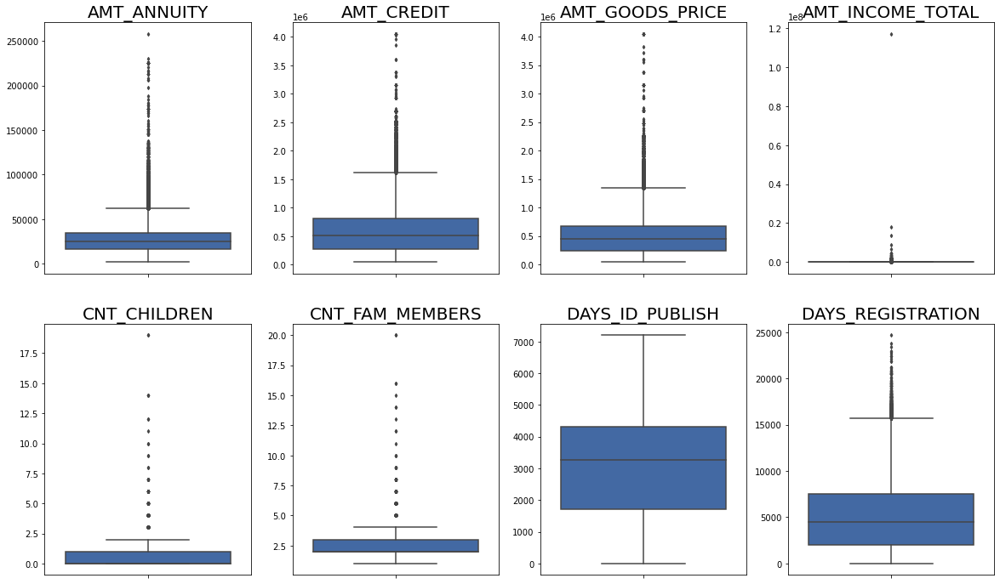

In [138]:
plt.figure(figsize=[20,25], facecolor='white')
for i,j in zip(range(1,len(dict_for_plot)+1),dict_for_plot):
    plt.subplot(4,4,i)
    sns.boxplot(y = application[j], orient='v', fliersize=3, color=[0.2,0.4,0.7])
    plt.title(j, fontdict={'fontsize':20, 'color':'black'})
    plt.ylabel(None)

# Insight
<hr>

* All colums have outliers except DAYS_ID_PUBLISH
* The outliers in AMT_ANNUITY, AMT_CREDIT and AMT_GOODS_PRICE columns are very closely packed and
continuous until a point and then spread out to extreme values
* CNT_CHILDREN and CNT_FAM_MEMBERS have dicrete outliers but are significantly large

### Handling Above outliers

*  Deleting the most extreme outliers in DAYS_REGISTRATION, AMT_ANNUITY, AMT_CREDIT, AMT_INCOME_TOTAL and AMT_GOODS_PRICE<br>
* Reducing remaining outliers if possible<br>
* We Have created categorical columns with different ranges as bins so we can keep the closely packed outliers in AMT_INCOME_TOTAL and AMT_CREDIT

###### AMT_ANNUITY

* Creating a categorical column for AMT_ANNUITY and then deleting extreme values greater than 130,000

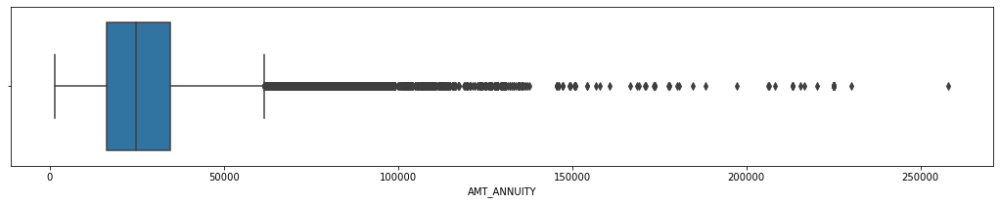

In [139]:
plt.figure(figsize=[18,3])
sns.boxplot(application.AMT_ANNUITY)
plt.show()

In [140]:
application['AMT_ANNUITY_RANGE'] = pd.cut(application.AMT_ANNUITY//1000, bins=[0,20,40,60,80,100,120,1000], labels=['0-20k','20k-40k','40k-60k','60k-80k','80k-100k','100k-120k','Above 120k'])

In [141]:
application.AMT_ANNUITY_RANGE.value_counts()

20k-40k       146747
0-20k         115062
40k-60k        37953
60k-80k         6297
80k-100k         956
100k-120k        308
Above 120k       188
Name: AMT_ANNUITY_RANGE, dtype: int64

In [142]:
val_to_remove = (application.AMT_ANNUITY.sort_values(ascending=False).iloc[:81]).values.tolist()

In [143]:
application = application[-(application.AMT_ANNUITY.isin(val_to_remove))]

###### AMT_GOODS_PRICE

* Creating a categorical column for AMT_GOODS_PRICE and then deleting extreme values greater than 2,260,000

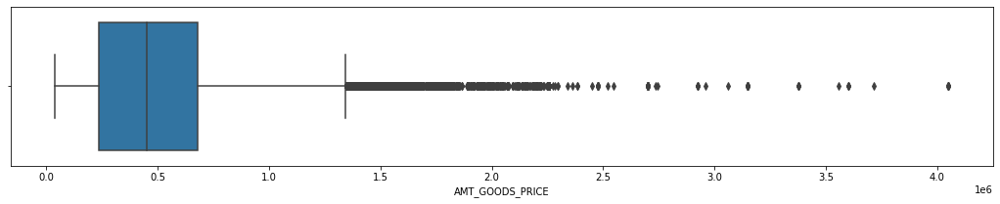

In [144]:
plt.figure(figsize=[18,3])
sns.boxplot(application.AMT_GOODS_PRICE)
plt.show()

In [145]:
application['AMT_GOODS_PRICE_RANGE'] = pd.cut(application.AMT_GOODS_PRICE/100000,bins=(0,4,8,12,16,20,100), labels=['0-4L','4L-8L','8L-12L','12L-26L','16L-20L','Above 20L'])

In [146]:
application.AMT_GOODS_PRICE_RANGE.value_counts()

0-4L         125645
4L-8L        118502
8L-12L        45762
12L-26L       13192
16L-20L        3286
Above 20L      1043
Name: AMT_GOODS_PRICE_RANGE, dtype: int64

In [147]:
val_to_remove = (application.AMT_GOODS_PRICE.sort_values(ascending=False).iloc[:68]).values.tolist()

In [148]:
application = application[-(application.AMT_GOODS_PRICE.isin(val_to_remove))]

###### AMT_INCOME_TOTAL and AMT_CREDIT

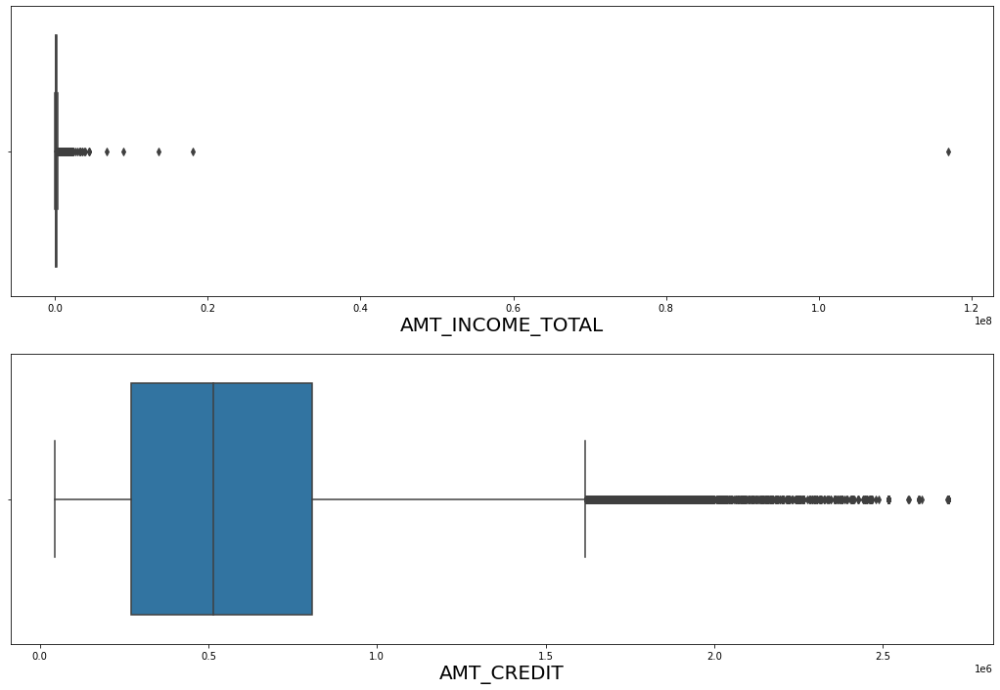

In [149]:
plt.figure(figsize=[18,12])
plt.subplot(211)
sns.boxplot(application.AMT_INCOME_TOTAL)
plt.xlabel('AMT_INCOME_TOTAL', fontdict={'fontsize':20})

plt.subplot(212)
sns.boxplot(application.AMT_CREDIT)
plt.xlabel('AMT_CREDIT', fontdict={'fontsize':20})

plt.show()

AMT_INCOME_TOTAL - deleting extreme values greater than 1,400,000<br>
AMT_CREDIT - deleting extreme values greater than 2,600,400

In [150]:
val_to_remove = application.AMT_INCOME_TOTAL.sort_values(ascending=False).iloc[:78].values.tolist()

application = application[-(application.AMT_INCOME_TOTAL.isin(val_to_remove))]

In [151]:
val_to_remove = application.AMT_CREDIT.sort_values(ascending=False).iloc[:72].values.tolist()

application = application[-(application.AMT_CREDIT.isin(val_to_remove))]

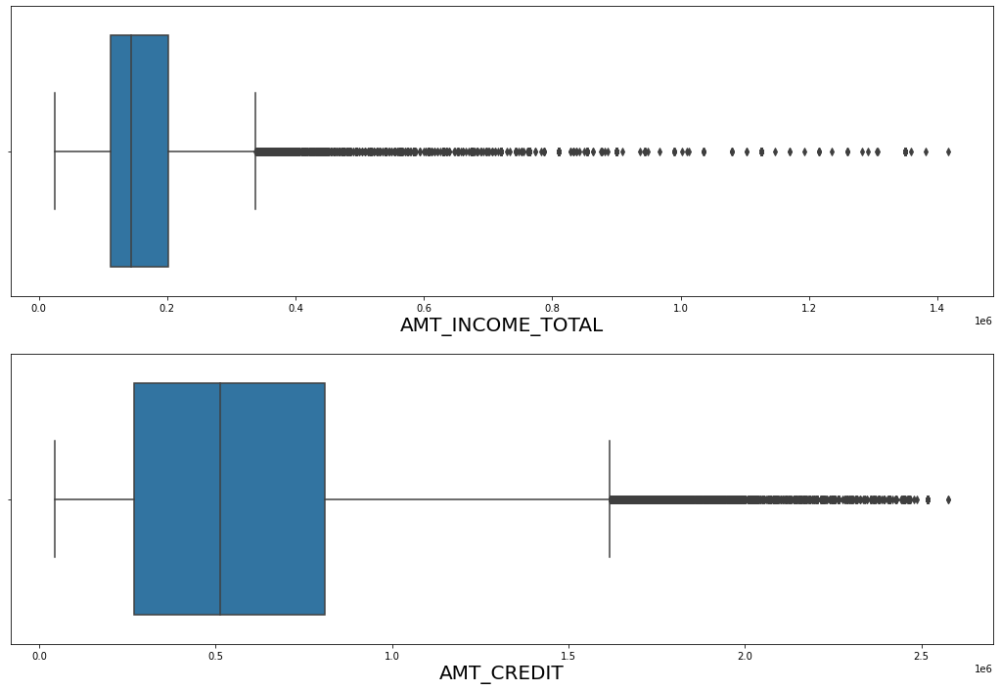

In [152]:
# plloting the graph again to see the outlier distribution aggain
plt.figure(figsize=[18,12])
plt.subplot(211)
sns.boxplot(application.AMT_INCOME_TOTAL)
plt.xlabel('AMT_INCOME_TOTAL', fontdict={'fontsize':20})

plt.subplot(212)
sns.boxplot(application.AMT_CREDIT)
plt.xlabel('AMT_CREDIT', fontdict={'fontsize':20})

plt.show()

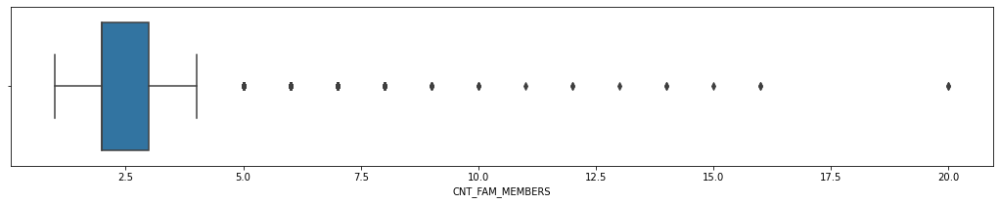

In [153]:
plt.figure(figsize=[18,3])
sns.boxplot(application.CNT_FAM_MEMBERS)
plt.show()

In [154]:
application.CNT_FAM_MEMBERS.value_counts()

2     158198
1      67807
3      52536
4      24670
5       3473
6        407
7         81
8         20
9          6
10         3
12         2
14         2
16         2
20         2
11         1
13         1
15         1
Name: CNT_FAM_MEMBERS, dtype: int64

In [155]:
application[(application.CNT_FAM_MEMBERS>8)] #checking all columns for applicants having family members more than 8

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE,INCOME_RANGE,YEARS_EMPLOYED,AMT_CREDIT_RANGE,AMT_ANNUITY_RANGE,AMT_GOODS_PRICE_RANGE
3079,103596,0,Cash loans,M,N,Y,7,85500.000000,411813.000000,17577.000000,355500.000000,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,0.007120,17676,1065,2527,1206,1,1,0,1,0,0,Cleaning staff,9,2,2,FRIDAY,9,0,0,0,0,0,0,Housing,2.000000,0.000000,2.000000,0.000000,66.000000,1,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,40-50,0-100k,0-5,400k-500k,0-20k,0-4L
12615,114709,0,Cash loans,M,Y,N,8,112500.000000,755190.000000,29947.500000,675000.000000,Unaccompanied,State servant,Higher education,Married,Municipal apartment,0.006207,15197,6252,5009,5004,1,1,1,1,0,0,Core staff,10,2,2,WEDNESDAY,11,0,0,0,1,1,0,School,0.000000,0.000000,0.000000,0.000000,1049.000000,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,40-50,100k-200k,10-20,700k-800k,20k-40k,4L-8L
23881,127782,1,Cash loans,F,N,N,9,180000.000000,640080.000000,31131.000000,450000.000000,Unaccompanied,Commercial associate,Higher education,Single / not married,Municipal apartment,0.006629,10929,1042,950,3447,1,1,1,1,0,0,Sales staff,10,2,2,THURSDAY,14,0,0,0,0,0,0,Self-employed,3.000000,1.000000,3.000000,1.000000,365.000000,1,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0-30,100k-200k,0-5,600k-700k,20k-40k,4L-8L
26195,130468,0,Cash loans,F,Y,Y,7,180000.000000,1288350.000000,41692.500000,1125000.000000,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.020246,15022,95,194,1823,1,1,0,1,0,0,Sales staff,9,3,3,THURSDAY,7,0,0,0,0,0,0,Industry: type 4,6.000000,0.000000,6.000000,0.000000,1760.000000,1,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,40-50,100k-200k,NaN,Above 1M,40k-60k,8L-12L
34545,140032,1,Cash loans,M,Y,N,11,315000.000000,1007761.500000,38515.500000,927000.000000,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.010643,17308,198,3940,844,1,1,0,1,0,0,Managers,13,2,2,FRIDAY,17,0,0,0,0,1,1,Other,0.000000,0.000000,0.000000,0.000000,3.000000,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,40-50,300k-400k,NaN,Above 1M,20k-40k,8L-12L
80948,193853,0,Cash loans,F,N,Y,12,337500.000000,746280.000000,59094.000000,675000.000000,Family,Commercial associate,Secondary / secondary special,Married,House / apartment,0.046220,14093,2710,2066,3908,1,1,0,1,0,0,Core staff,14,1,1,FRIDAY,13,0,0,0,0,0,0,Kindergarten,3.000000,2.000000,3.000000,1.000000,357.000000,0,0.000000,0.000000,0.000000,1.000000,0.000000,3.000000,"30,40",300k-400k,5-10,700k-800k,40k-60k,4L-8L
116428,235015,0,Cash loans,M,N,Y,7,117000.000000,574785.000000,34861.500000,436500.000000,Unaccompanied,Commercial associate,Secondary / secondary special,Civil marriage,House / apartment,0.018029,12492,250,6059,2982,1,1,1,1,0,0,Security staff,9,3,3,TUESDAY,9,0,0,0,0,0,0,Government,0.000000,0.000000,0.000000,0.000000,253.000000,1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,"30,40",100k-200k,NaN,500k-600k,20k-40k,4L-8L
132

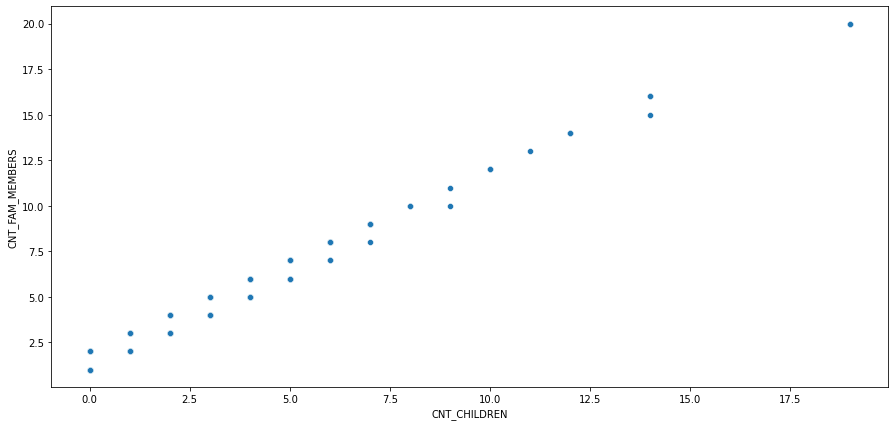

In [156]:
plt.figure(figsize=[15,7])
sns.scatterplot(application.CNT_CHILDREN,application.CNT_FAM_MEMBERS)
plt.show()

# Insight
<hr>

* For CNT_FAM_MEMBERS column having values above 8 we see that the no. of children are one or two less than the value in corresponding CNT_FAM_MEMBERS column and both these variables have high positive correlation<br><br>
* For CNT_FAM_MEMBERS column we cannot impute or bin thse outliers as more number of family members may affect the applicants defaulting percentage

### prev_application

handling outliers

In [157]:
dict_for_plot_prev_application = {'AMT_ANNUITY':prev_application.AMT_ANNUITY, 'AMT_APPLICATION':prev_application.AMT_APPLICATION, 'AMT_CREDIT':prev_application.AMT_CREDIT, 'AMT_GOODS_PRICE':prev_application.AMT_GOODS_PRICE, 'SELLERPLACE_AREA':prev_application.SELLERPLACE_AREA, 'CNT_PAYMENT':prev_application.CNT_PAYMENT, 'DAYS_DECISION':prev_application.DAYS_DECISION  } 

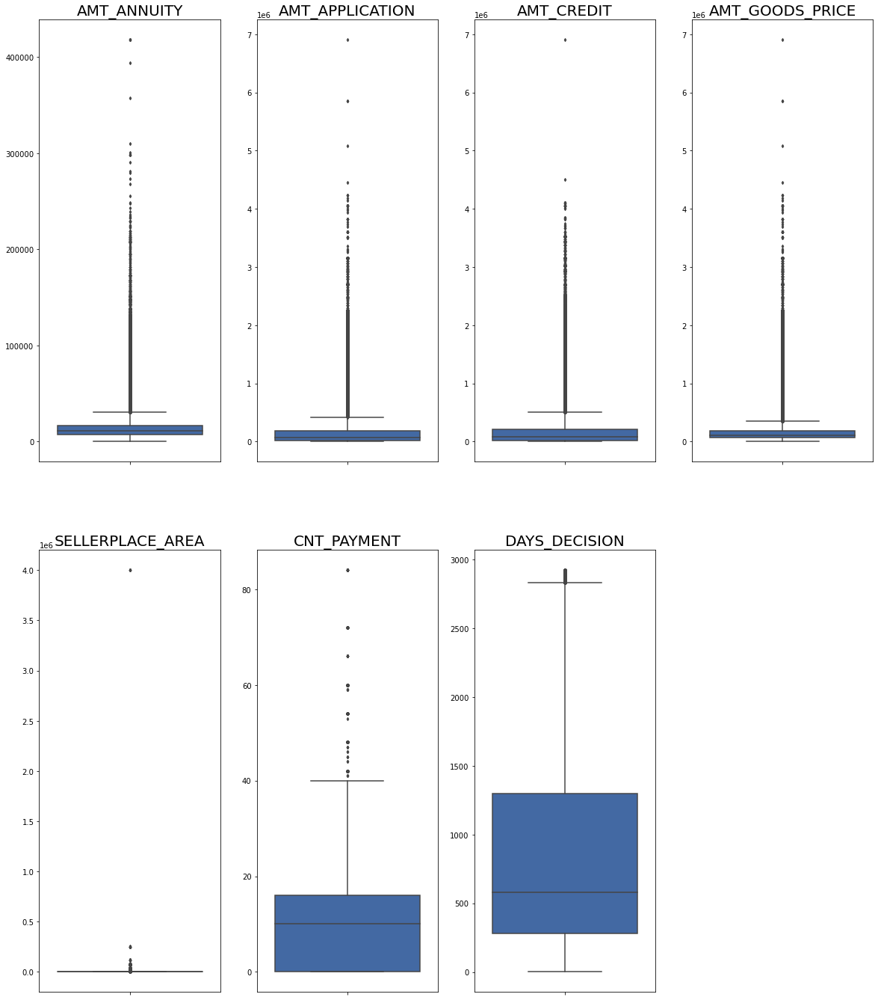

In [158]:
# plotting boxplots of numeic columns to identify outliers
plt.figure(figsize=[20,50], facecolor='white')
for i,j in zip(range(1,len(dict_for_plot_prev_application)+1),dict_for_plot_prev_application):
    plt.subplot(4,4,i)
    sns.boxplot(y = prev_application[j], orient='v', fliersize=3, color=[0.2,0.4,0.7])
    plt.title(j, fontdict={'fontsize':20, 'color':'black'})
    plt.ylabel(None)

# Insight
<hr>

* All the above numeric columns have outliers which are very large except for DAYS_DESCISION which has closely packed outliers but are very close to the upper fence<br>
* SELLERPLACE_AREA has outliers but also has an outlier which is extremely far from the upper fence<br>
* CNT_PAYMENT has very few outliers <br>
* The AMT_ANNUITY, AMT_CREDIT, AMT_APPLICATION, AMT_GOODS_PRICE, SELLERPLACE_AREA columns have huge amount of outliers which are very closely packed and then spread wide after a point to extremely large values

### Handling Above outliers

*  Deleting the most extreme outliers in SELLERPLACE_AREA, AMT_ANNUITY, AMT_CREDIT, AMT_APPLICATION and AMT_GOODS_PRICE<br>
* Reducing remaining outliers if possible<br>
* Creating new columns so to bin the values into categories

###### AMT_ANNUITY

* Creating a categorical column for AMT_ANNUITY and then deleting extreme values greater than 220,000

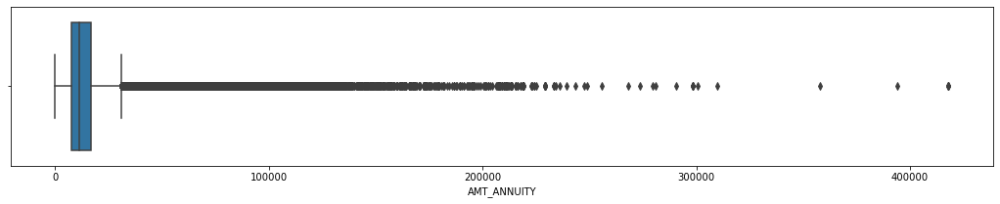

In [159]:
plt.figure(figsize=[18,3])
sns.boxplot(prev_application.AMT_ANNUITY)
plt.show()

In [160]:
prev_application['AMT_ANNUITY_RANGE'] = pd.cut(prev_application.AMT_ANNUITY//1000, bins=[0,20,40,60,80,100,120,1000], labels=['0-20k','20k-40k','40k-60k','60k-80k','80k-100k','100k-120k','Above 120k'])

In [161]:
prev_application.AMT_ANNUITY_RANGE.value_counts()

0-20k         1349834
20k-40k        230380
40k-60k         65673
60k-80k         15153
80k-100k         4301
100k-120k        1400
Above 120k       1234
Name: AMT_ANNUITY_RANGE, dtype: int64

In [162]:
val_to_remove = (prev_application.AMT_ANNUITY.sort_values(ascending=False).iloc[:40]).values.tolist()

In [163]:
prev_application = prev_application[-(prev_application.AMT_ANNUITY.isin(val_to_remove))]

###### AMT_GOODS_PRICE

* Creating a categorical column for AMT_GOODS_PRICE and then deleting extreme values greater than 3,200,000

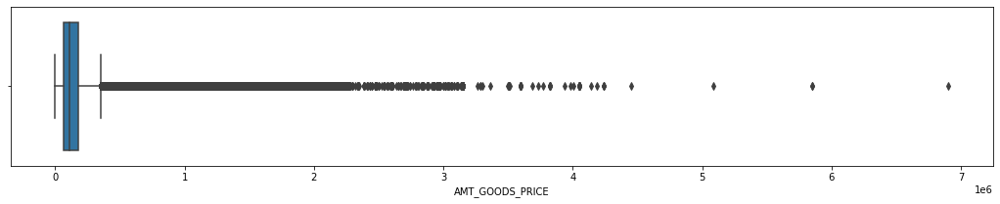

In [164]:
plt.figure(figsize=[18,3])
sns.boxplot(prev_application.AMT_GOODS_PRICE)
plt.show()

In [165]:
pd.cut(prev_application.AMT_GOODS_PRICE/100000,bins=(0,4,8,12,16,20,1000), labels=['0-4L','4L-8L','8L-12L','12L-26L','16L-20L','Above 20L']).value_counts() 

0-4L         1446578
4L-8L         133363
8L-12L         52400
12L-26L        21517
Above 20L       4691
16L-20L         4409
Name: AMT_GOODS_PRICE, dtype: int64

In [166]:
prev_application['AMT_GOODS_PRICE_RANGE'] = pd.cut(prev_application.AMT_GOODS_PRICE/100000,bins=(0,4,8,12,16,20,1000), labels=['0-4L','4L-8L','8L-12L','12L-26L','16L-20L','Above 20L'])

prev_application.AMT_GOODS_PRICE_RANGE.value_counts()

0-4L         1446578
4L-8L         133363
8L-12L         52400
12L-26L        21517
Above 20L       4691
16L-20L         4409
Name: AMT_GOODS_PRICE_RANGE, dtype: int64

In [167]:
val_to_remove = (prev_application.AMT_GOODS_PRICE.sort_values(ascending=False).iloc[:54]).values.tolist()

prev_application = prev_application[-(prev_application.AMT_GOODS_PRICE.isin(val_to_remove))]

###### AMT_APPLICATION

* Creating a categorical column for AMT_GOODS_PRICE and then deleting extreme values greater than 3,200,000

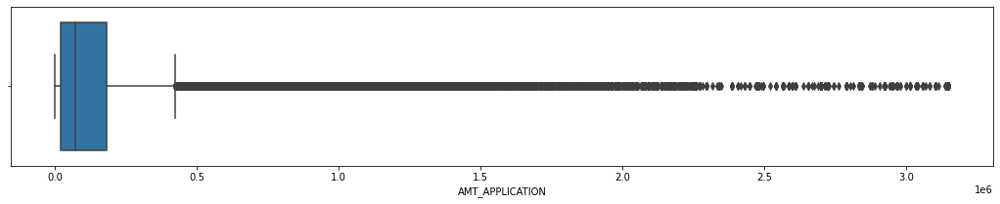

In [168]:
plt.figure(figsize=[18,3])
sns.boxplot(prev_application.AMT_APPLICATION)
plt.show()

In [169]:
val_to_remove = (prev_application.AMT_APPLICATION.sort_values(ascending=False).iloc[:54]).values.tolist()

In [170]:
prev_application = prev_application[-(prev_application.AMT_APPLICATION.isin(val_to_remove))]

###### AMT_CREDIT
* Creating a categorical column for AMT_GOODS_PRICE and then deleting extreme values greater than 3,200,000

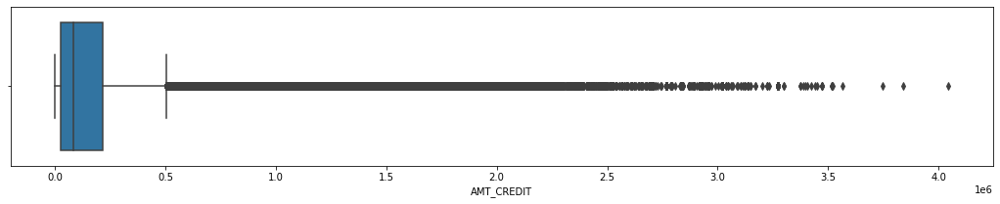

In [171]:
plt.figure(figsize=[18,3])
sns.boxplot(prev_application.AMT_CREDIT)
plt.show()

In [172]:
pd.cut(prev_application.AMT_CREDIT//1000, bins=[0,200,400,600,800,1000,1200,1400,1600,10000], labels=['0-200k','200k-400k','400k-600k','600k-800k','800k-1M','1000k-1.2M','1.2M-1.4M','1.4M-1.6M','Above 1.6M']).value_counts()

0-200k        895795
200k-400k     194859
400k-600k      99636
600k-800k      48514
800k-1M        31152
1.2M-1.4M      22098
1000k-1.2M     19894
Above 1.6M     11301
1.4M-1.6M       9711
Name: AMT_CREDIT, dtype: int64

In [173]:
prev_application['AMT_CREDIT_RANGE'] = pd.cut(prev_application.AMT_CREDIT//1000, bins=[0,200,400,600,800,1000,1200,1400,1600,10000], labels=['0-200k','200k-400k','400k-600k','600k-800k','800k-1M','1000k-1.2M','1.2M-1.4M','1.4M-1.6M','Above 1.6M'])  

In [174]:
val_to_remove = prev_application.AMT_CREDIT.sort_values(ascending=False).iloc[:72].values.tolist()

prev_application = prev_application[-(prev_application.AMT_CREDIT.isin(val_to_remove))]

#### Ploting above 4 variable to check outlier distribution again

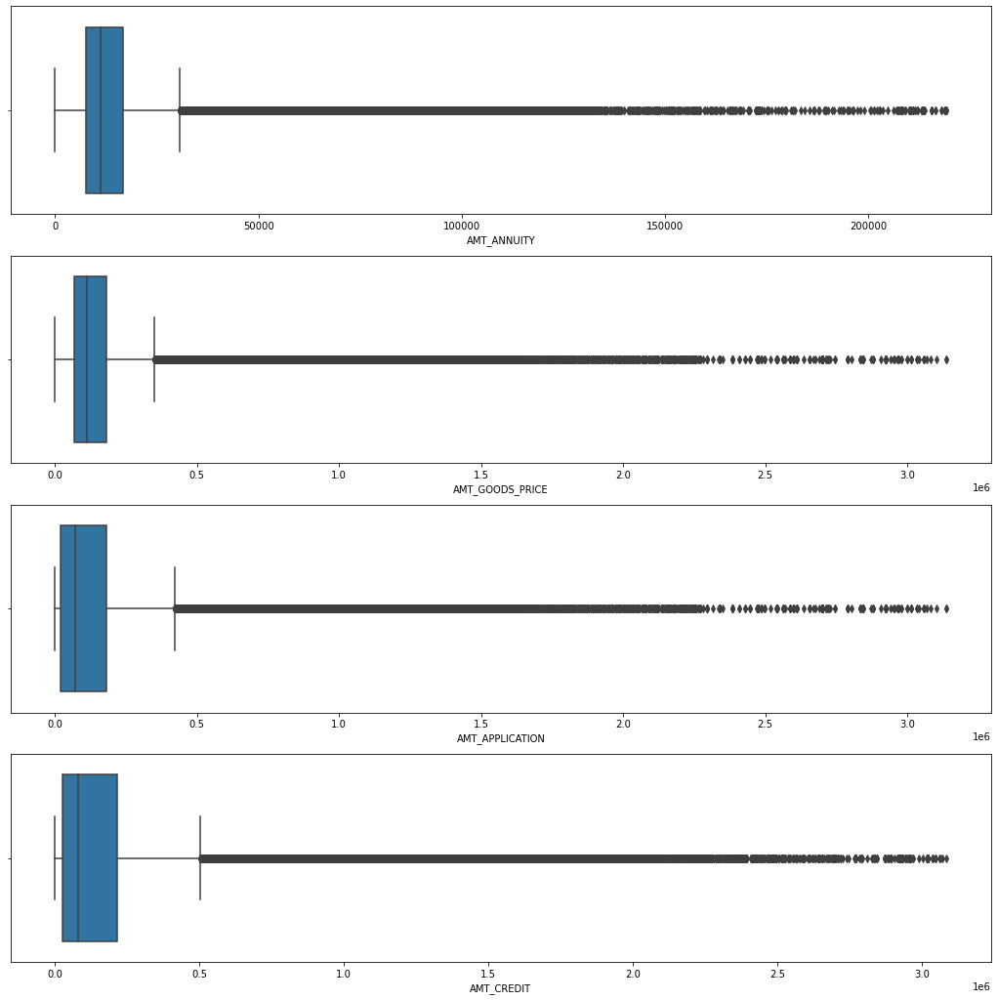

In [175]:
plt.figure(figsize=[18,18])
plt.subplot(411)
sns.boxplot(prev_application.AMT_ANNUITY)

plt.subplot(412)
sns.boxplot(prev_application.AMT_GOODS_PRICE)


plt.subplot(413)
sns.boxplot(prev_application.AMT_APPLICATION)

plt.subplot(414)
sns.boxplot(prev_application.AMT_CREDIT)

plt.show()

###### SELLERPLACE_AREA 
* Deleting extreme values 

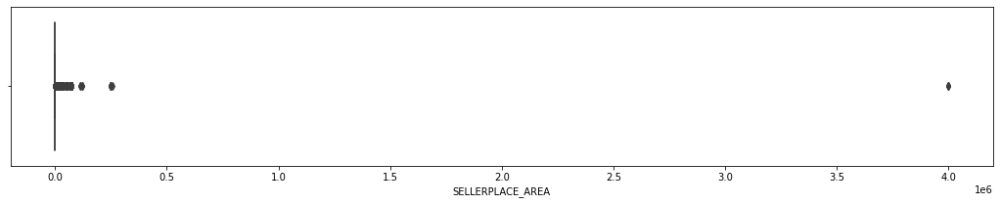

In [176]:
plt.figure(figsize=[18,3])
sns.boxplot(prev_application.SELLERPLACE_AREA)
plt.show()

In [177]:
val_to_remove = prev_application.SELLERPLACE_AREA.sort_values(ascending=False).iloc[:22]

In [178]:
prev_application = prev_application[-(prev_application.SELLERPLACE_AREA.isin(val_to_remove))]

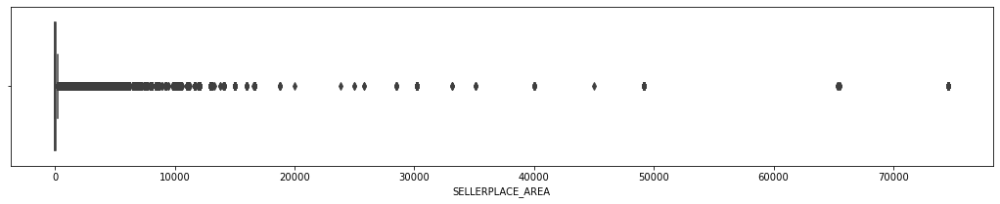

In [179]:
plt.figure(figsize=[18,3])
sns.boxplot(prev_application.SELLERPLACE_AREA)
plt.show()

In [180]:
prev_application.SELLERPLACE_AREA.sort_values(ascending=False).iloc[:1436]

1214742    74625
687089     74625
285370     74625
385759     74625
746281     74625
882107     74625
882106     74625
882105     74625
882104     74625
1121812    74625
1121811    74625
1121810    74625
285371     74625
373799     74625
746282     74625
493815     74625
882103     74625
1535091    74625
493814     74625
1535090    74625
739468     74625
746366     74625
373800     74625
373798     74625
687088     74625
1585524    74625
687087     74625
278752     74625
1588857    74625
1585525    74625
285219     74625
457210     74625
1214910    74625
1588858    74625
1588859    74625
1588860    74625
1588861    74625
285220     74625
1508124    74625
1508123    74625
1508122    74625
1508121    74625
687085     74625
493816     74625
687086     74625
1121813    74625
385761     74625
385760     74625
1226105    74625
1641367    74625
1414651    74625
1249806    74625
704501     74625
1226104    74625
704500     74625
1226103    74625
822976     74625
746369     74625
1471466    746

###### We can infer from this that above 99% of outliers are below 18,000 so deleting all values above 18,000

In [181]:
val_to_remove = prev_application.SELLERPLACE_AREA.sort_values(ascending=False).iloc[:1436]

In [182]:
prev_application = prev_application[-(prev_application.SELLERPLACE_AREA.isin(val_to_remove))]

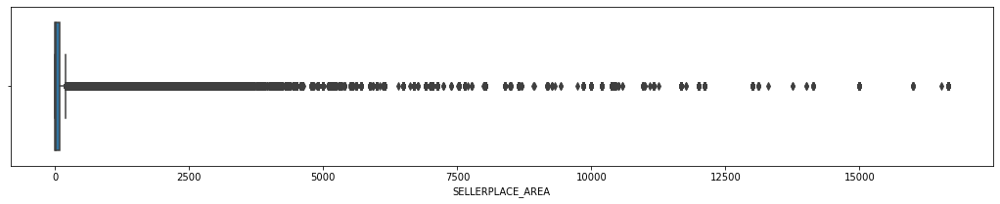

In [183]:
# ploting the graph again
plt.figure(figsize=[18,3])
sns.boxplot(prev_application.SELLERPLACE_AREA)
plt.show()

# Analysis

### application dataset

### Imbalance analysis

In [184]:
imbalance = application.TARGET.value_counts(normalize=True).reset_index()
imbalance  # creating a DataFrame containig values and the value_counts from TARGET variable in application df

,index,TARGET
0,0,0.919245
1,1,0.080755


In [185]:
#plotting bargraph to check imbalance
px.bar(imbalance, x='index',y='TARGET', color=['Non-Defaulter','Defaulter'], title='Imbalance Pecentage of TARGET variable', text=['Non-Defaulter','Defaulter'])   

# Inference
<hr>
More than 91% of the applicants have paid the loan without any late payment

#### Creating Segmented DataFrames with respect to TARGET variable

In [186]:
Non_Default = application[application.TARGET==0]   # dataframe containing all non-defaulters
Default = application[application.TARGET==1]     # dataframe containing all defaulters

In [187]:
sns.set(font_scale=1.5)  # setting the font scale

### Defining Functions For plotting

###### defining a function to annotate bar plots

In [188]:
def bar_annot(splot):
    for p in splot.patches:
        splot.annotate(format(p.get_height()),(p.get_x() + p.get_width() / 2., p.get_height()),ha='center', va='center',    
                       xytext=(0,7),textcoords='offset points')
# This will annotate each bar in a barplot with its height, i.e. its value

###### defining a function to plot segmeted bar graph wrt TARGET variable

In [189]:
def segmented_anlaysis(col):
    plt.figure(figsize=[22,24])

    # 1st subplot will plot countplot for a given variable, and segment it wrt TARGET variable
    plt.subplot(211)
    splot = sns.countplot(data=application, x=str(col), hue='TARGET', palette='cubehelix') 
    plt.title( str(col)+' (Non-Default/Default)', fontdict={'fontsize':40})
    plt.xlabel(None)
    plt.legend(labels=['Non-Defaulter', 'Defaulter'], prop={'size':25})
    bar_annot(splot)

    # 2nd plot plots count plot for a given variable where TARGET variable equals 0 (client with payment difficulty)
    plt.subplot(212)
    splot = sns.countplot(Default[col], palette='magma') 
    plt.xlabel(None)
    plt.title(str(col)+' Range Defaulter', fontdict={'fontsize':40})
    bar_annot(splot)

    plt.show()

###### defining a function for ploting distplots

In [190]:
# this function will plot a 2x2 subplot for a list of hiven variables
def distplot_function(dataset,col_names):
    for i,j in zip((1,range(len(col_names))+1),col_names):
        plt.subplot(2,2,i)
        sns.distplot(dataset[j], bins=20, kde=True, color='r')

###### defining a function for ploting categorical_countplot for prev_application dataframe

In [191]:
# This funtions plots countplot for a given variable and annotate each bar with its value
def categorical_countplot_prev(col_name,annotation=True):  # by default annotation is True
    plt.figure(figsize=[15,10])
    splot = sns.countplot(data=prev_application, x=col_name, hue='NAME_CONTRACT_STATUS', palette='Spectral') 
    plt.xlabel(None)
    plt.title(col_name, fontdict={'fontsize':25})
    if annotation==True:
        bar_annot(splot)    # if annotatiion is true then annotate the bars using bar_annot function
    else:
        None                #if annotatiion is false then return countplot without annotation

### Univariate/Bivariate/Multivariate Analysis 
#### (Segmented / Non-Segmented)

#### Plotting barplots/coutplots and pie charts for categorical variables

###### NAME_CONTRACT_TYPE

In [192]:
 # checking percentage of each unique entry using pie chart
fig = px.pie(data_frame= application.NAME_CONTRACT_TYPE.value_counts(normalize=True).reset_index(), width=500, height=400, names='index', values='NAME_CONTRACT_TYPE')   
fig.update_layout(paper_bgcolor='LightSteelBlue')  

# Insight
<hr>
Majority of Loans are Cash loans(~90%) and only a small percentage of values are of Revolving loans(~10%) 

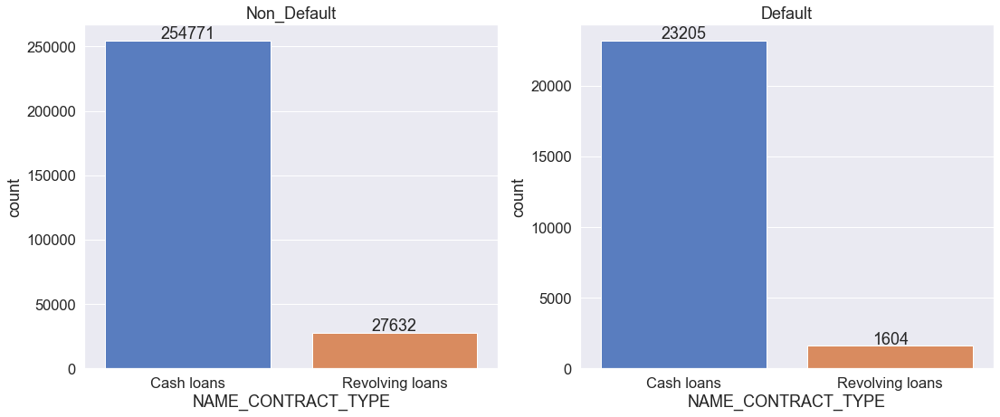

In [193]:
plt.figure(figsize=[18,7],facecolor="white")

plt.subplot(1,2,1)
plt.title('Non_Default')
splot = sns.countplot(x='NAME_CONTRACT_TYPE', data=Non_Default, palette='muted')
bar_annot(splot)

plt.subplot(1,2,2)
plt.title('Default')
splot = sns.countplot(x='NAME_CONTRACT_TYPE', data=Default, palette='muted')
bar_annot(splot)

plt.show()

# Inference
<hr>

* About 8% of <b><i>Cash loans</i></b> are defaulting while the number for <b><i>Revolving loans</i></b> is less than 6%

###### CODE_GENDER

In [194]:
 # checking percentage of each unique entry using pie chart
fig = px.pie(data_frame= application.CODE_GENDER.value_counts(normalize=True).reset_index(), width=500, height=400, names='index', values='CODE_GENDER')   
fig.update_layout(paper_bgcolor='LightSteelBlue')

# Insight
<hr>
* Majority of current applicants are Female(65.9%) and with male applicants(34.1%) being about half the number of female applicants

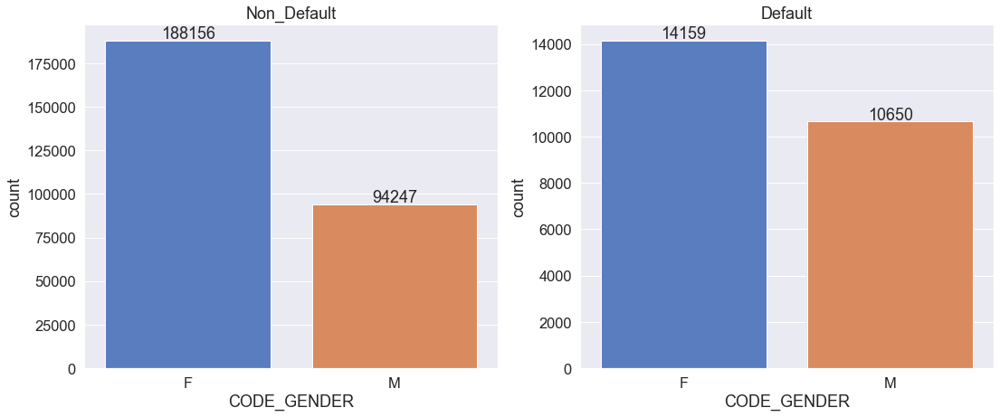

In [195]:
plt.figure(figsize=[18,7])

plt.subplot(1,2,1)
plt.title('Non_Default')
splot = sns.countplot(x='CODE_GENDER', data=Non_Default, palette='muted')
bar_annot(splot)

plt.subplot(1,2,2)
plt.title('Default')
splot = sns.countplot(x='CODE_GENDER', data=Default, palette='muted', order=['F','M'])
bar_annot(splot)

plt.show()

# Insight
<hr>

* Number of Female applicants are higher in both Non_Defaulting as well as Defaulting applicants 
* The Male applicants are about half the number of Female applicants for non-defaulters
* While the Male applicants and Female applicants are close in numbers for defaulters

# Inference
<hr>

* Male applicants are more likely to default(~10%) than Female applicants(About 7%)

###### NAME_INCOME_TYPE

In [196]:
px.histogram(application.NAME_INCOME_TYPE, height=600, width=800)

# Insight
<hr>
Majority of applicants have Income type 'Working' with Commercial associates and Pensioners being 2nd and 3rd and State Servent being 4th

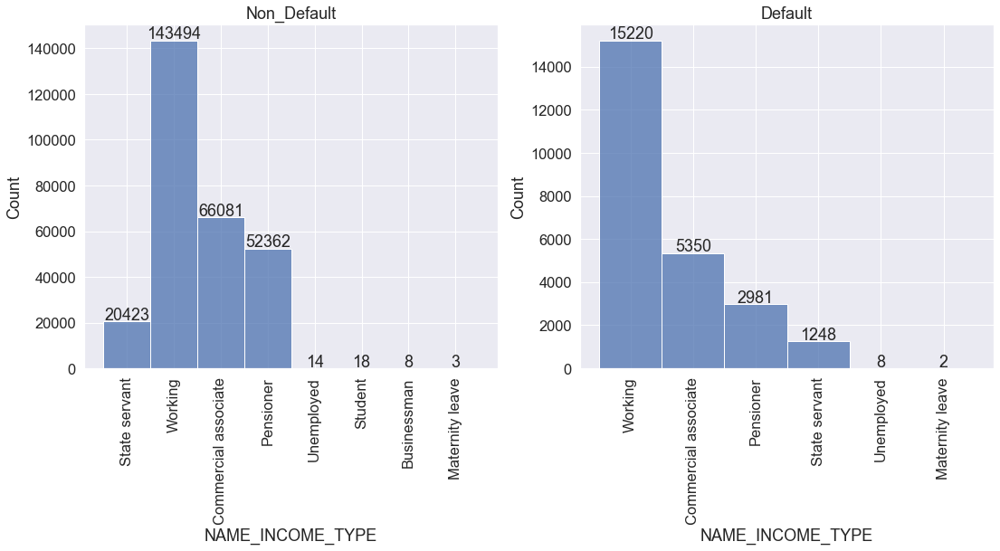

In [197]:
plt.figure(figsize=[18,7])

plt.subplot(121)
splot = sns.histplot(Non_Default.NAME_INCOME_TYPE )
plt.title('Non_Default')
plt.xticks(rotation=90)
bar_annot(splot)

plt.subplot(122)
splot = sns.histplot(Default.NAME_INCOME_TYPE)
plt.title('Default')
plt.xticks(rotation=90)
bar_annot(splot)

plt.show()

# Inference
<hr>

* <i><b>Maternity leave</b></i> and <i><b>Unemployed</b></i> though minimal in numbers have highest number of defaulter which is about 40% for <i><b>Maternity leave</b></i> and about 36% for <i><b>Unemployed</b></i> ; rest have less than 10% defaulters<br><br>
  
* The applicants with income type as <i><b>Pensioner</b></i> and <i><b>State servant</b></i> though only 18% and 7% of all the income types has the least amount of defaulters(~5%)


* The applicants with income type <i><b>Businessman</b></i> and <i><b>Student</b></i> though minimal in numbers have no history of defaulting.

###### NAME_FAMILY_STATUS

In [198]:
 # checking percentage of each unique entry using pie chart
fig = px.pie(data_frame= application.NAME_FAMILY_STATUS.value_counts(normalize=True).reset_index(), width=600, height=400, names='index', values='NAME_FAMILY_STATUS')   
fig.update_layout(paper_bgcolor='LightSteelBlue')

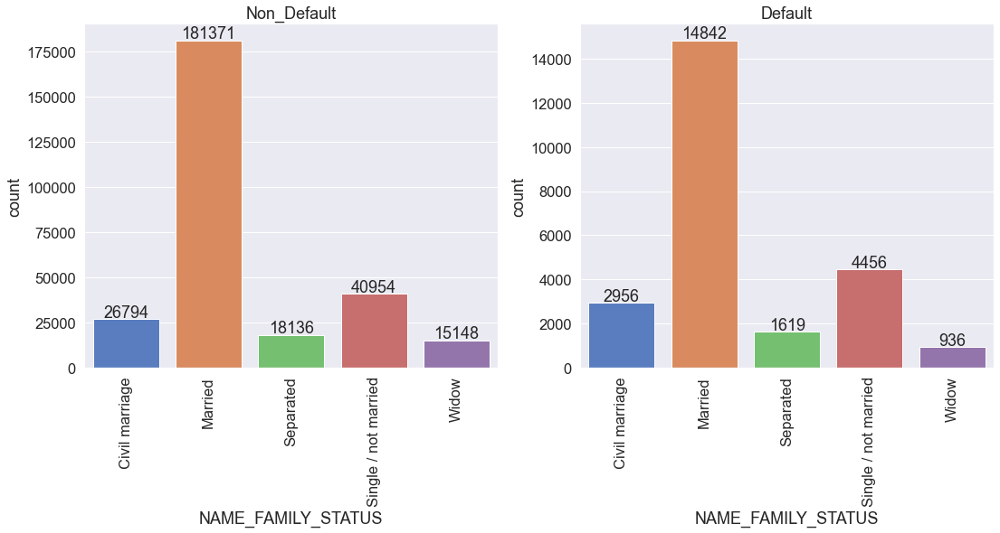

In [199]:
plt.figure(figsize=[18,7])

plt.subplot(121)
splot = sns.countplot(Non_Default.NAME_FAMILY_STATUS.sort_values(), palette='muted')
plt.title('Non_Default')
plt.xticks(rotation=90)
bar_annot(splot)

plt.subplot(122)
splot = sns.countplot(Default.NAME_FAMILY_STATUS.sort_values(), palette='muted')
plt.title('Default')
plt.xticks(rotation=90)
bar_annot(splot)

plt.show()

# Insight
<hr>

* Majority(~63%) of apllicants are <b><i>Married</i></b> followed by <b><i>Single/not married</i></b>, <b><i>Civil marraige</i></b>, <b><i>Seperated</i></b> and <b><i>Widow</i></b> being 14.8%, 9.68%, 6.43% and 5.24%

# Infenrence
<hr>

* <b><i>Civil marraige</i></b> applicants have highest percentage of defaulters (10%) and
<b><i>Widow</i></b> have the least defaulting applicants(~6%)

###### NAME_EDUCATION_TYPE

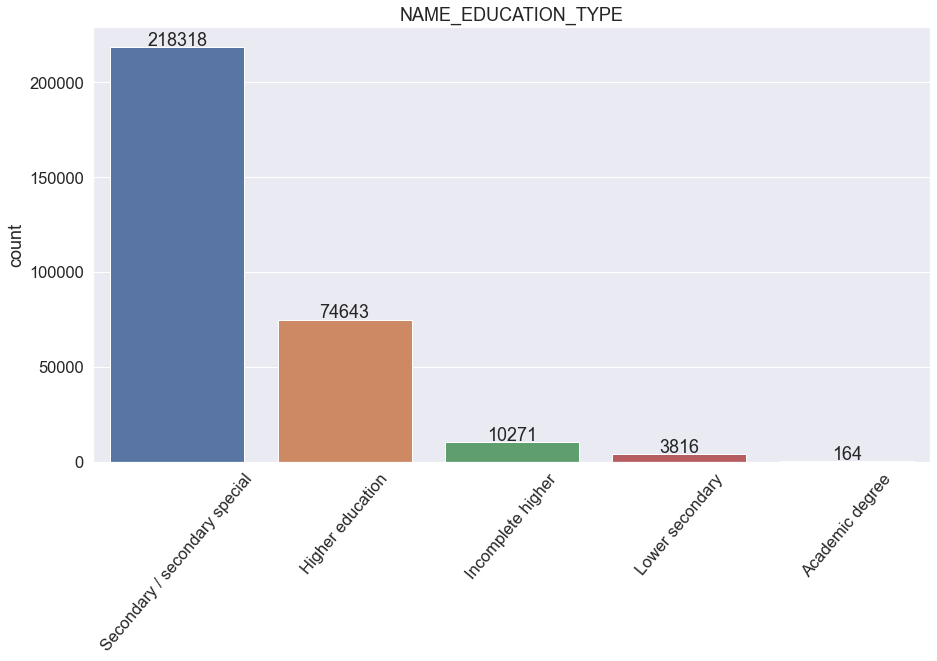

In [200]:
plt.figure(figsize=[15,8])
splot = sns.countplot(application.NAME_EDUCATION_TYPE)
plt.title('NAME_EDUCATION_TYPE')
plt.xlabel(None)
plt.xticks(rotation=50)
bar_annot(splot)

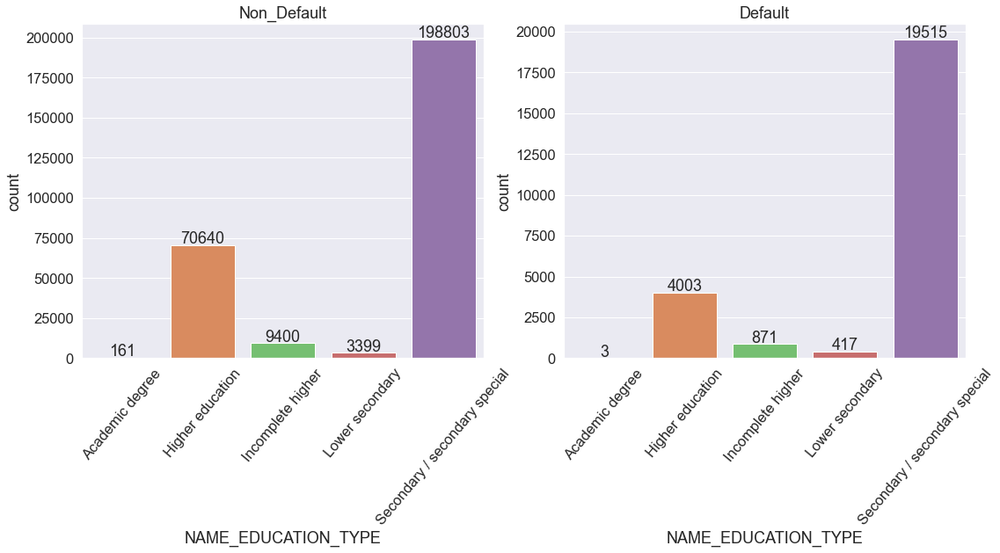

In [201]:
plt.figure(figsize=[18,7])

plt.subplot(121)
splot = sns.countplot(Non_Default.NAME_EDUCATION_TYPE.sort_values(), palette='muted')
plt.title('Non_Default')
plt.xticks(rotation=50)
bar_annot(splot)

plt.subplot(122)
splot = sns.countplot(Default.NAME_EDUCATION_TYPE.sort_values(), palette='muted')
plt.title('Default')
plt.xticks(rotation=50)
bar_annot(splot)

plt.show()

In [202]:
application[application.TARGET==1].NAME_EDUCATION_TYPE.value_counts()/application.NAME_EDUCATION_TYPE.value_counts()*100

Secondary / secondary special    8.938796
Higher education                 5.362861
Incomplete higher                8.480187
Lower secondary                 10.927673
Academic degree                  1.829268
Name: NAME_EDUCATION_TYPE, dtype: float64

# Insight
<hr>

* Majority of total applicants have highest education level as <b><i>Secondary/ secondary special</i></b>

* Applicants with highest level of education as <b><i>Lower secondary</i></b> have highest probability of defaulting (>10%)

* Applicants with highest level of education as <b><i>Academic degree</i></b> have the least probability of defaulting (<2%)

###### NAME_HOUSING_TYPE

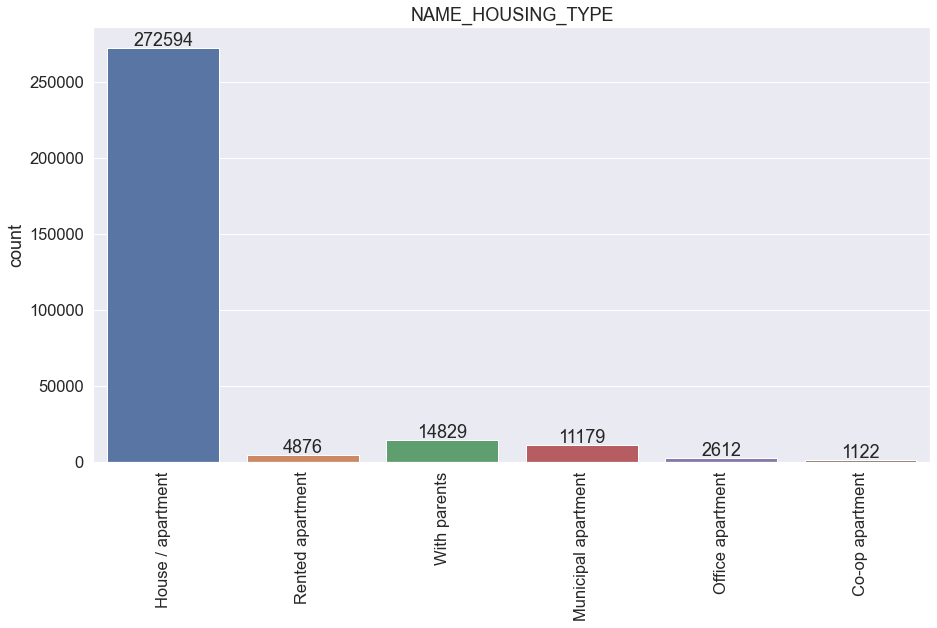

In [203]:
plt.figure(figsize=[15,8])
splot = sns.countplot(application.NAME_HOUSING_TYPE)
plt.title('NAME_HOUSING_TYPE')
plt.xlabel(None)
plt.xticks(rotation=90)
bar_annot(splot)

# Insight
<hr>
About 88% of NAME_HOUSE_TYPE is House/apartment

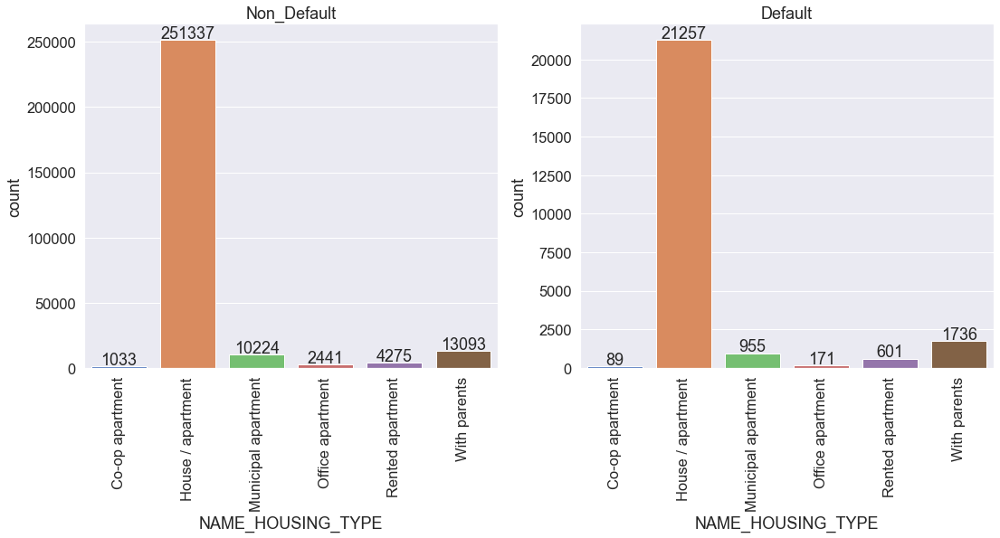

In [204]:
plt.figure(figsize=[18,7])

plt.subplot(121)
splot = sns.countplot(Non_Default.NAME_HOUSING_TYPE.sort_values(), palette='muted')
plt.title('Non_Default')
plt.xticks(rotation=90)
bar_annot(splot)

plt.subplot(122)
splot = sns.countplot(Default.NAME_HOUSING_TYPE.sort_values(), palette='muted')
plt.title('Default')
plt.xticks(rotation=90)
bar_annot(splot)

plt.show()

# Inference
<hr>

* applicants living in <b><i>Rented apartment</i></b> and <b><i>With parents</i></b> have higher probability of defaulting which in about >12% for <b><i>Rented apartment</i></b> and about 13% for <b><i>With parents</i></b><br><br>

* applicants living in <b><i>Office apartments</i></b> have lowest probability of defaulting(~6%)

###### FLAG_OWN_CAR

In [205]:
 # checking percentage of each unique entry using pie chart
fig = px.pie(data_frame= application.FLAG_OWN_CAR.value_counts().reset_index(), names=['No','Yes'],  title='FLAG_OWN_CAR', hole=0.5, width=600, height=400, values='FLAG_OWN_CAR')   
fig.update_layout(paper_bgcolor='snow')

# Insight
<hr>
About 66% of applicants don't own a car

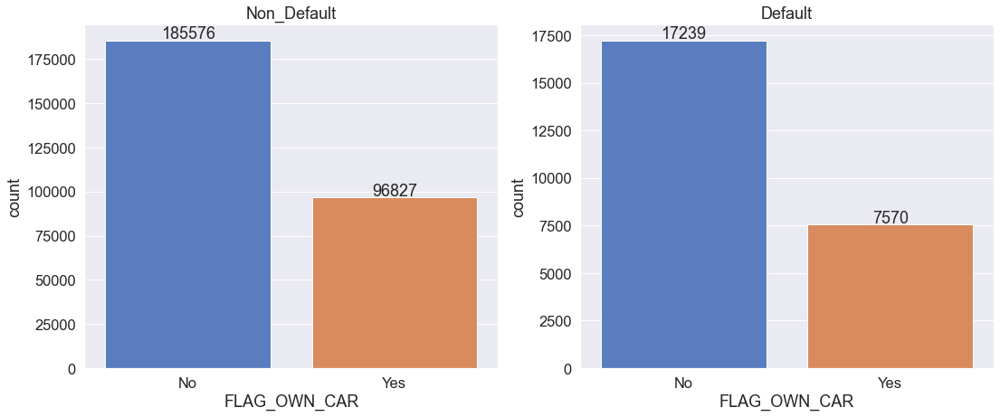

In [206]:
plt.figure(figsize=[18,7])

plt.subplot(121)
splot = sns.countplot(Non_Default.FLAG_OWN_CAR.sort_values(), palette='muted')
plt.title('Non_Default')
plt.xticks(ticks=[0,1], labels=['No','Yes'])
bar_annot(splot)

plt.subplot(122)
splot = sns.countplot(Default.FLAG_OWN_CAR.sort_values(), palette='muted')
plt.title('Default')
plt.xticks(ticks=[0,1], labels=['No','Yes'])
bar_annot(splot)

plt.show()

# Inference
<hr>
* People who dont own a car have a bit more probability(~8%) of defaulting than people who own a car (about 7%)

###### FLAG_OWN_REALTY

In [207]:
 # checking percentage of each unique entry using pie chart
fig = px.pie(data_frame= application.FLAG_OWN_REALTY.value_counts().reset_index(), names=['Yes','No'],  title='FLAG_OWN_REALTY', hole=0.5, width=600, height=400, values='FLAG_OWN_REALTY')   
fig.update_layout(paper_bgcolor='snow')

# Insight
<hr>

* Number of applicants who own a house or flat is about 70% and who don't is about 30%

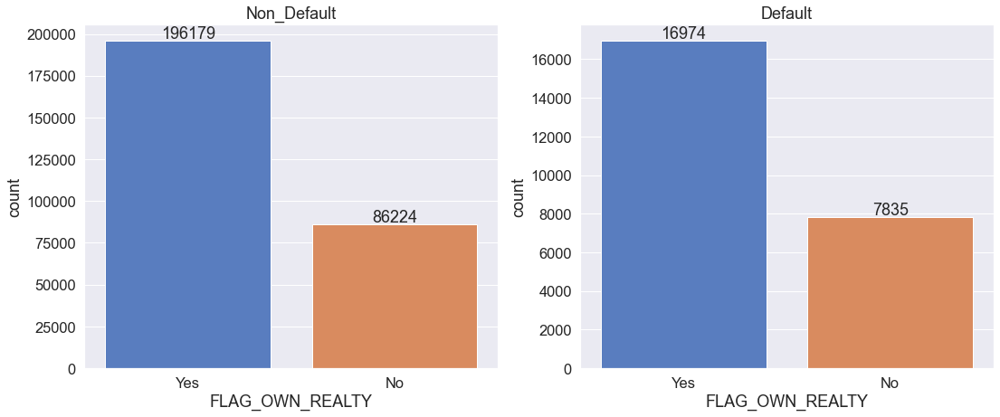

In [208]:
plt.figure(figsize=[18,7])

plt.subplot(121)
splot = sns.countplot(Non_Default.FLAG_OWN_REALTY.sort_values(ascending=False), palette='muted')
plt.title('Non_Default')
plt.xticks(ticks=[0,1], labels=['Yes','No'])
bar_annot(splot)

plt.subplot(122)
splot = sns.countplot(Default.FLAG_OWN_REALTY, palette='muted')
plt.title('Default')
plt.xticks(ticks=[0,1], labels=['Yes','No'])
bar_annot(splot)

plt.show()

# Inference
<hr>

* There is little to none difference between applicants who own house/flat and default and applicants who dont own house/flat and also dont default

###### OCCUPATION_TYPE

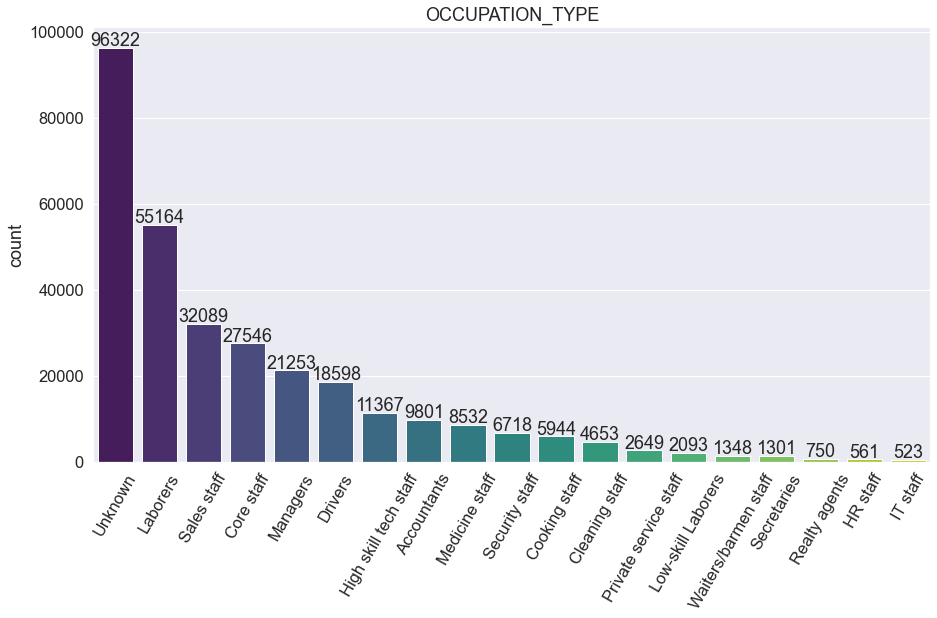

In [209]:
plt.figure(figsize=[15,8])
splot = sns.countplot(application.OCCUPATION_TYPE, palette='viridis', order=application.OCCUPATION_TYPE.value_counts().index) 
plt.title('OCCUPATION_TYPE')
plt.xlabel(None)
plt.xticks(rotation=60)
bar_annot(splot)
plt.show()

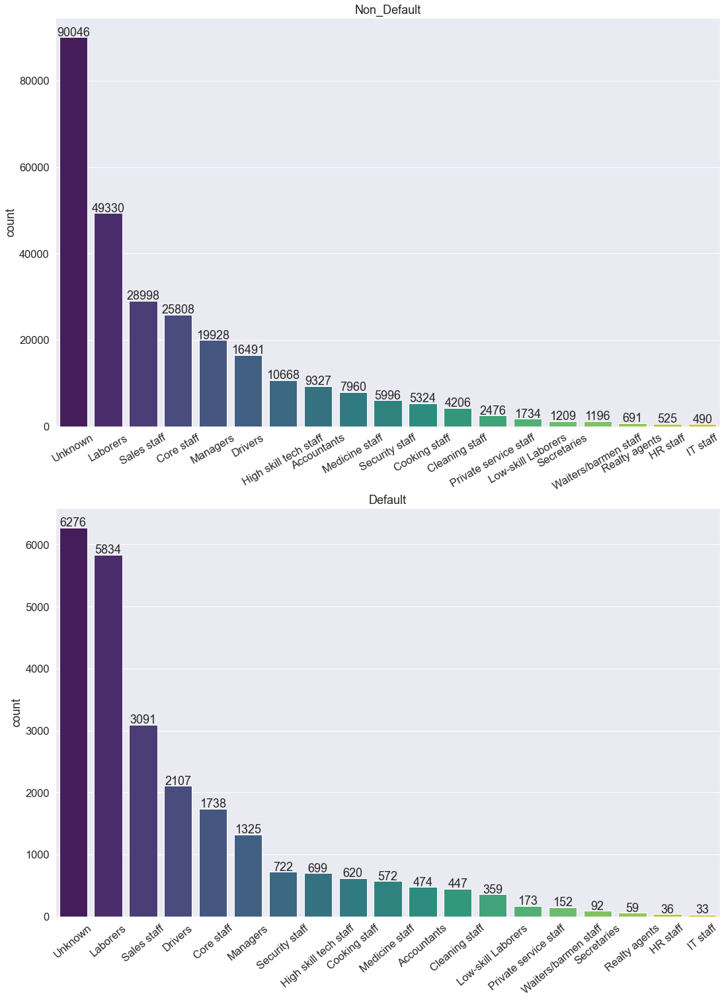

In [210]:
plt.figure(figsize=[18,25])

plt.subplot(211)
splot = sns.countplot(Non_Default.OCCUPATION_TYPE, palette='viridis', order=Non_Default.OCCUPATION_TYPE.value_counts().index) 
plt.title('Non_Default')
plt.xlabel(None)
plt.xticks(rotation=30)
bar_annot(splot)

plt.subplot(212)
splot = sns.countplot(Default.OCCUPATION_TYPE, palette='viridis', order=Default.OCCUPATION_TYPE.value_counts().index) 
plt.xlabel(None)
plt.title('Default')
plt.xticks(rotation=40)
bar_annot(splot)

plt.show()

# Insights
<hr>

* Majority of applicants have their occupation type as <b><i>Unknown</i></b>, <b><i>Laborers</i></b> or <b><i>Sales staff</i></b>

# Inference
<hr>

* The most defaulting occupation type is <b><i>Low-skill Laborers</i></b> with about 17% of total applicants defaulting<br><br>

* The other occupation types with high defaulting percentages in order are <b><i>Drivers (>11%)</i></b>, <b><i>Waiters/barmen staf (>11%)</i></b>, <b><i>Security staff (>10%)</i></b>, <b><i>Laborers (>10%)</i></b> and <b><i>Cooking staff (>10%)</i></b><br><br>

* Rest of the occupation types have less than 10% defaulters of the total number of applicants of that particular occupation type with the lowest defaulting occupation being <b><i>Acoountants</i></b> with only 5% defaulting rate

###### ORGANIZATION_TYPE

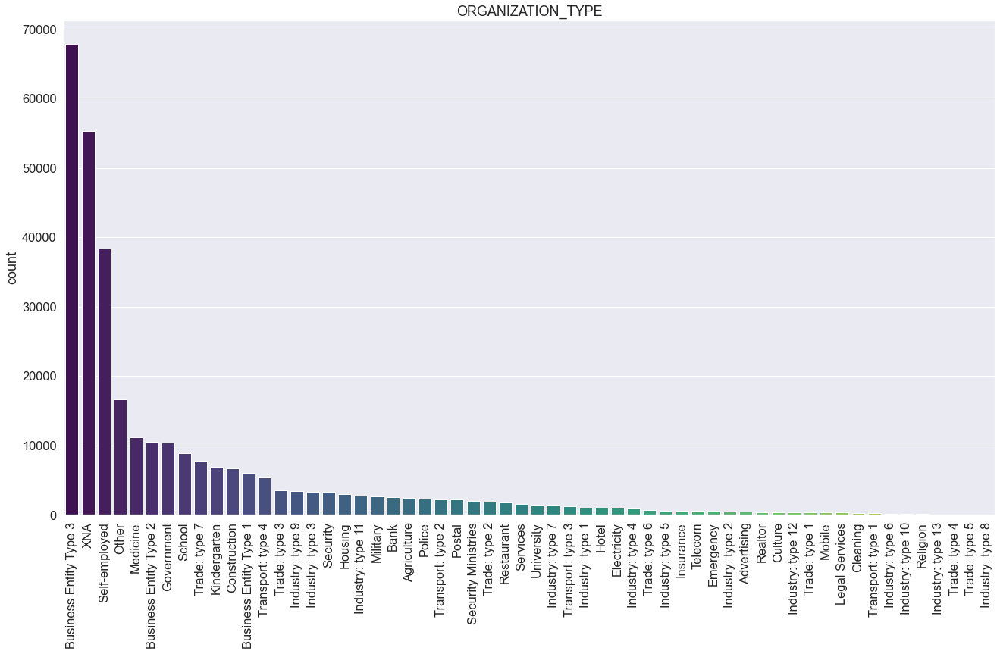

In [211]:
plt.figure(figsize=[22,12])
splot = sns.countplot(application.ORGANIZATION_TYPE, palette='viridis', order=application.ORGANIZATION_TYPE.value_counts().index) 
plt.title('ORGANIZATION_TYPE')
plt.xlabel(None)
plt.xticks(rotation=90)
plt.show()

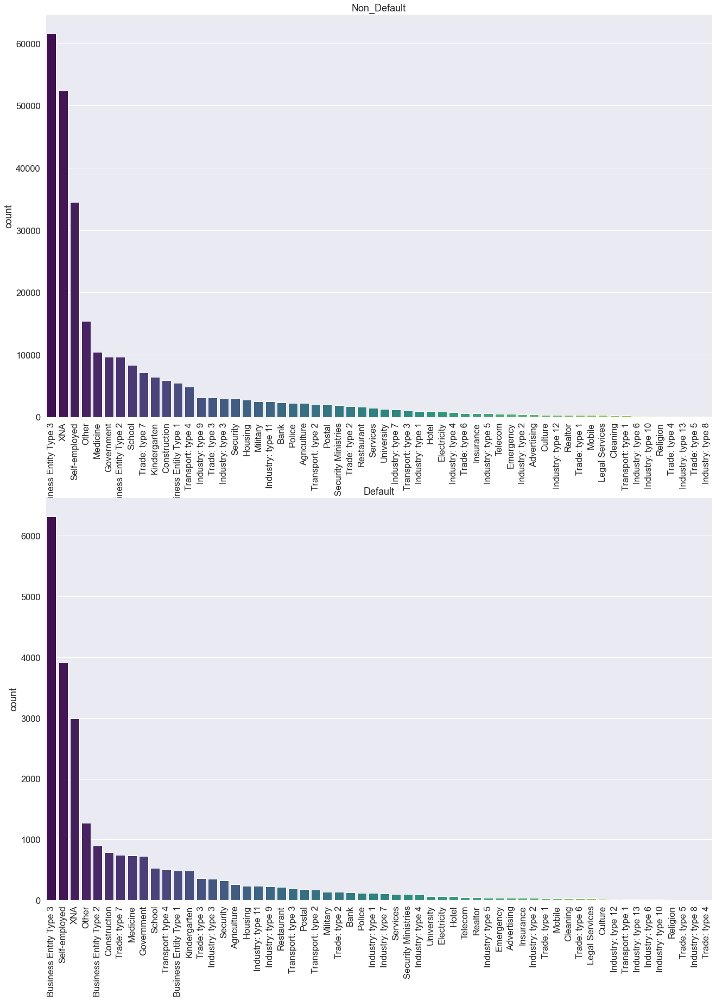

In [212]:
plt.figure(figsize=[22,30])

plt.subplot(211)
splot = sns.countplot(Non_Default.ORGANIZATION_TYPE, palette='viridis', order=Non_Default.ORGANIZATION_TYPE.value_counts().index) 
plt.title('Non_Default')
plt.xlabel(None)
plt.xticks(rotation=90)

plt.subplot(212)
splot = sns.countplot(Default.ORGANIZATION_TYPE, palette='viridis', order=Default.ORGANIZATION_TYPE.value_counts().index) 
plt.xlabel(None)
plt.title('Default')
plt.xticks(rotation=90)

plt.show()

# Inference
<hr>

* The most defaulting Organization type is <b><i>Transport: type 3</i></b> with >15% defaulting rate<br><br>

* The least defaulting Organization type is <b><i>Trade: type 4</i></b> with only about 3% applicants defaulting of the total applicants in Trade: type 4 Organization type

###### REGION_RATING_CLIENT

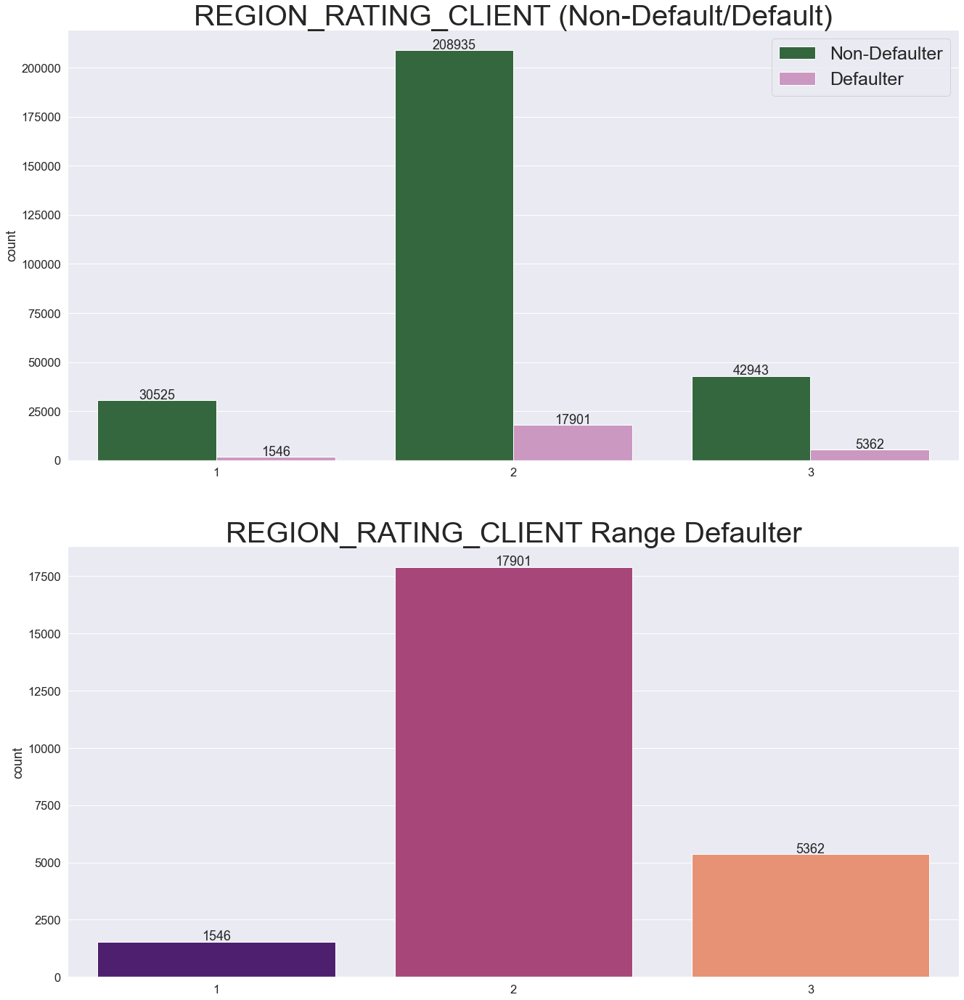

In [213]:
segmented_anlaysis('REGION_RATING_CLIENT')

# Insight
<hr>

* clients residing in regions with rating 1 has the least probability of defaulting (<5%) while clients residing in regions with rating 3 has the highest probability of defaulting (>11%)

###### AGE

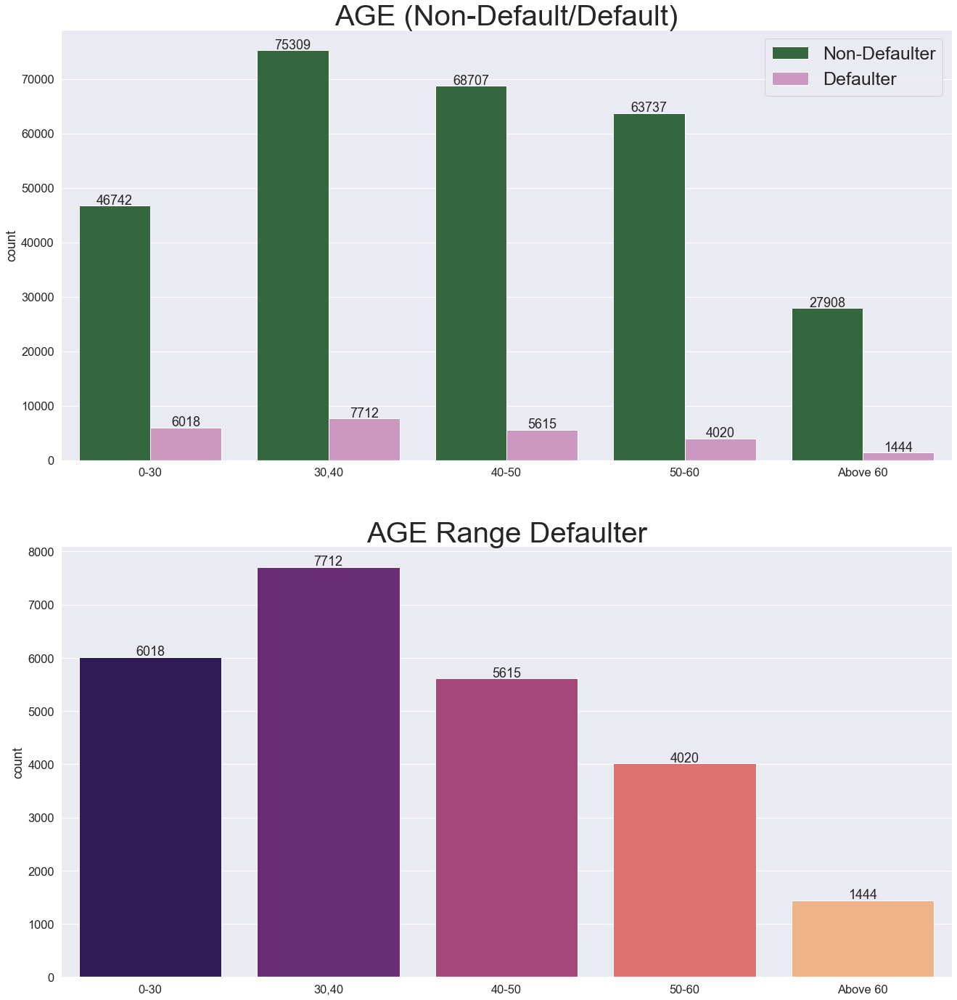

In [214]:
segmented_anlaysis('AGE')

# Insights
<hr>

* Majority of applicants are between the age <b><i>30-60</i></b><br><br>

* The Highest number of defaulters are in the age range <b><i>30-40</i></b> followed by <b><i>0-30</i></b> then <b><i>40-50</i></b> then <b><i>50-60</i></b> and finally <b><i>Above 60</i></b>

# Inference
<hr>

* The Age range with higher probability of defaulting is <b><i>0-30</i></b> with about 11% of total applicants defaulting out of total applicants in this range<br><br>

* The Least defaulting applicants are <b><i>Above 60</i></b> with only ~5% defaulting rate

###### INCOME_RANGE

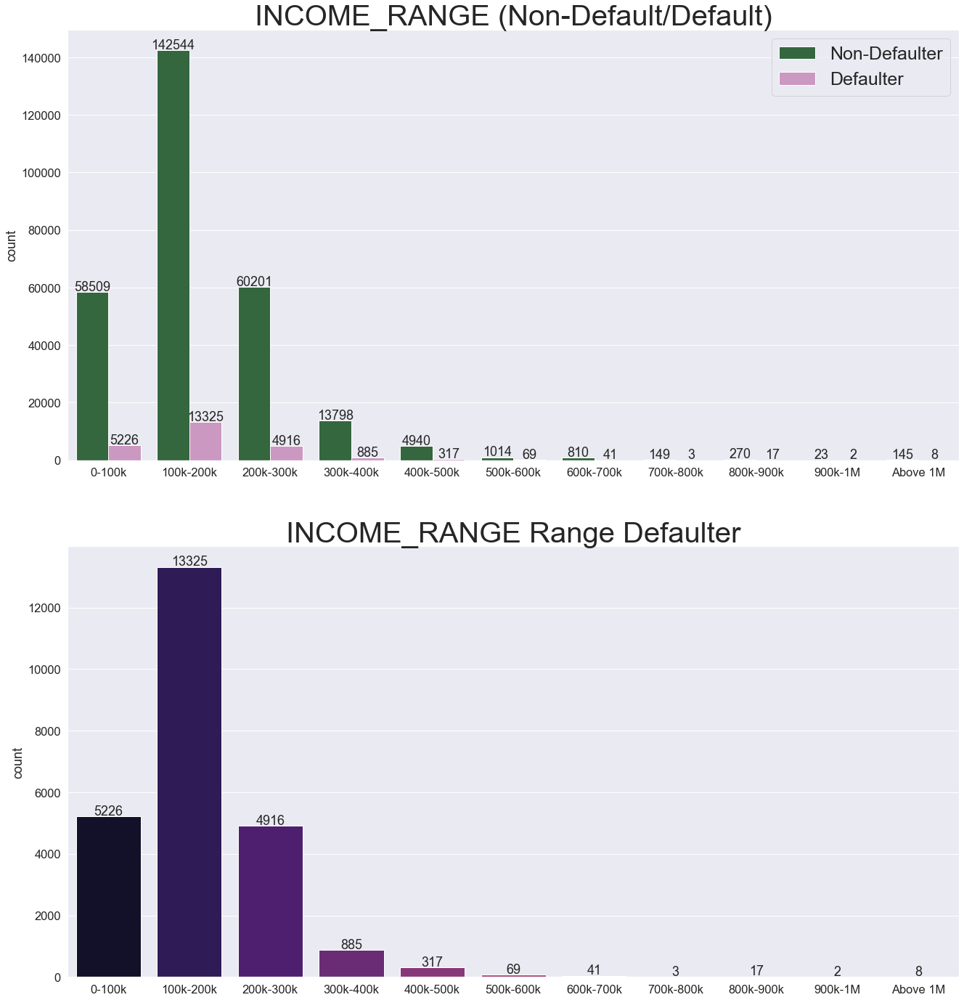

In [215]:
segmented_anlaysis('INCOME_RANGE')

# Insights
<hr>

* Majority of applicants are between the income range <b><i>0-300k</i></b><br><br>

* The Highest number of defaulters are in the income ranges <b><i>100k-200k</i></b>(>8%), <b><i>0-100k</i></b>(~8%) and <b><i>900k-1M</i></b>(8%) <br><br>

* applicants in the income range 700k-800k though very less in number have the least defaulters with less than 2% of applicants defaulting

# Inference
<hr>

* People with income less tha 200k are more likely to default than people with income above 200k, the exception being income range <b><i>900k-1M</i></b> which also has high percentage of defaulters

###### YEARS_EMPLOYED

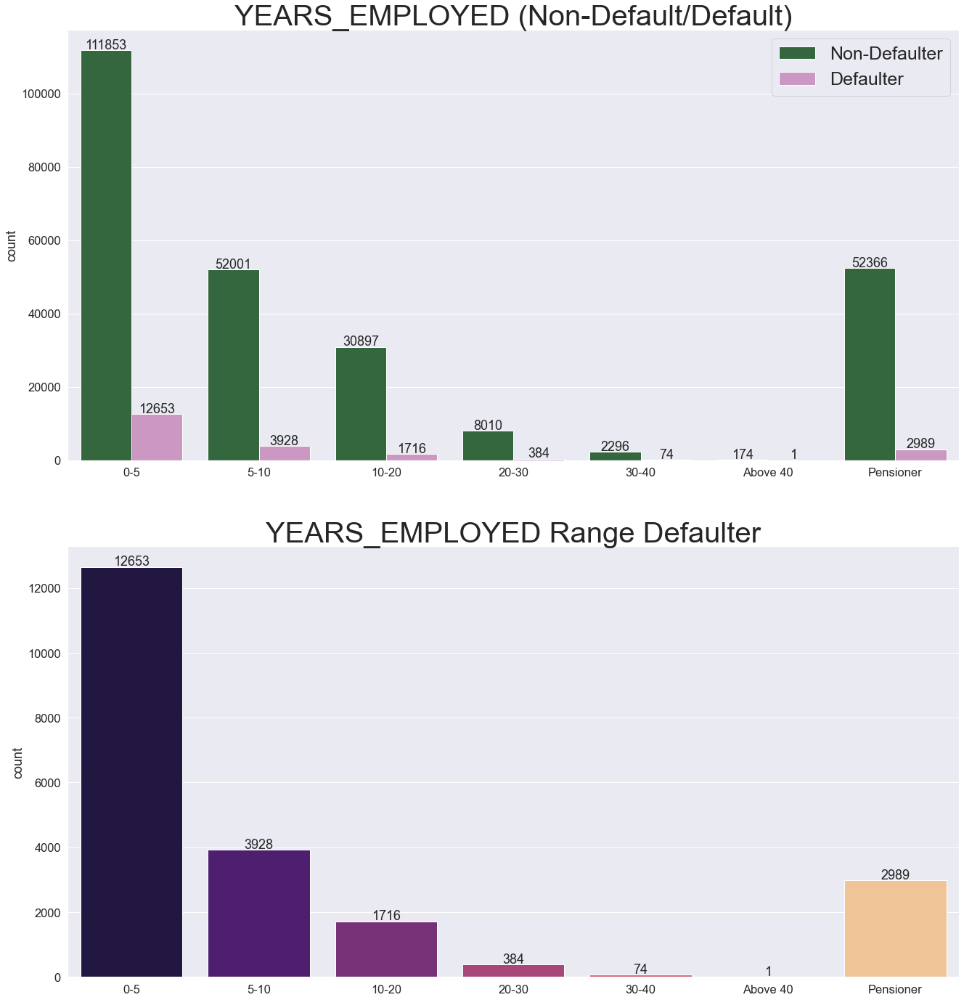

In [216]:
segmented_anlaysis('YEARS_EMPLOYED')

# Insights
<hr>

* Majority of applicants are either been employed for less than 10 years or are retired Pensioners<br><br>

* The majority of defaulters are also either been employed for less than 10 years or are retired Pensioners with highest number of defaulters being in the <b><i>0-5 (~10%)</i></b> years ranges and lowest being <b><i>Above 40 (Less than 1%) </i></b> <br><br>

# Inference
<hr>

* applicants who are employed for more than 40 years have the least probability of defaulting and are safer for loan approval

* As the years employed increases the probabilty of applicants being defaulter decrease

###### AMT_CREDIT_RANGE

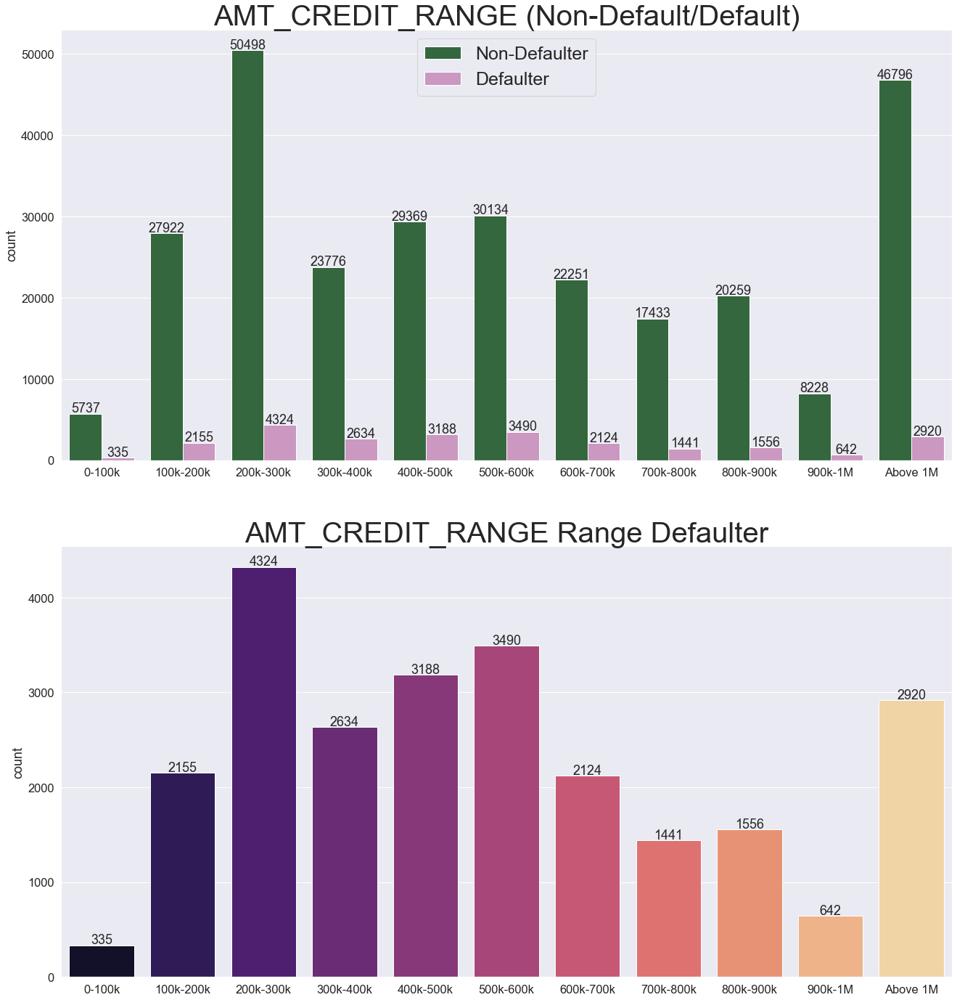

In [217]:
segmented_anlaysis('AMT_CREDIT_RANGE')

# Insights
<hr>

* Majority of applicants have AMT_CREDIT between 100k-600k<br><br>

* The highest number of defaulters are in the AMT_CREDIT range <b><i>200K-300K (>7%)</i></b> but the highest percentage of defaulters are in the range <b><i>500k-600k(>10%)</i></b> <br><br>

* the AMT_CREDIT ranges with least percentage of defaulters are <b><i>0-100k (less than 6%)</i></b> and <b><i>Above 1M(less than 6%)</i></b>

###### AMT_ANNUITY_RANGE

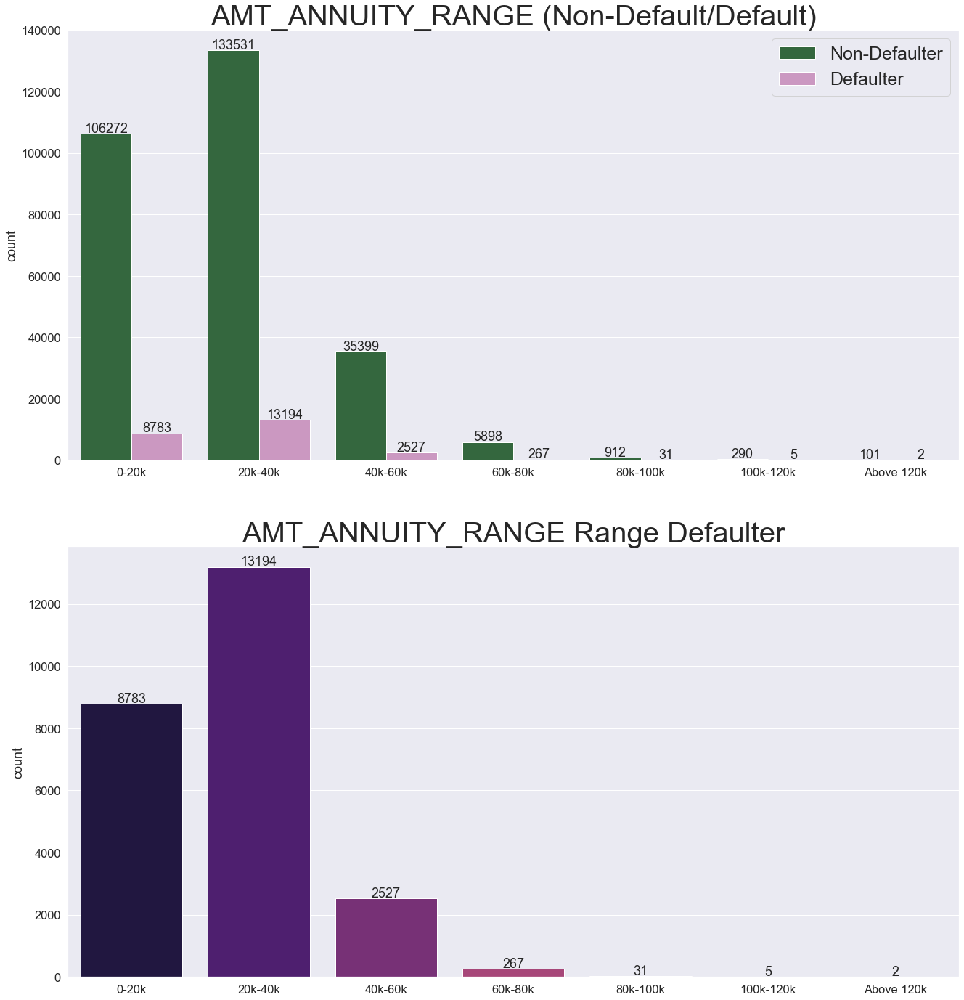

In [218]:
segmented_anlaysis('AMT_ANNUITY_RANGE')

# Insights
<hr>

* Majority of applicants have the AMT_ANNUITY less than 60K<br><br>

* The highest percentage of defaulters have AMT_ANNUITY between <b><i>20k-40k (>7%)</i></b> and the applicants having AMT_ANNUITY <b><i>100k-120k (>1%) </i></b> and <b><i>Above 120k (>1%) </i></b>

# Inference
<hr>

* The percentage of defaulters decrease as the AMT_ANNUITY increase with the exception being the range <b><i>20k-40k</i></b> where there is an increase in defaulting applicants

###### AMT_GOODS_PRICE_RANGE

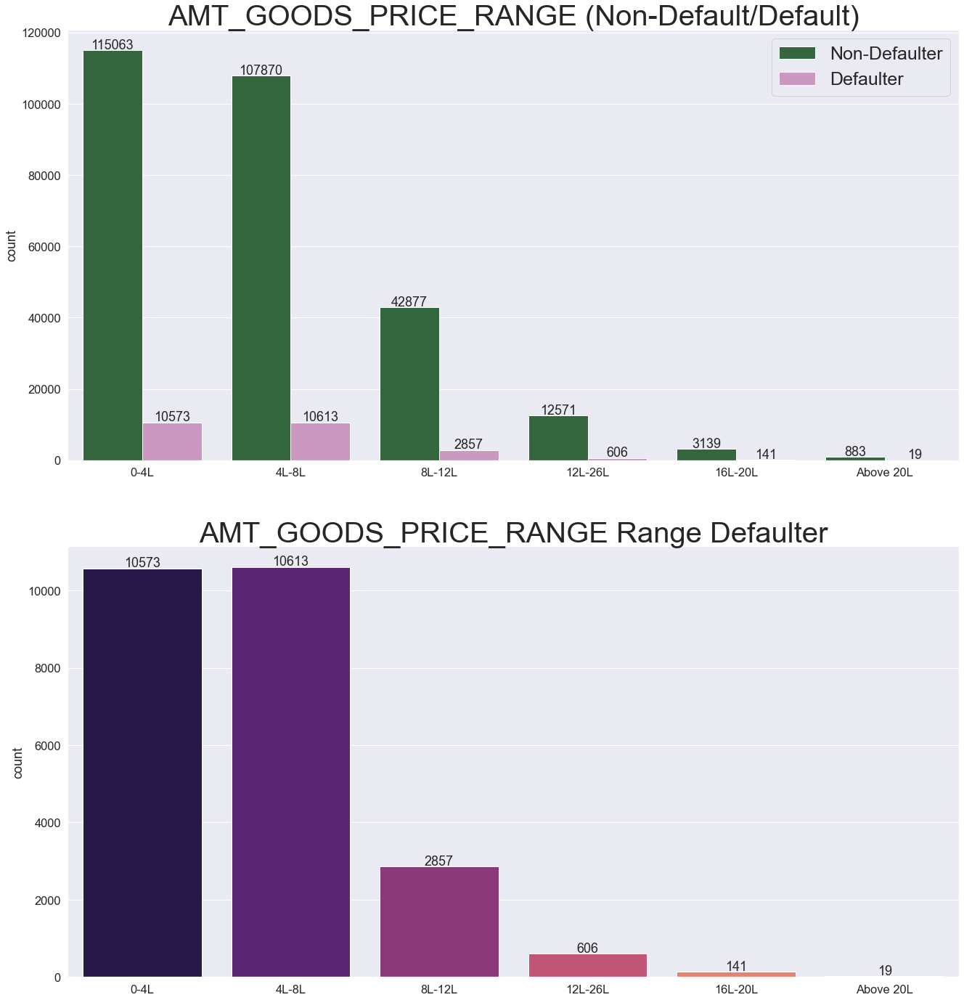

In [219]:
segmented_anlaysis('AMT_GOODS_PRICE_RANGE')

# Insights
<hr>

* Majority of applicants have the AMT_GOODS_PRICE less than 8L <br><br>

* The highest percentage of defaulters have AMT_GOODS_PRICE between <b><i>4L-8L (~9%)</i></b> followed by <b><i>0-4L (>8%) </i></b>, the AMT_GOODS_PRICE range having least percentage of defaulters is<b><i>Above 20L (~2%) </i></b>

###### CNT_CHILDREN and CNT_FAM_MEMBERS

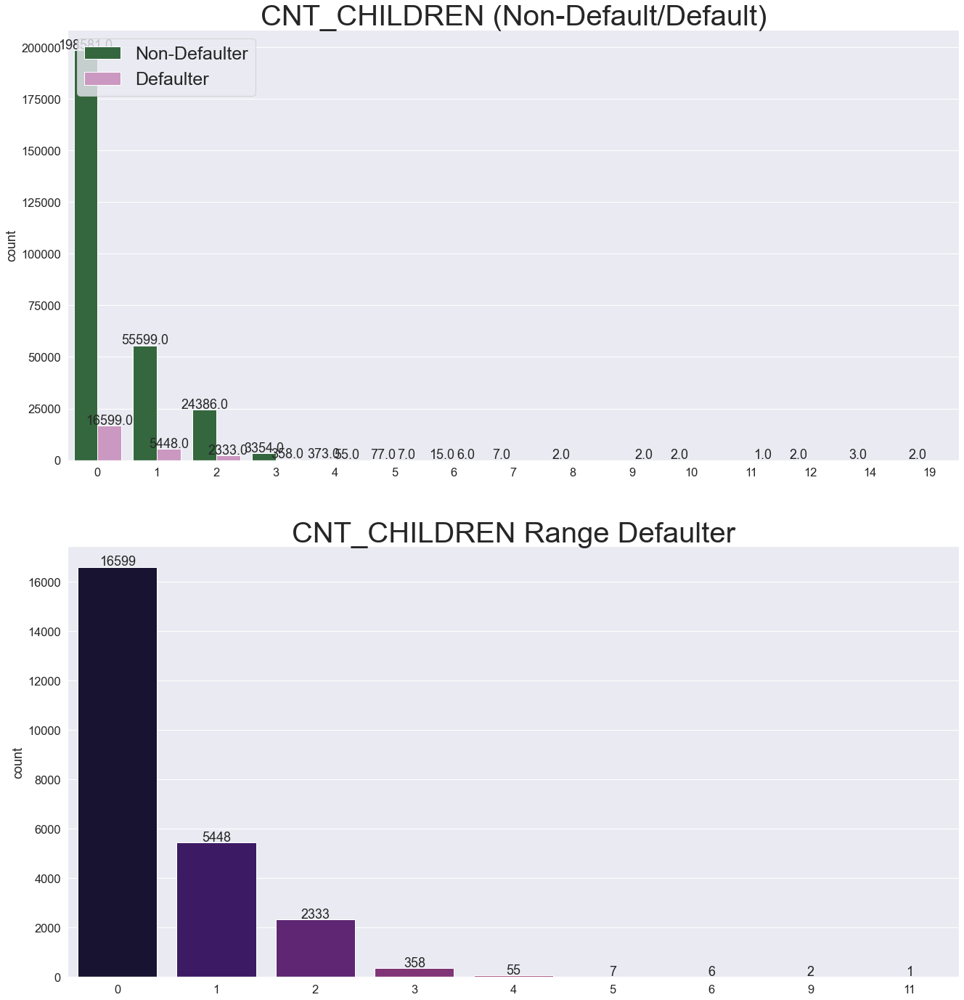

In [220]:
segmented_anlaysis('CNT_CHILDREN')

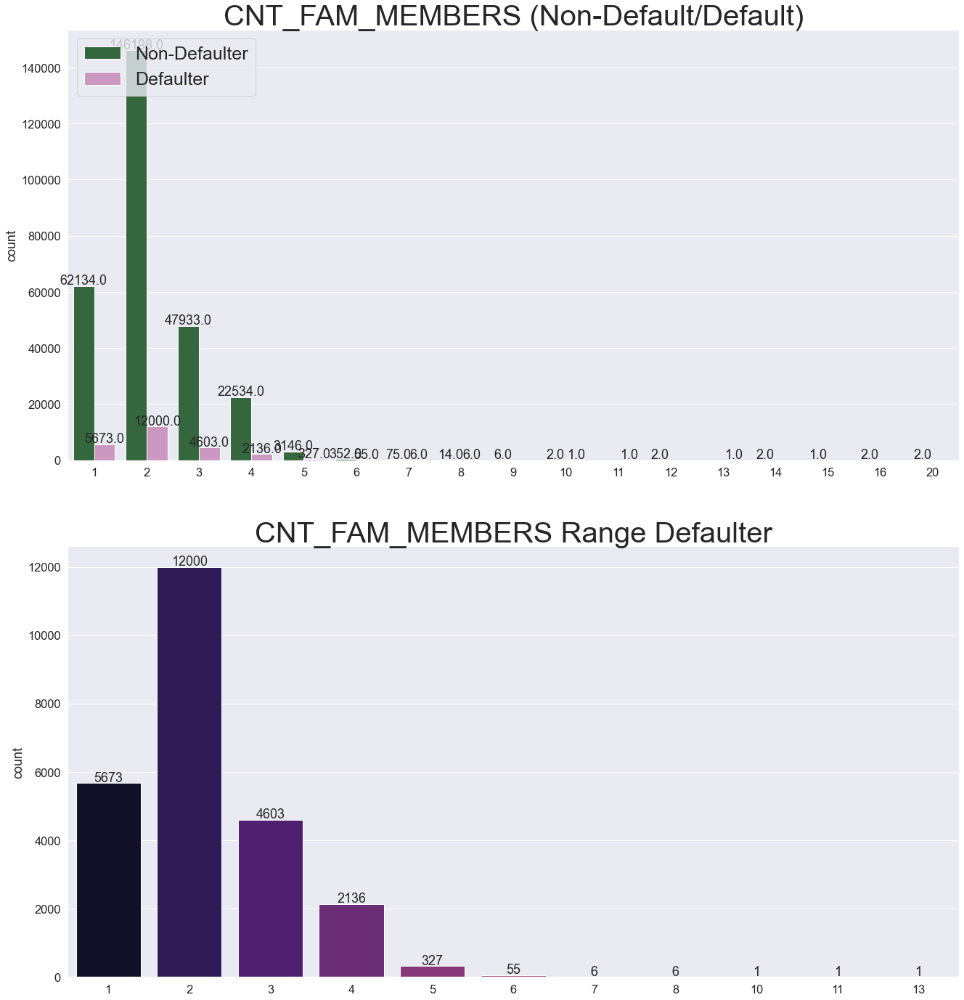

In [221]:
segmented_anlaysis('CNT_FAM_MEMBERS')

# Inference
<hr>

* As the number of family members increase, probability of applicants defaulting also increase

* we can see similar trend for CNT_CHILDREN

###### Plotting segmented distplots for AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY, AMT_GOODS_PRICE

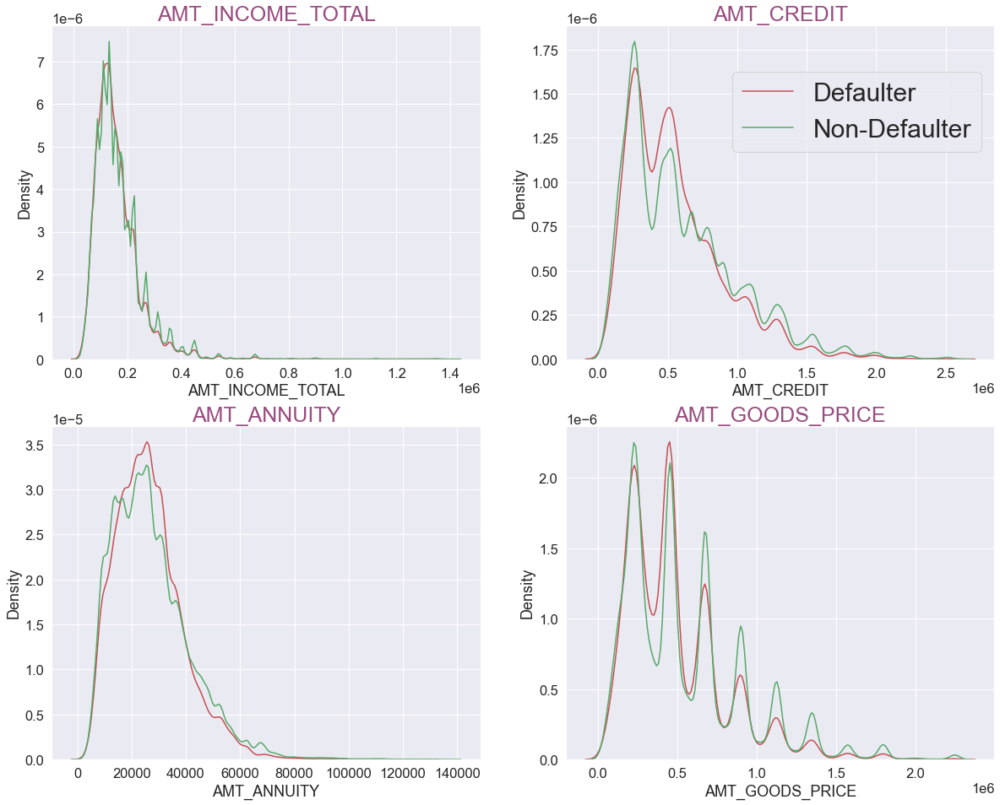

In [222]:
fig = plt.figure(figsize=(20,16))


for i,j in zip(range(1,5),[ 'AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY', 'AMT_GOODS_PRICE']):
    plt.subplot(2,2,i)
    sns.distplot(Default[j], hist=False, color='r',label ="Defaulter", hist_kws={'width':10})
    sns.distplot(Non_Default[j], hist=False, color='g', label ="Non-Defaulter")
    plt.title(j, fontdict={'fontsize' : 25, 'fontweight' : 5, 'color' : [0.6,0.3,0.5]})

plt.legend(bbox_to_anchor=[1,2.1], prop={'size':30})
plt.show()

# Inference
<hr>

* As in all the plots the distribution of both Defaulters and Non-Defaulters overlap so we cannot infer much from this

* Most applicants pay annuity amount less than 60,000 

* Most of credit amount is below 10,00,000

* Majority of applicants have total income below 4,00,000

* For the goods having price between the range 250K to 600K frequency of defaulters is slightly more than that of non_defaulters

# Bivariate and Multivariate Analysis
<hr>

### Segmented/Non-segmented

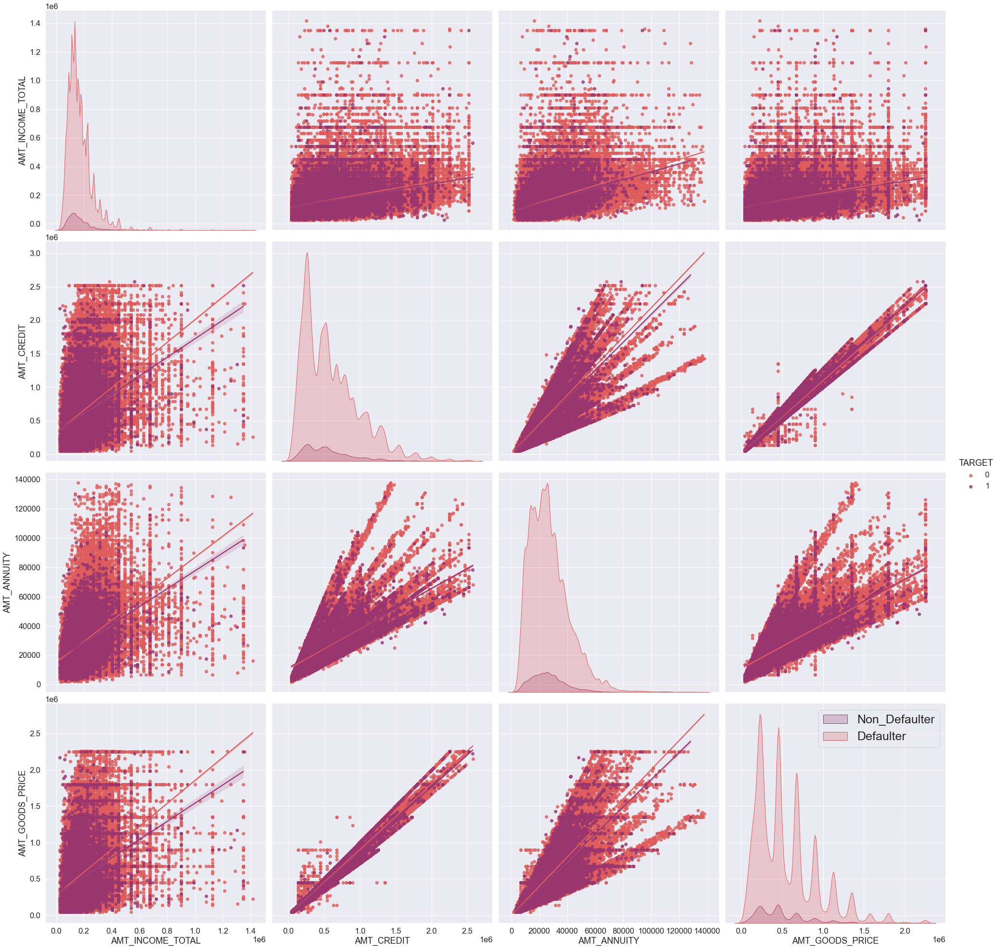

In [223]:
sns.pairplot(data=application, vars=['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE'], hue='TARGET',height=7, aspect=1, palette='flare', kind='reg')   
plt.legend(labels=['Non_Defaulter','Defaulter'], prop={'size':25})
plt.xlabel(['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE'], fontdict={'fontsize':20})
plt.ylabel(['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE'], fontdict={'fontsize':20})
plt.show()

# plotting pair plot for above columns to asses the distribution of data and correlation

# Inference
<hr>

* AMT_ANNUITY and AMT_CREDIT have a very high positive correlation while AMT_CREDIT and AMT__GOODS_PRICE also have high positive correlation

* AMT_INCOME_TOTAL has a moderate positive correlation with AMT_CREDIT, AMT_GOODS_PRICE and AMT_ANNUITY

In [224]:
# creating correlation matrix for application, Default and Non_Default dataframes
corr = application.corr()
corr_default = Default.corr()
corr_Non_default= Non_Default.corr()

###### Plotting heapmap for application dataframe

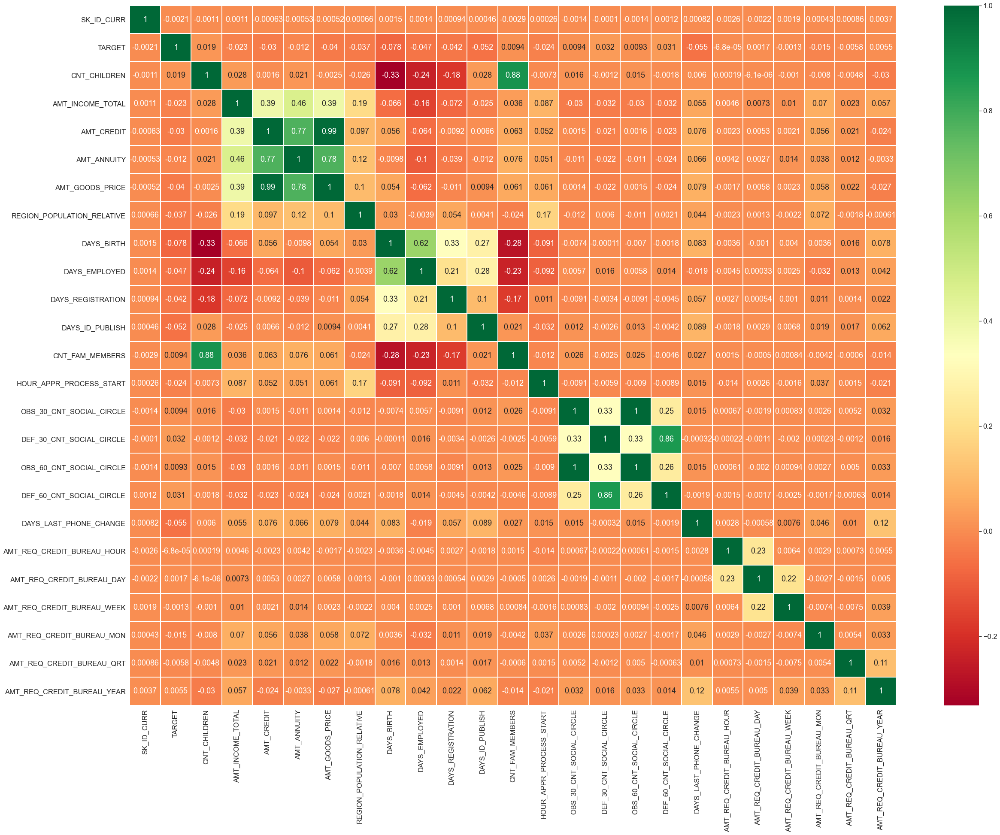

In [225]:
plt.figure(figsize=[40,30])
sns.heatmap(corr, annot=True, cmap='RdYlGn',linewidths=1)
plt.show()

###### Plotting heapmap for Default dataframe

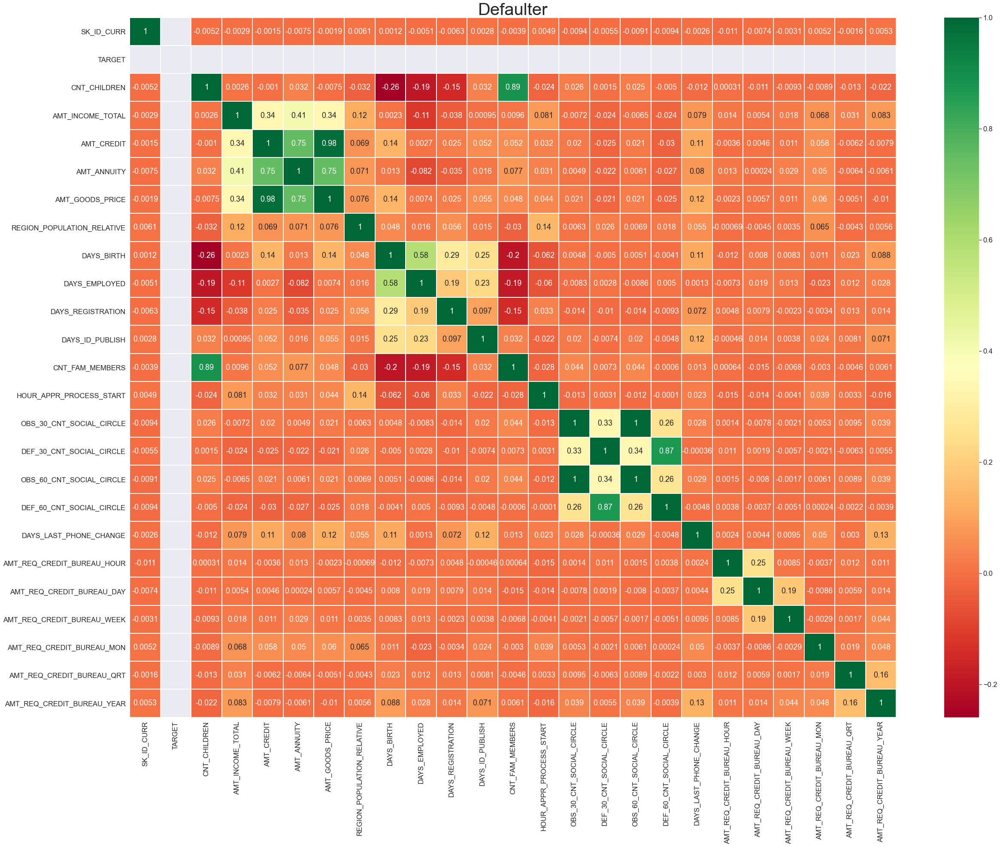

In [291]:
plt.figure(figsize=[40,30])
sns.heatmap(corr_default, annot=True, cmap='RdYlGn',linewidths=1)
plt.title('Defaulter', fontsize=40)
plt.show()

###### Plotting heapmap for Non_Default dataframe

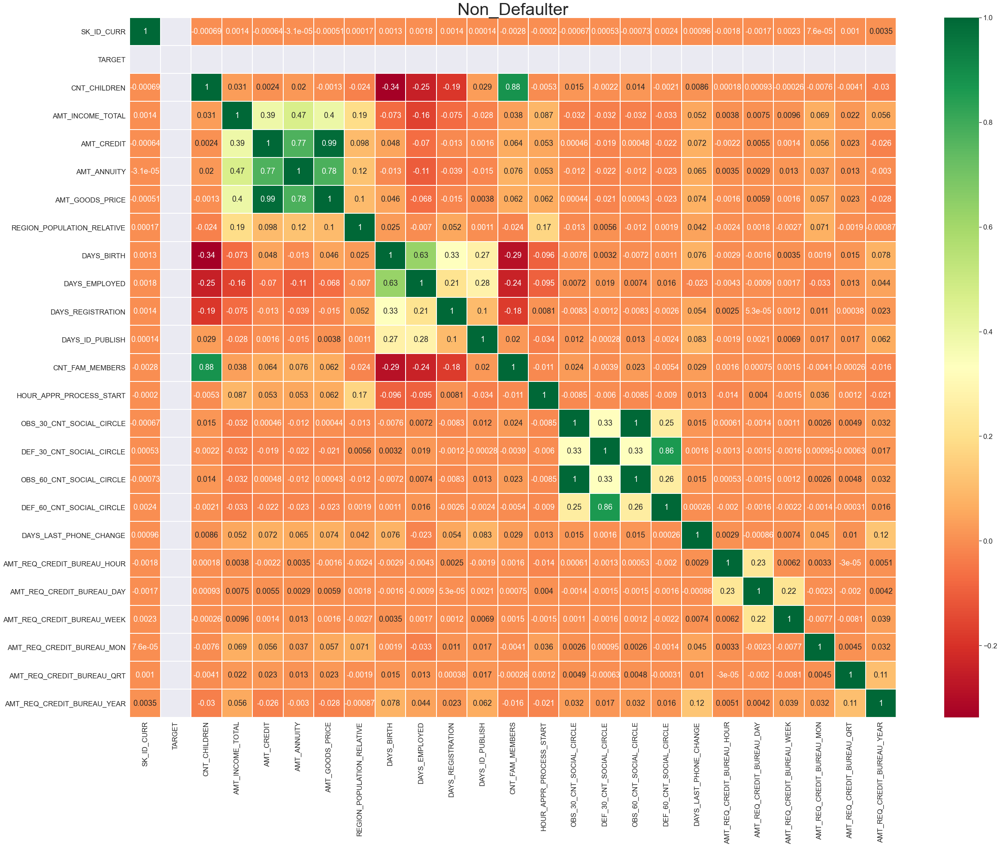

In [290]:
plt.figure(figsize=[40,30])
sns.heatmap(corr_Non_default, annot=True, cmap='RdYlGn',linewidths=1)
plt.title('Non_Defaulter', fontsize=40)
plt.show()

# Inference
<hr>

* AMT_CREDIT, AMT_GOODS_PRICE and AMT_ANNUITY all have high correlation with each other, where AMT_CREDIT and AMT_GOODS_PRICE is very highly correlated(~0.99)<br><br>

* Variables OBS_60_CNT_SOCIAL_CIRCLE and OBS_30_CNT_SOCIAL_CIRCLE have the highest correlation i.e. 1.
 DEF_60_CNT_SOCIAL_CIRCLE and DEF_30_CNT_SOCIAL_CIRCLE are also highly correlated(~0.86) which actually increases a bit from 0.86 to 0.87 for Defaulting applicants<br><br>

* For Defaulters the AMT_ANNUITY and AMT_CREDIT, AMT_ANNUITY and AMT_GOODS_PRICE correlating slightly decreases from 0.77 and 0.78 to 0.75 and 0.75.<br><br>

* DAYS_BIRTH and DAYS_EMPLOYED have a moderately high correlation of 0.63 for Non-Defaulters which decreases to 0.58 for Defaulters<br><br>

* There is a significant drop of correlation between AMT_INCOME_Total and AMT_CREDIT, AMT_INCOME_Total and AMT_ANNUITY, AMT_INCOME_Total and AMT_GOODS_PRICE from 0.39 to 0.34 for AMT_CREDIT, 0.47 to 0.41 for AMT_ANNUITY and from 0.4 to 0.34 for AMT_GOOD_PRICE

## prev_application dataset

### Univariate/Bivariate/Multivariate Analysis 
#### (Segmented / Non-Segmented)

###### Defining a function which caculates the percentage of particular status(Approved, Refused, Cancelled or Unused order) in a given column<br><br>

Doing so to get exactly the percentage value of a particular status in a given categorical column

In [228]:
def calc_status_percent(col_name, status='Refused'):  # by default it caculates percentages for refused loan status
    return prev_application[prev_application['NAME_CONTRACT_STATUS']==status][col_name].value_counts()/prev_application[col_name].value_counts()*100

#### Analyzing all categorical variables using countplots wrt NAME_CONTRACT_STATUS to find any hidden insight

###### NAME_CONTRACT_TYPE

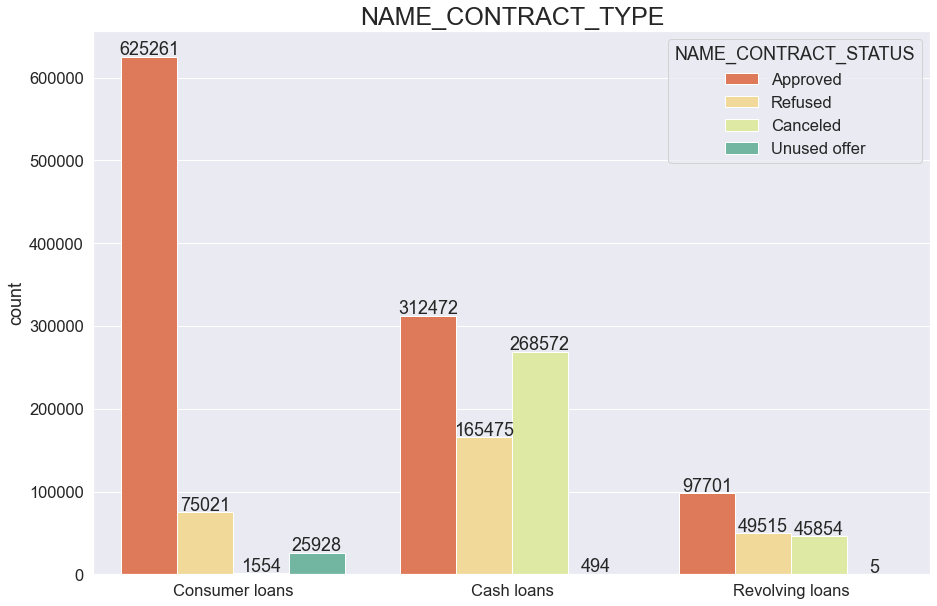

In [229]:
categorical_countplot_prev('NAME_CONTRACT_TYPE')

In [230]:
calc_status_percent('NAME_CONTRACT_TYPE')

Cash loans        22.151556
Consumer loans    10.308424
Revolving loans   25.645475
Name: NAME_CONTRACT_TYPE, dtype: float64

In [231]:
calc_status_percent('NAME_CONTRACT_TYPE', 'Approved')

Cash loans        41.829526
Consumer loans    85.915352
Revolving loans   50.602616
Name: NAME_CONTRACT_TYPE, dtype: float64

# Insight
<hr>

* <b><i>Revolving loans</i></b> have highest percentage of refusals (>25%)<br><br>

* <b><i>Cash loans</i></b> also have a very high refusal rate 2nd to revolving loans (>22%)<br><br>

* <b><i>Consumer loans</i></b> have the least percentage of refusal rate (<11%)<br><br>

* <b><i>Cash loans</i></b> have highest cancellation percentage (>35%) followed by <b><i>Revolving loans</i></b> having cancelation percentage >23%<br><br>

* <b><i>Consumer loans</i></b> are the least cancelled loans with cancelation percentage less than 1%  

###### NAME_CASH_LOAN_PURPOSE'

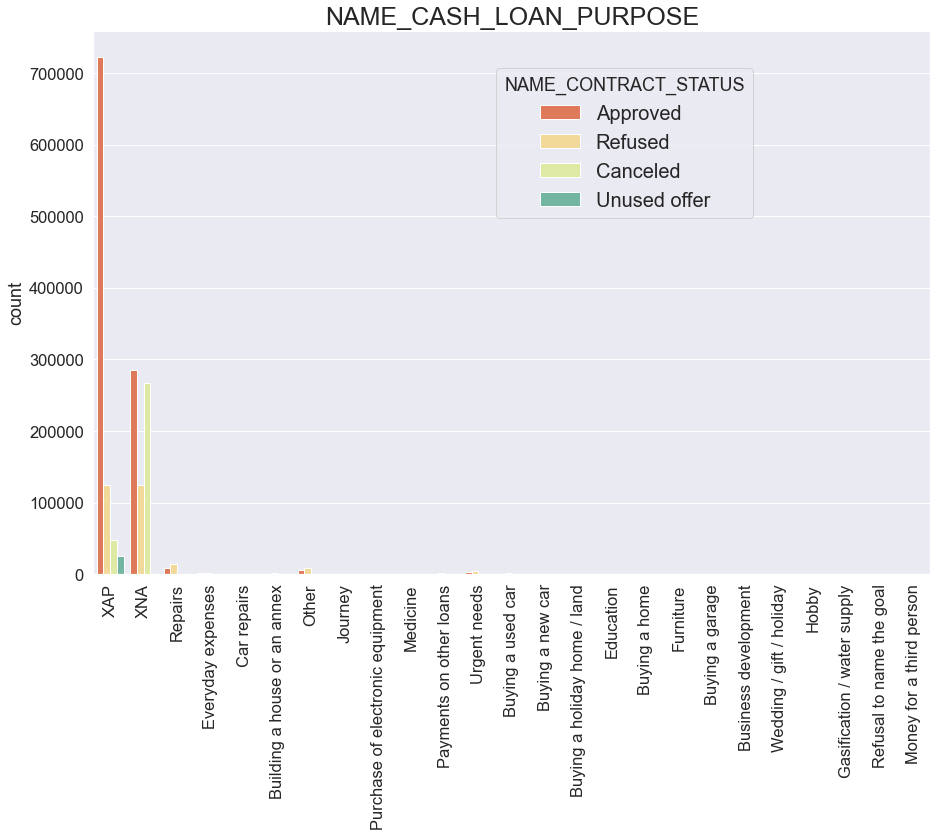

In [232]:
categorical_countplot_prev('NAME_CASH_LOAN_PURPOSE',False)
plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=[0.8,0.95], prop={'size':20}).set_title('NAME_CONTRACT_STATUS')
plt.show()

#### Creting a variable containing NAME_CASH_LOAN_PURPOSE column but without the values 'XNA' and 'XAP'

In [233]:
a = prev_application[-prev_application.NAME_CASH_LOAN_PURPOSE.isin(['XNA','XAP'])].NAME_CASH_LOAN_PURPOSE

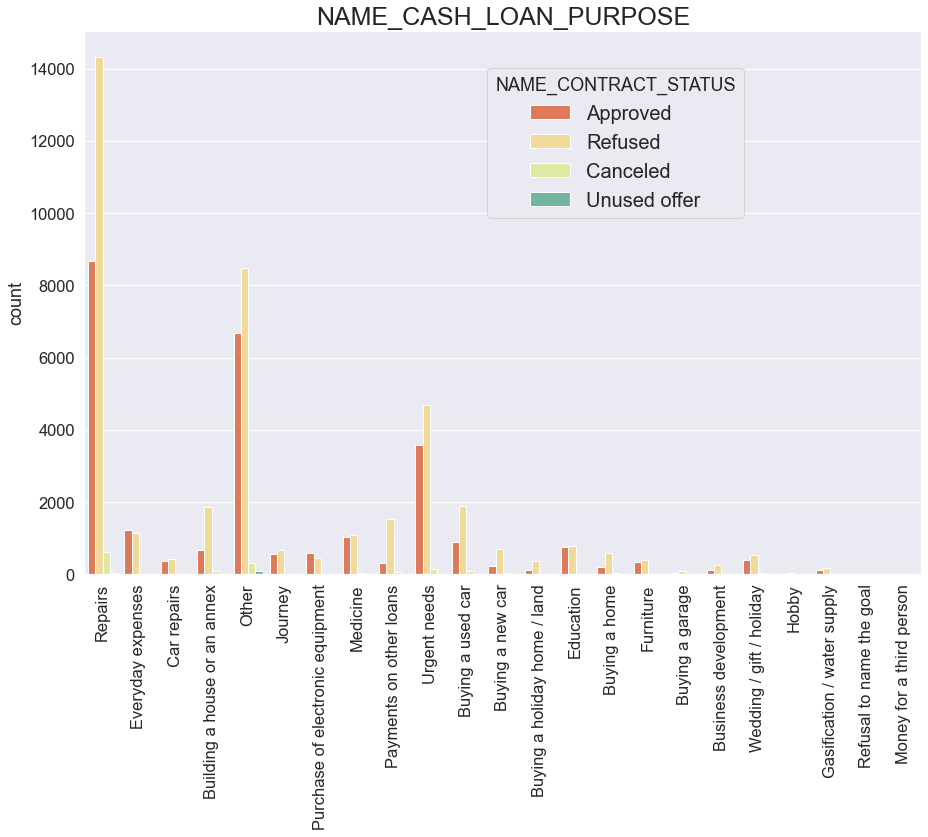

In [234]:
# plotting the graph for all categories in NAME_CASH_LOAN_PURPOSE except 'XNA' and 'XAP' 
plt.figure(figsize=[15,10])
splot = sns.countplot(a, hue=prev_application.NAME_CONTRACT_STATUS, palette='Spectral') # segmenting bars wrt NAME_CONTRACT_STATUS    
plt.xlabel(None)
plt.title('NAME_CASH_LOAN_PURPOSE', fontdict={'fontsize':25})
plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=[0.8,0.95], prop={'size':20}).set_title('NAME_CONTRACT_STATUS')
plt.show()

In [235]:
calc_status_percent('NAME_CASH_LOAN_PURPOSE')

Building a house or an annex       70.931113
Business development               64.523810
Buying a garage                    64.925373
Buying a holiday home / land       71.098266
Buying a home                      71.859903
Buying a new car                   72.142857
Buying a used car                  65.554397
Car repairs                        52.948557
Education                          49.713922
Everyday expenses                  47.431649
Furniture                          53.004005
Gasification / water supply        60.000000
Hobby                              66.666667
Journey                            53.268765
Medicine                           50.551978
Money for a third person           52.000000
Other                              54.493480
Payments on other loans            80.334728
Purchase of electronic equipment   43.437205
Refusal to name the goal           73.333333
Repairs                            60.557786
Urgent needs                       55.745896
Wedding / 

# Insight
<hr>

* NAME_CASH_LOAN_PURPOSE have huge amount of unknown values<br><br>

* Other than XNA and XAP all other categories in NAME_CASH_LOAN_PURPOSE though significantly less in numbers have more than 55 % loans refused

###### CODE_REJECT_REASON

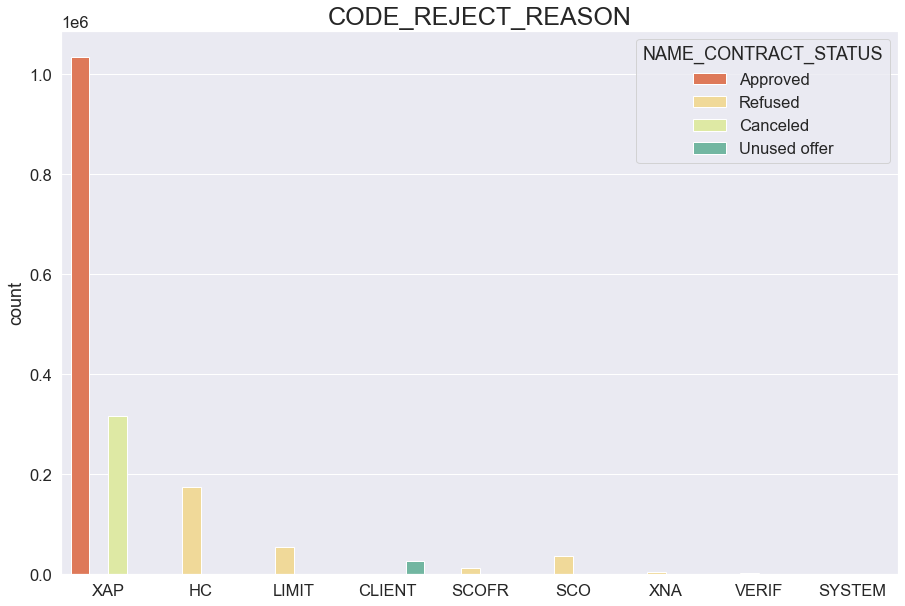

In [236]:
categorical_countplot_prev('CODE_REJECT_REASON',False)

In [237]:
calc_status_percent('CODE_REJECT_REASON')

CLIENT          NaN
HC       100.000000
LIMIT    100.000000
SCO      100.000000
SCOFR    100.000000
SYSTEM   100.000000
VERIF    100.000000
XAP        0.000074
XNA       99.847357
Name: CODE_REJECT_REASON, dtype: float64

# Insight
<hr>

* The top 3 reasons for a loan getting rejected are <b><i>HC</i></b> then <b><i>LIMIT</i></b> and then <b><i>SCO</i></b

###### NAME_CLIENT_TYPE

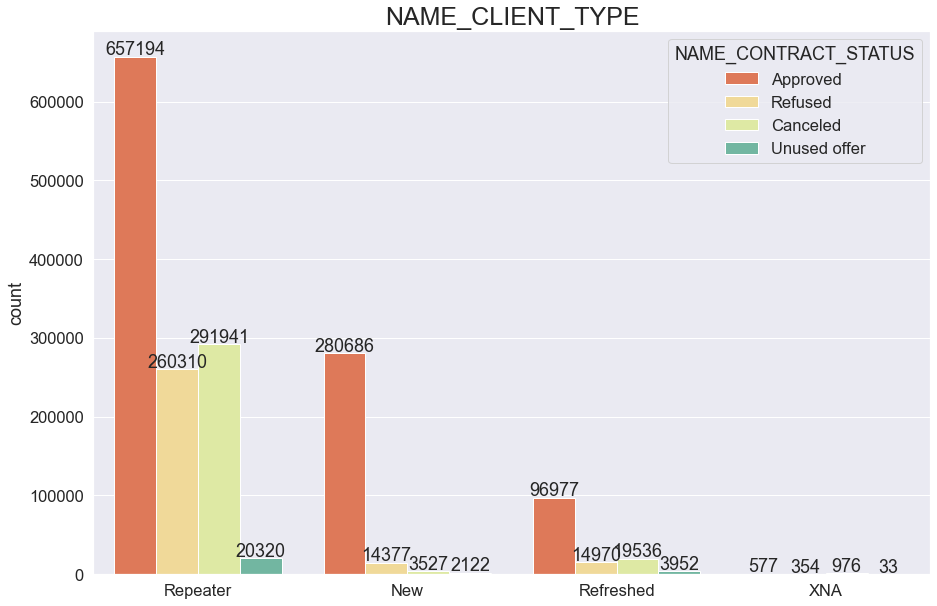

In [238]:
categorical_countplot_prev('NAME_CLIENT_TYPE')

In [239]:
calc_status_percent('NAME_CLIENT_TYPE')     #refused

New          4.780986
Refreshed   11.053273
Repeater    21.167459
XNA         18.247423
Name: NAME_CLIENT_TYPE, dtype: float64

In [240]:
calc_status_percent('NAME_CLIENT_TYPE', 'Approved')

Repeater    53.440617
New         93.340472
Refreshed   71.604091
XNA         29.742268
Name: NAME_CLIENT_TYPE, dtype: float64

In [241]:
calc_status_percent('NAME_CLIENT_TYPE','Canceled')

New          1.172883
Refreshed   14.424632
Repeater    23.739576
XNA         50.309278
Name: NAME_CLIENT_TYPE, dtype: float64

# Insight
<hr>

* The top most client type for loan to be refused is <b><i>Repeater</i></b> with greater 21% refusal percentage

* New clients have the least probability of loan refusal (less than 5%) and most probabilty of loan getting approved (greater than 93%)

###### NAME_GOODS_CATEGORY

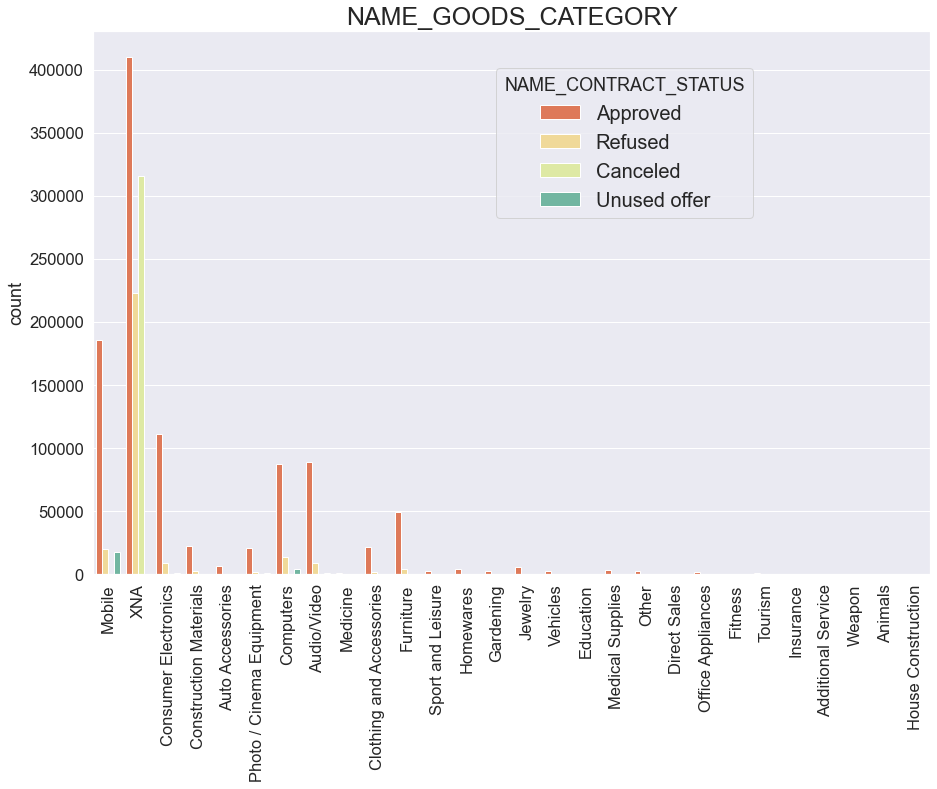

In [242]:
categorical_countplot_prev('NAME_GOODS_CATEGORY',False)
plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=[0.8,0.95], prop={'size':20}).set_title('NAME_CONTRACT_STATUS')
plt.show()

In [243]:
calc_status_percent('NAME_GOODS_CATEGORY').sort_values()   # refused

Fitness                      0.956938
Other                        4.776821
Medicine                     6.580645
Gardening                    7.110609
Consumer Electronics         7.491341
Medical Supplies             7.832423
Furniture                    8.085233
Sport and Leisure            8.392078
Clothing and Accessories     8.533945
Weapon                       9.090909
Photo / Cinema Equipment     9.109482
Mobile                       9.111709
Audio/Video                  9.125736
Auto Accessories             9.189482
Homewares                    9.288419
Additional Service           9.375000
Jewelry                      9.443561
Construction Materials       9.763434
Office Appliances           10.291595
Vehicles                    10.837292
Tourism                     11.512960
Computers                   12.784505
Education                   14.953271
Insurance                   15.625000
Direct Sales                16.367713
XNA                         23.507407
House Constr

# Insight
<hr>

* Other than XNA <b><i>Direct sales</i></b>(>16%), <b><i>Insuarance</i></b>(>15%) and <b><i>Education</i></b>(>14%) are the categories having most percentage of loans getting refused

###### NAME_PRODUCT_TYPE

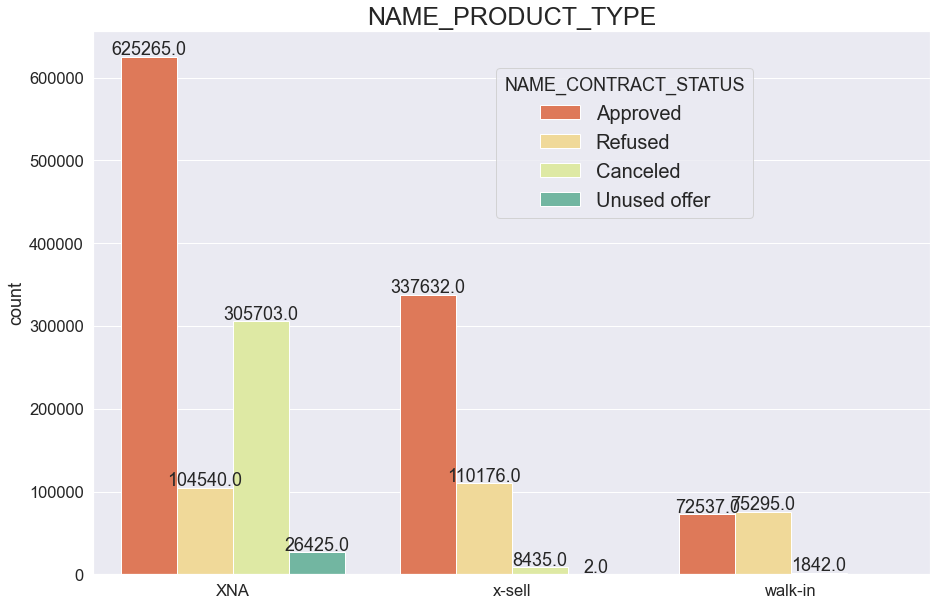

In [244]:
categorical_countplot_prev('NAME_PRODUCT_TYPE')
plt.legend(bbox_to_anchor=[0.8,0.95], prop={'size':20}).set_title('NAME_CONTRACT_STATUS')

In [245]:
calc_status_percent('NAME_PRODUCT_TYPE')

XNA        9.844312
walk-in   50.305998
x-sell    24.148429
Name: NAME_PRODUCT_TYPE, dtype: float64

# Insight
<hr>

* Previous applications which are <b><i>walk in</i></b> have a 50% chance of loan getting refused while <b><i>x-sell</i></b> only has 25%

###### CHANNEL_TYPE

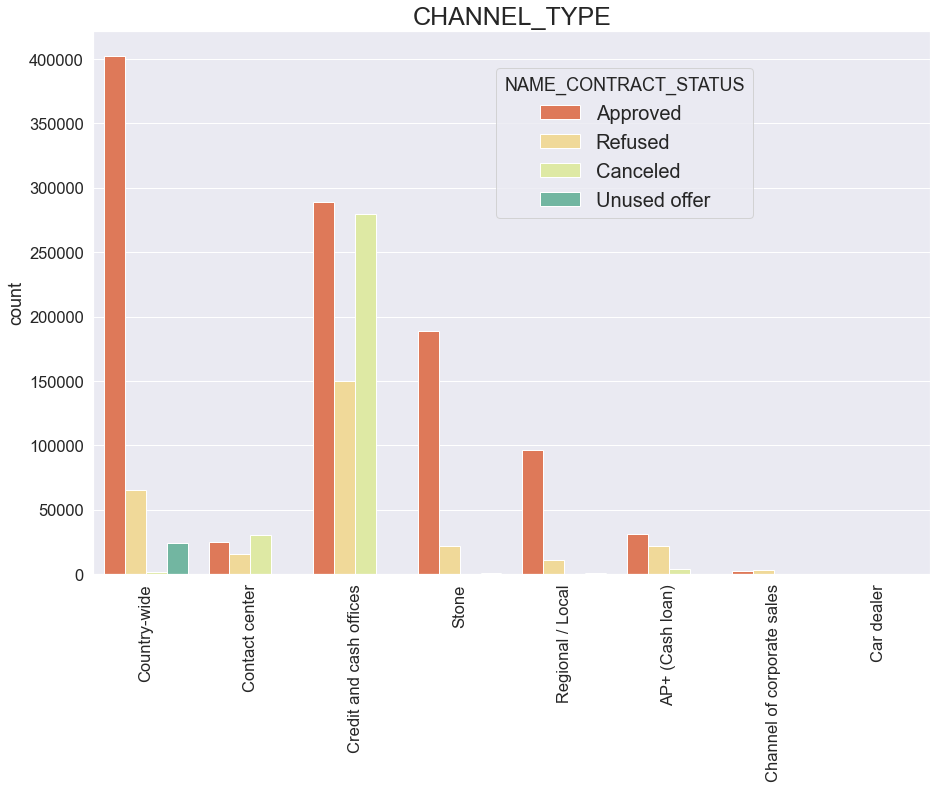

In [246]:
categorical_countplot_prev('CHANNEL_TYPE',False)
plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=[0.8,0.95], prop={'size':20}).set_title('NAME_CONTRACT_STATUS')
plt.show()

In [247]:
calc_status_percent('CHANNEL_TYPE')

AP+ (Cash loan)              38.679444
Car dealer                   26.405868
Channel of corporate sales   54.249012
Contact center               21.832922
Country-wide                 13.297750
Credit and cash offices      20.865863
Regional / Local             10.434390
Stone                        10.361052
Name: CHANNEL_TYPE, dtype: float64

# Insight
<hr>

* The top three channel types hvaing highest percentages of loans getting refused are <b><i>Channel of corporate sales</i></b>(>54%), <b><i>AP+ (Cash loan)</i></b>(>38%) and <b><i>Car dealer</i></b>(>26%)

###### AMT_ANNUITY_RANGE

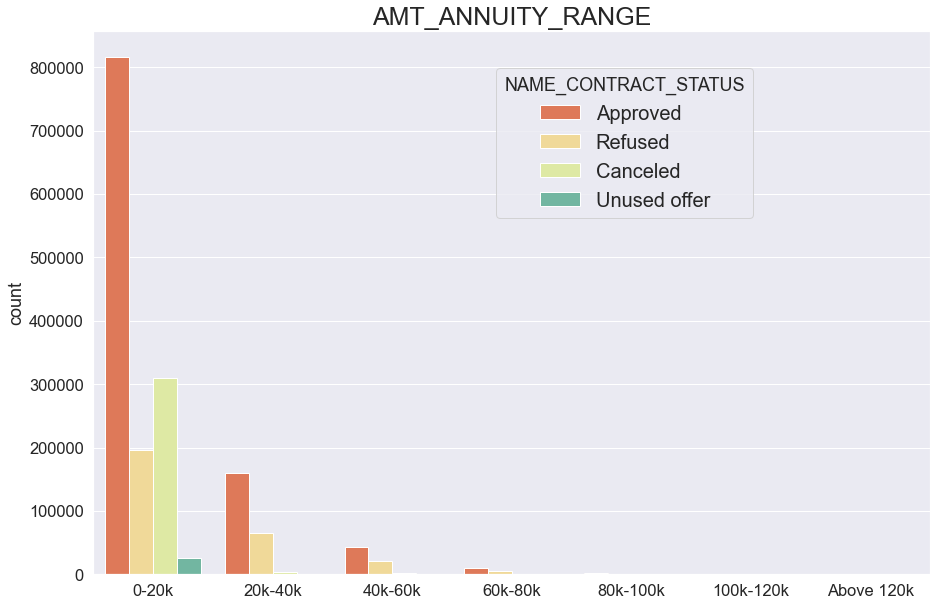

In [248]:
categorical_countplot_prev('AMT_ANNUITY_RANGE',False)
plt.legend(bbox_to_anchor=[0.8,0.95], prop={'size':20}).set_title('NAME_CONTRACT_STATUS')

In [249]:
calc_status_percent('AMT_ANNUITY_RANGE')

0-20k        14.562793
20k-40k      28.497132
40k-60k      32.663883
60k-80k      31.914612
80k-100k     25.450335
100k-120k    23.859387
Above 120k   28.559103
Name: AMT_ANNUITY_RANGE, dtype: float64

In [250]:
calc_status_percent('AMT_ANNUITY_RANGE', 'Approved')

0-20k        60.554416
20k-40k      69.588113
40k-60k      64.576540
60k-80k      65.137797
80k-100k     71.873392
100k-120k    74.345550
Above 120k   69.025022
Name: AMT_ANNUITY_RANGE, dtype: float64

In [251]:
calc_status_percent('AMT_ANNUITY_RANGE', 'Canceled')

0-20k        22.923888
20k-40k       1.912148
40k-60k       2.759577
60k-80k       2.947591
80k-100k      2.676274
100k-120k     1.795064
Above 120k    2.415876
Name: AMT_ANNUITY_RANGE, dtype: float64

# Insight
<hr>

* For AMT_ANNUITY between 0-20K, the percentage of loans refusal is lowest (less than 15%)

* Mid-range ANNUITY (between 40K-80K) has the highest loan refusal percentage

* 0-20k AMT_ANNUITY range also has the most percentage of loans getting cancelled

# Inference
<hr>

* As the AMT_ANNUITY increases the probability of loans getting approved increase

###### AMT_GOODS_PRICE_RANGE

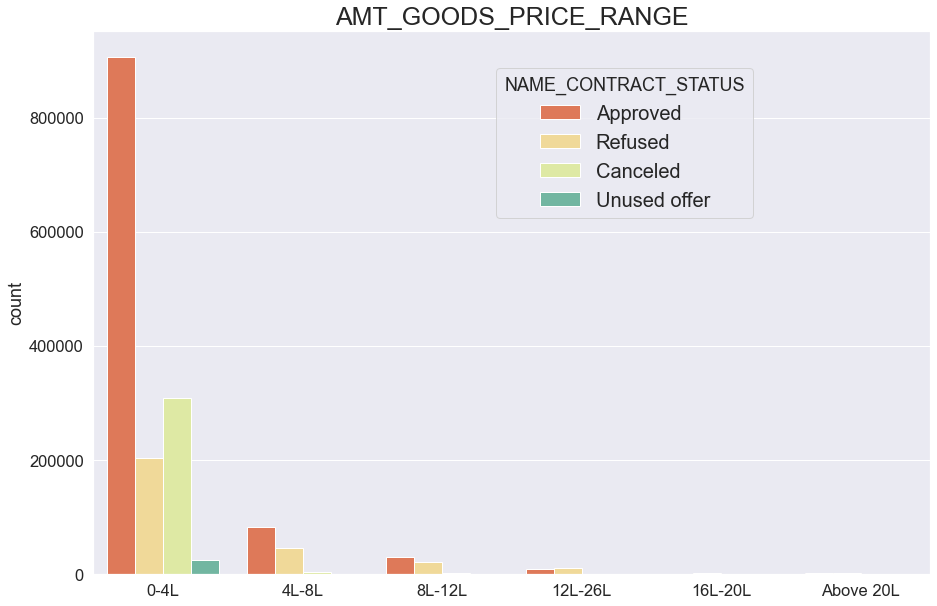

In [252]:
categorical_countplot_prev('AMT_GOODS_PRICE_RANGE',False)
plt.legend(bbox_to_anchor=[0.8,0.95], prop={'size':20}).set_title('NAME_CONTRACT_STATUS')

In [253]:
calc_status_percent('AMT_GOODS_PRICE_RANGE')

0-4L        14.092125
4L-8L       34.290945
8L-12L      40.179134
12L-26L     48.507393
16L-20L     63.180581
Above 20L   59.482139
Name: AMT_GOODS_PRICE_RANGE, dtype: float64

In [254]:
calc_status_percent('AMT_GOODS_PRICE_RANGE', 'Approved')

0-4L        62.759072
4L-8L       62.788203
8L-12L      56.310754
12L-26L     46.331256
16L-20L     31.442831
Above 20L   33.972668
Name: AMT_GOODS_PRICE_RANGE, dtype: float64

# Inference
<hr>

* As the price of goods increases the proabability of loan getting rejected increases and loan getting approved decreases

###### AMT_CREDIT_RANGE

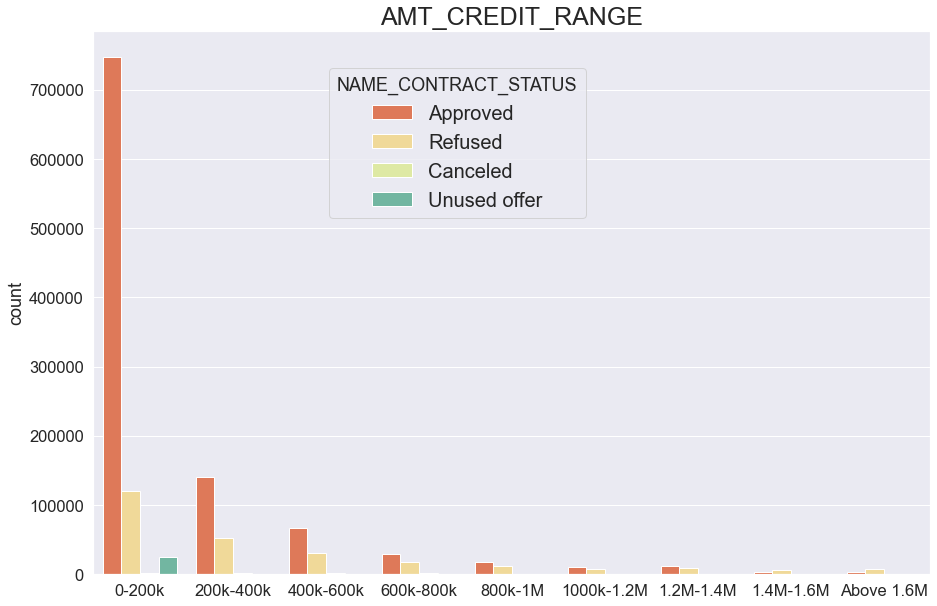

In [255]:
categorical_countplot_prev('AMT_CREDIT_RANGE',False)
plt.legend(bbox_to_anchor=[0.6,0.95], prop={'size':20}).set_title('NAME_CONTRACT_STATUS')

In [256]:
calc_status_percent('AMT_CREDIT_RANGE')

0-200k       13.373579
200k-400k    26.643273
400k-600k    30.700636
600k-800k    35.615591
800k-1M      37.802840
1.2M-1.4M    39.334541
1000k-1.2M   41.919751
Above 1.6M   62.675931
1.4M-1.6M    58.737514
Name: AMT_CREDIT_RANGE, dtype: float64

In [257]:
calc_status_percent('AMT_CREDIT_RANGE', 'Approved')

0-200k       83.610490
200k-400k    72.226960
400k-600k    66.810938
600k-800k    61.748814
800k-1M      58.961506
1.2M-1.4M    56.478044
1000k-1.2M   54.188455
Above 1.6M   32.059505
1.4M-1.6M    36.844815
Name: AMT_CREDIT_RANGE, dtype: float64

# Inference
<hr>

* As the credit range increases the proabability of loan getting rejected increases and loan getting approved decreases

###### defining a function which plots distplot for the given loan status for the columns AMT_APPLICATION, AMT_CREDIT, AMT_ANNUITY and AMT_GOODS_PRICE¶

In [258]:
def distplot_for_status(status):
    plt.figure(figsize=(20,16))

    for i,j in zip(range(1,5),['AMT_APPLICATION','AMT_CREDIT','AMT_ANNUITY', 'AMT_GOODS_PRICE']):
        plt.subplot(2,2,i)
        sns.distplot( prev_application[ prev_application.NAME_CONTRACT_STATUS == status ][j], hist=False, color='r', hist_kws={'width':10})  
        plt.title(j+f'({status})', fontdict={'fontsize' : 25, 'fontweight' : 5, 'color' : [0.6,0.3,0.5]})

    plt.show()

###### ploting segmented distplots for AMT_APPLICATION,AMT_CREDIT,AMT_ANNUITY, AMT_GOODS_PRICE

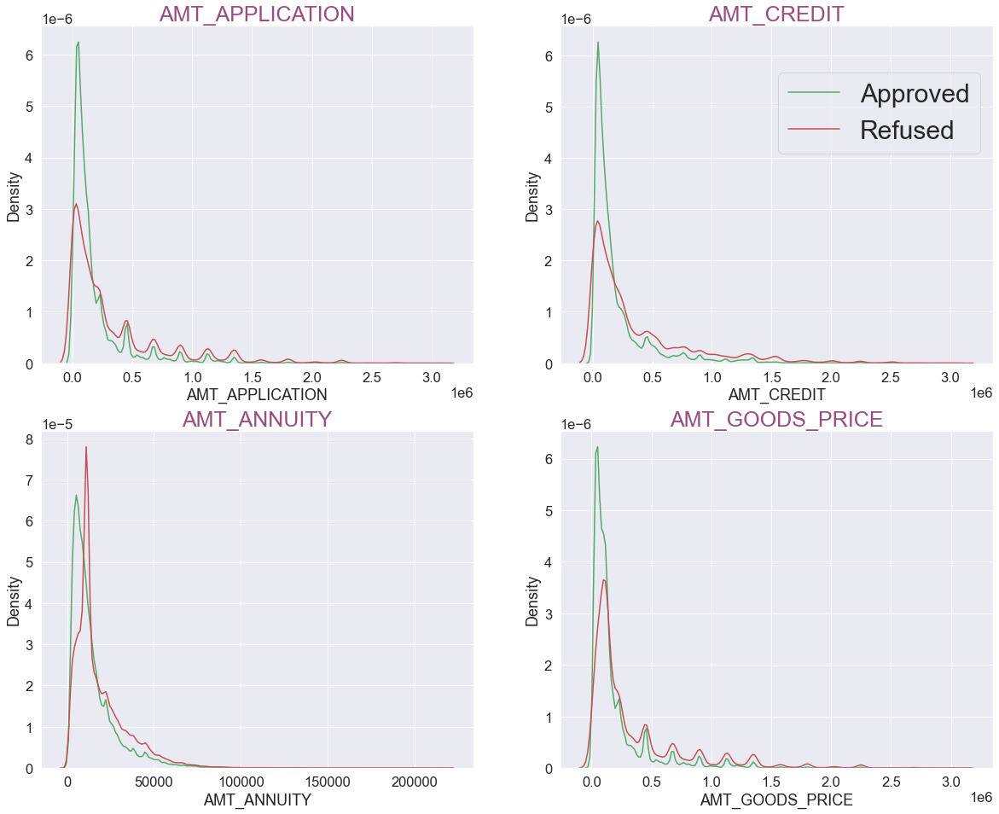

In [259]:
fig = plt.figure(figsize=(20,16))


for i,j in zip(range(1,5),[ 'AMT_APPLICATION','AMT_CREDIT','AMT_ANNUITY', 'AMT_GOODS_PRICE']):
    plt.subplot(2,2,i)
    sns.distplot(prev_application[ prev_application.NAME_CONTRACT_STATUS == 'Approved'][j], hist=False, color='g',label ="Approved", hist_kws={'width':10})
    sns.distplot(prev_application[ prev_application.NAME_CONTRACT_STATUS == 'Refused'][j], hist=False, color='r', label ='Refused')
    plt.title(j, fontdict={'fontsize' : 25, 'fontweight' : 5, 'color' : [0.6,0.3,0.5]})

plt.legend(bbox_to_anchor=[1,2.1], prop={'size':30})
plt.show()

# Insight
<hr>

* For AMT_APPLICATION, AMT_CEDIT and AMT_GOODS_PRICE being less than 250k the frequency of loan applications getting approved is much higher than that of loan applications getting refused<br><br>

* For AMT_ANNUITY being less than 20k the frequency of loan applications getting approved is higher but above 20k the frequncy of loans getting refused stays above loan application approved frequency

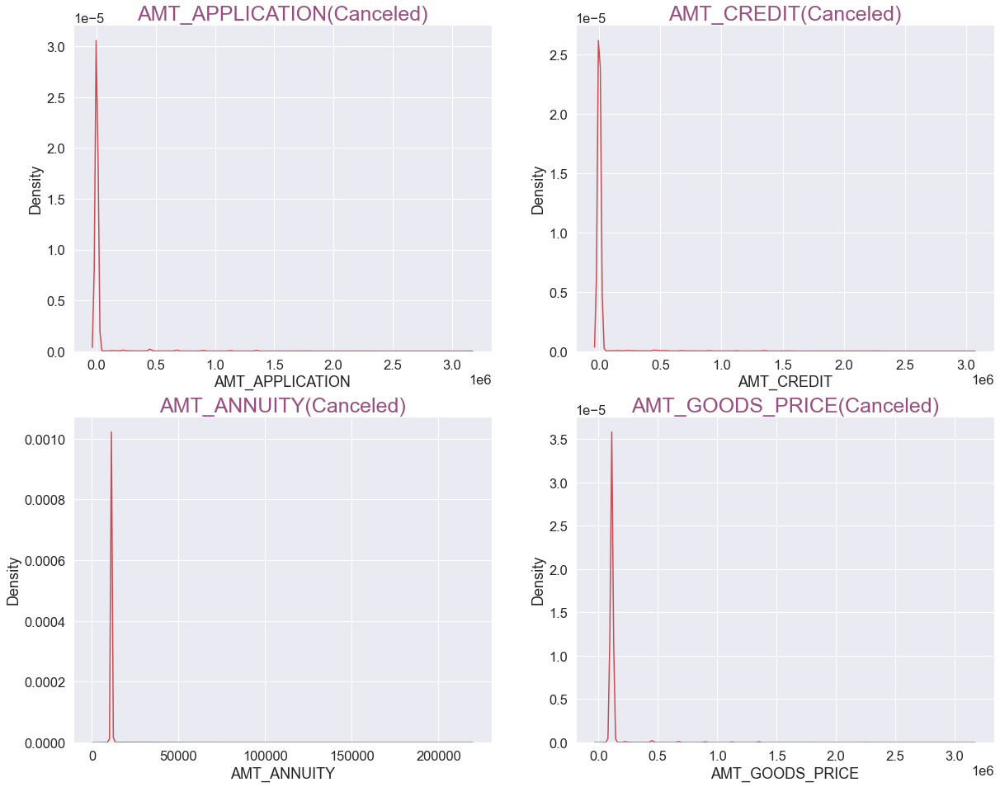

In [260]:
distplot_for_status('Canceled')

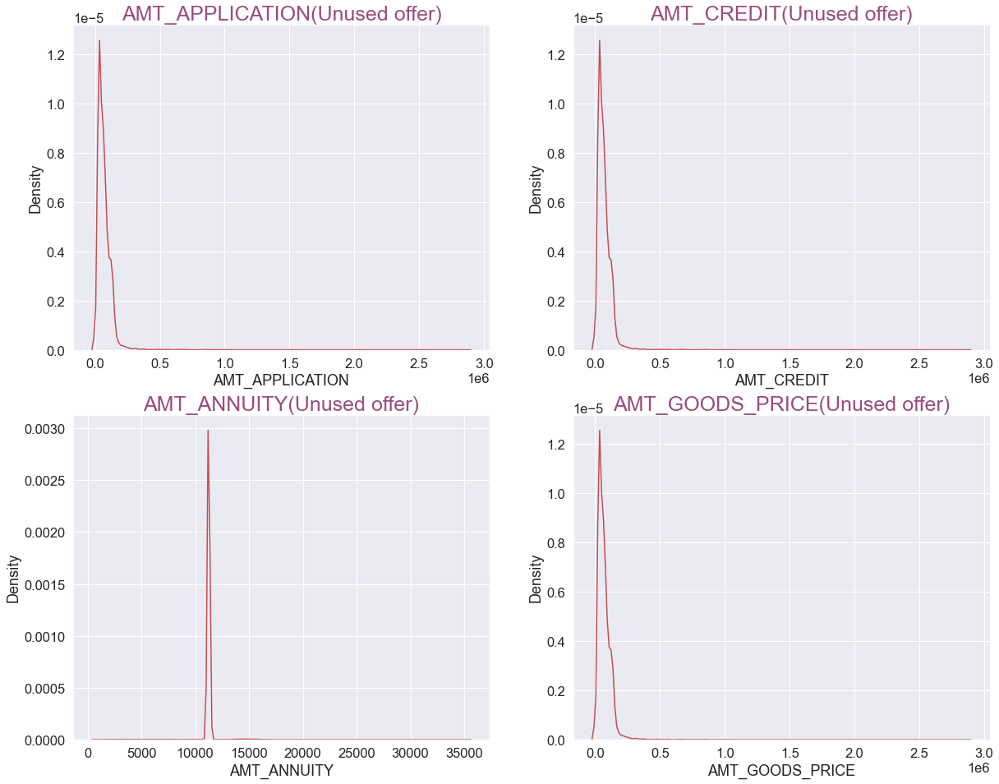

In [261]:
distplot_for_status('Unused offer')

# Insight
<hr>

* For NAME_CONTRACT_STATUS being <b><i>Unused offer</i></b> majority of application amount is less than 250k, where credit amount is less than 250k and for status being <b><i>Canceled</i></b> majority of application amount and credit amount is close to 0<br><br> 

* While for <b><i>Unused offer</i></b> majority of AMT_ANNUITY is between 10k and 12k and majority of AMT_GOODS_PRICE is less than 250k and for <b><i>Canceled</i></b>  AMT_ANNUITY is between 0 and 20k and AMT_GOODS_PRICE is between 0 to 250k

###### Plotting heatmap for prev_application 

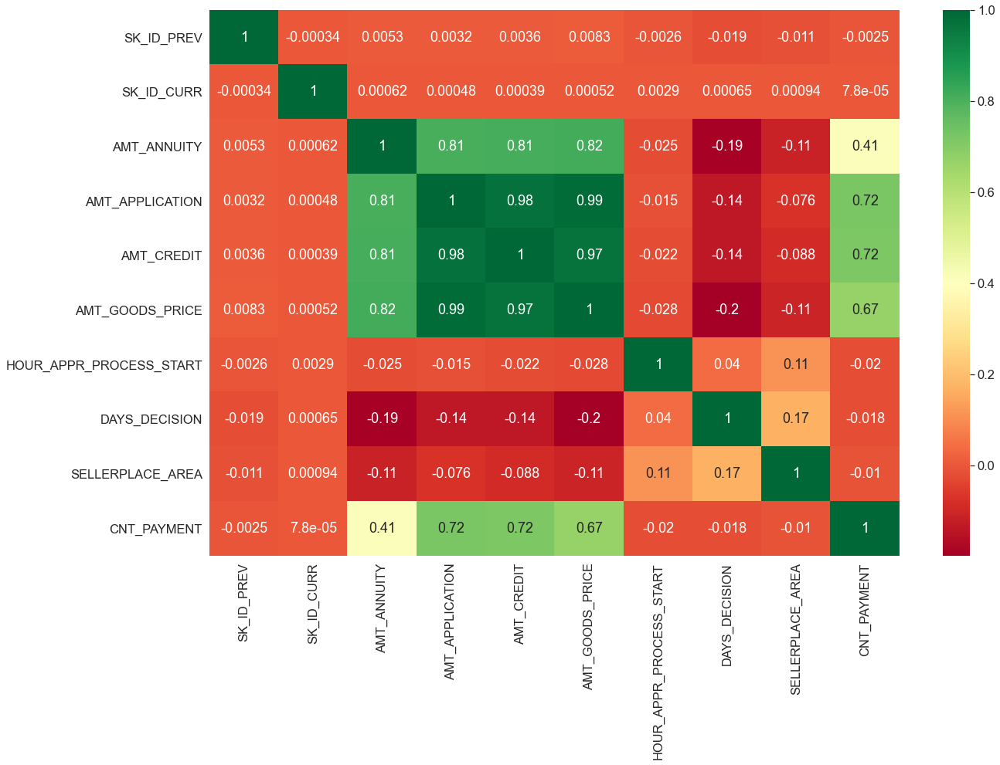

In [262]:
plt.figure(figsize=[20,13])
sns.heatmap(prev_application.corr(), annot=True, cmap='RdYlGn')
plt.show()

###### Plotting heatmap for prev_application; loan status- approved

In [263]:
prev_application.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'FLAG_LAST_APPL_PER_CONTRACT', 'NFLAG_LAST_APPL_IN_DAY',
       'NAME_CASH_LOAN_PURPOSE', 'NAME_CONTRACT_STATUS', 'DAYS_DECISION',
       'NAME_PAYMENT_TYPE', 'CODE_REJECT_REASON', 'NAME_CLIENT_TYPE',
       'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',
       'CHANNEL_TYPE', 'SELLERPLACE_AREA', 'NAME_SELLER_INDUSTRY',
       'CNT_PAYMENT', 'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
       'AMT_ANNUITY_RANGE', 'AMT_GOODS_PRICE_RANGE', 'AMT_CREDIT_RANGE'],
      dtype='object')

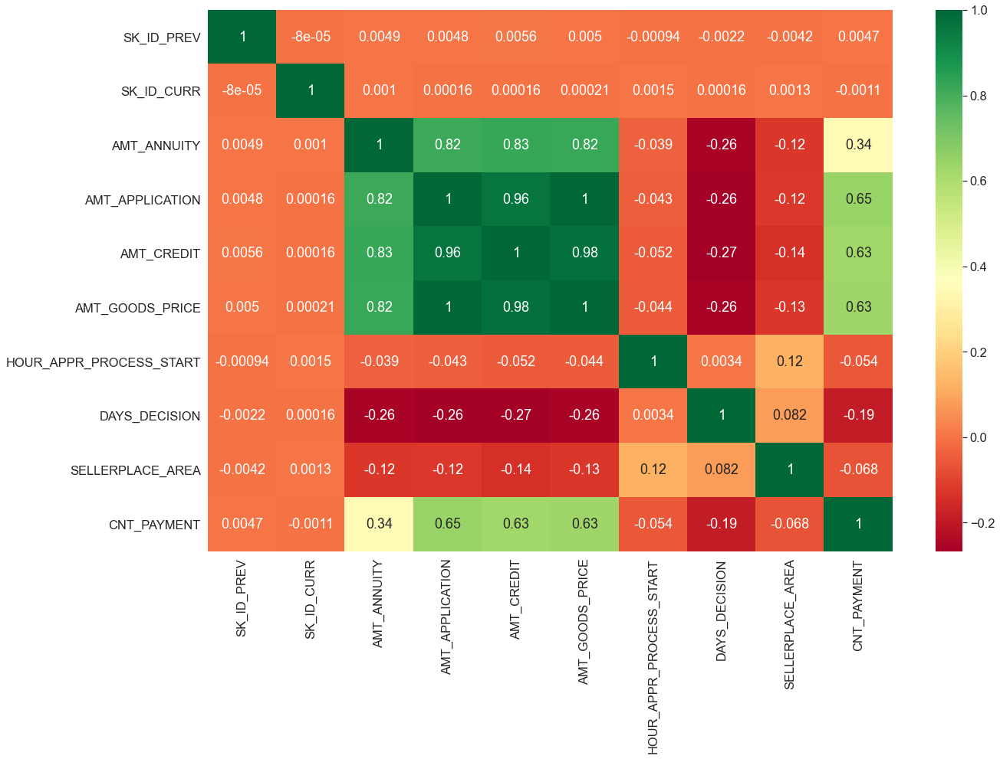

In [264]:
plt.figure(figsize=[20,13])
sns.heatmap(prev_application[prev_application.NAME_CONTRACT_STATUS=='Approved'].corr(), annot=True, cmap='RdYlGn')
plt.show()

###### Plotting heatmap for prev_application; loan status- refused

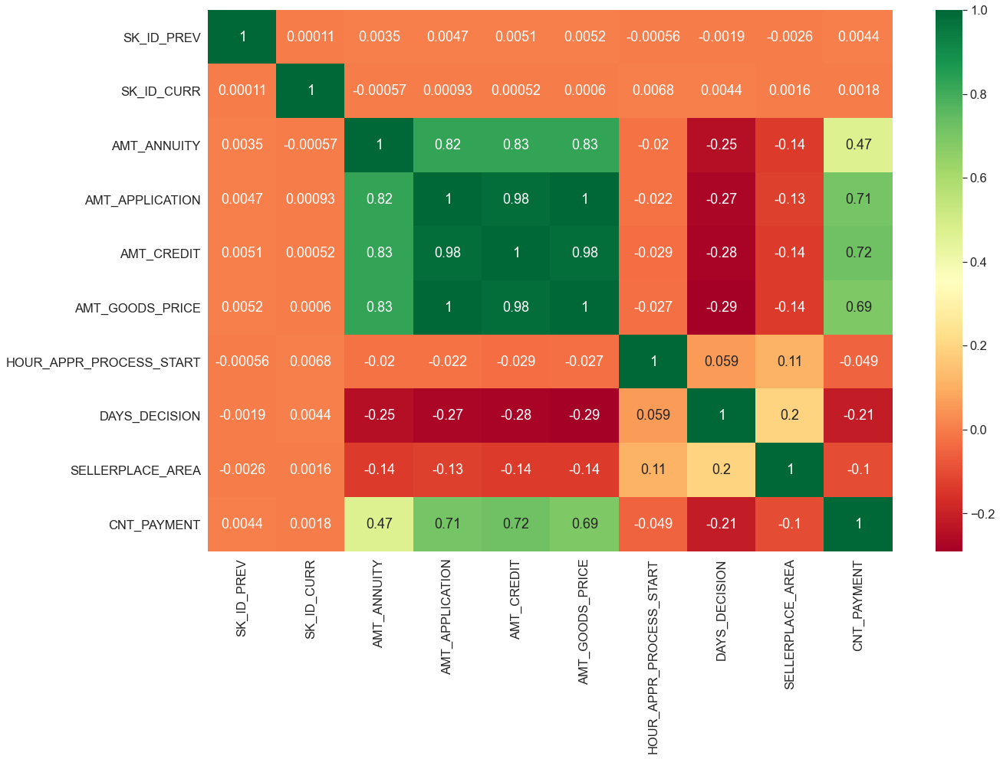

In [265]:
plt.figure(figsize=[20,13])
sns.heatmap(prev_application[prev_application.NAME_CONTRACT_STATUS=='Refused'].corr(), annot=True, cmap='RdYlGn')
plt.show()

# Insight
<hr>

* AMT_CREDIT, AMT_APPLICATION and AMT_GOODS_PRICE have very high positive correlation with each other<br><br>

* AMT_ANNUITY has high correlation with AMT_GOODS_PRICE(0.82), AMT_CREDIT(0.81) and AMT_APPLICATION(0.81)<br><br>

* CNT_PAYMENT has moderately high correlation with AMT_APPLICATION(0.72), AMT_CREDIT(0.72) amd AMT_GOODS_PRICE(0.67)

# Merged dataset analysis

In [266]:
merged_df = pd.merge(application, prev_application, on='SK_ID_CURR', how='inner')  # merging application and prev_application datasets and storing it in a variable merged_df           

In [267]:
merged_df.shape #checking shape of merged_df

(1411194, 86)

In [268]:
merged_df.info()      #checking summary

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1411194 entries, 0 to 1411193
Data columns (total 86 columns):
 #   Column                        Non-Null Count    Dtype   
---  ------                        --------------    -----   
 0   SK_ID_CURR                    1411194 non-null  int64   
 1   TARGET                        1411194 non-null  int64   
 2   NAME_CONTRACT_TYPE_x          1411194 non-null  object  
 3   CODE_GENDER                   1411194 non-null  object  
 4   FLAG_OWN_CAR                  1411194 non-null  object  
 5   FLAG_OWN_REALTY               1411194 non-null  object  
 6   CNT_CHILDREN                  1411194 non-null  int64   
 7   AMT_INCOME_TOTAL              1411194 non-null  float64 
 8   AMT_CREDIT_x                  1411194 non-null  float64 
 9   AMT_ANNUITY_x                 1411194 non-null  float64 
 10  AMT_GOODS_PRICE_x             1411194 non-null  float64 
 11  NAME_TYPE_SUITE               1411194 non-null  object  
 12  NAME_INCOME_TY

In [269]:
merged_df.dtypes  

SK_ID_CURR                         int64
TARGET                             int64
NAME_CONTRACT_TYPE_x              object
CODE_GENDER                       object
FLAG_OWN_CAR                      object
FLAG_OWN_REALTY                   object
CNT_CHILDREN                       int64
AMT_INCOME_TOTAL                 float64
AMT_CREDIT_x                     float64
AMT_ANNUITY_x                    float64
AMT_GOODS_PRICE_x                float64
NAME_TYPE_SUITE                   object
NAME_INCOME_TYPE                  object
NAME_EDUCATION_TYPE               object
NAME_FAMILY_STATUS                object
NAME_HOUSING_TYPE                 object
REGION_POPULATION_RELATIVE       float64
DAYS_BIRTH                         int64
DAYS_EMPLOYED                      int64
DAYS_REGISTRATION                  int64
DAYS_ID_PUBLISH                    int64
FLAG_MOBIL                      category
FLAG_EMP_PHONE                  category
FLAG_WORK_PHONE                 category
FLAG_CONT_MOBILE

In [270]:
merged_df.isnull().sum()    #checking null values

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE_x                 0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT_x                         0
AMT_ANNUITY_x                        0
AMT_GOODS_PRICE_x                    0
NAME_TYPE_SUITE                      0
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE                     0
FLAG_PHONE               

In [271]:
merged_df.describe()   #checking statistical data for numeric columns

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_x,AMT_ANNUITY_x,AMT_GOODS_PRICE_x,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START_x,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,SK_ID_PREV,AMT_ANNUITY_y,AMT_APPLICATION,AMT_CREDIT_y,AMT_GOODS_PRICE_y,HOUR_APPR_PROCESS_START_y,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT
count,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000,1411194.000000
mean,278481.932055,0.086527,0.404890,172522.656992,586983.918754,26990.247784,527080.644532,0.020752,16322.013990,72705.274310,5004.185464,3034.807931,2.150444,11.984284,1.540621,0.153700,1.522804,0.107787,1084.683072,0.005482,0.006023,0.034121,0.266421,0.319797,2.576302,1922771.047497,14804.587836,174175.958428,195259.396159,199598.837692,12.478468,880.404059,265.458914,12.550670
std,102811.588762,0.281141,0.717344,89211.278799,383773.350956,13864.056841,351997.780736,0.013343,4344.875363,143369.634499,3551.260016,1507.310698,0.900678,3.232541,2.529255,0.465440,2.507502,0.378649,799.940831,0.076966,0.100191,0.201357,0.926937,0.878527,2.269149,532718.324660,13007.029016,288261.023715,314091.196763,276525.189892,3.331997,783.755615,782.878926,14.471779
min,100002.000000,0.000000,0.000000,25650.000000,45000.000000,1615.500000,40500.000000,0.000290,7489.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1000001.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,-1.000000,0.000000
25%,189363.000000,0.000000,0.000000,112500.000000,270000.000000,16807.500000,238500.000000,0.010032,12739.000000,1042.000000,2002.000000,1783.000000,2.000000,10.000000,0.000000,0.000000,0.000000,0.000000,396.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1461362.250000,7402.961250,19719.000000,24858.000000,66304.350000,10.000000,271.000000,-1.000000,0.000000
50%,278996.500000,0.000000,0.000000,157500.000000,508495.500000,24907.500000,450000.000000,0.018850,16045.000000,2401.000000,4509.000000,3330.000000,2.000000,12.000000,0.000000,0.000000,0.000000,0.000000,1011.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,1922758.000000,11250.000000,70740.000000,80532.000000,112320.000000,12.000000,582.000000,4.000000,10.000000
75%,367553.000000,0.000000,1.000000,207000.000000,807984.000000,34510.500000,679500.000000,0.028663,19980.000000,6318.000000,7512.000000,4319.000000,3.000000,14.000000,2.000000,0.000000,2.000000,0.000000,1683.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,2384054.750000,16729.155000,180000.000000,215640.000000,180000.000000,15.000000,1314.000000,84.000000,18.000000
max,456255.000000,1.000000,19.000000,1417500.000000,2576898.000000,137844.000000,2254500.000000,0.072508,25201.000000,365243.000000,24672.000000,7197.000000,20.000000,23.000000,348.000000,34.000000,344.000000,24.000000,4292.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000,2845381.000000,219195.000000,3105000.000000,3069000.000000,3105000.000000,23.000000,2922.000000,16660.000000,84.000000


### Imbalance analysis

In [272]:
# creating a variable containg values counts for each unique value (0,1) in TARGET column
merged_imbalance = merged_df.TARGET.value_counts(normalize=True).reset_index()

In [273]:
# plotting barplot to check imbalance in dataset
px.bar(merged_imbalance, x='index',y='TARGET', color=['Non-Defaulter','Defaulter'], title='Imbalance Pecentage of TARGET variable for Merged Datasets', text=['Non-Defaulter','Defaulter'])   

In [274]:
merged_df.TARGET.value_counts(normalize=True)

0   0.913473
1   0.086527
Name: TARGET, dtype: float64

In [275]:
application.TARGET.value_counts(normalize=True)   # comparing imbalance of application df with merged_df df

0   0.919245
1   0.080755
Name: TARGET, dtype: float64

# Insight
<hr>

* There is a very slight decrease in Non_defaulter applicants

###### creating segmented dataframes wrt TARGET variable

In [276]:
merged_default = merged_df[merged_df.TARGET == 1]
merged_non_default = merged_df[merged_df.TARGET == 0]

### Defining Functions

###### defining a function for segmented univariate analysis wrt TARGET variable

In [277]:
def segmented_anlaysis_merged(col):
    plt.figure(figsize=[22,35])

    # 1st subplot plots the segmented countplot for given variable
    plt.subplot(211)
    splot = sns.countplot(data=merged_df, x=col, hue='TARGET', palette='cubehelix') 
    plt.title( str(col)+' (Non-Default/Default)', fontdict={'fontsize':30})
    plt.xlabel(None)
    plt.xticks(rotation=60)
    plt.legend(labels=['Non-Defaulter', 'Defaulter'], prop={'size':25})
    bar_annot(splot)

    # 2nd subplot plots the countplot for values in given variable corresponding to TARGET=1
    plt.subplot(212)
    splot = sns.countplot(merged_default[col], palette='magma') 
    plt.xlabel(None)
    plt.title(str(col)+' (Defaulter)', fontdict={'fontsize':30})
    plt.xticks(rotation=90, fontsize=15)
    bar_annot(splot)

    plt.show()

###### defining a function which return percentage of value_counts wrt TARGET variable for the given column

In [278]:
def calc_default_percent_merged(col_name, target=1):  # by default it caculates percentages for refused loan status
    return merged_df[merged_df['TARGET']==target][col_name].value_counts()/merged_df[col_name].value_counts()*100

### Univariate/Bivariate/Multivariate analysis

###### NAME_CONTRACT_STATUS

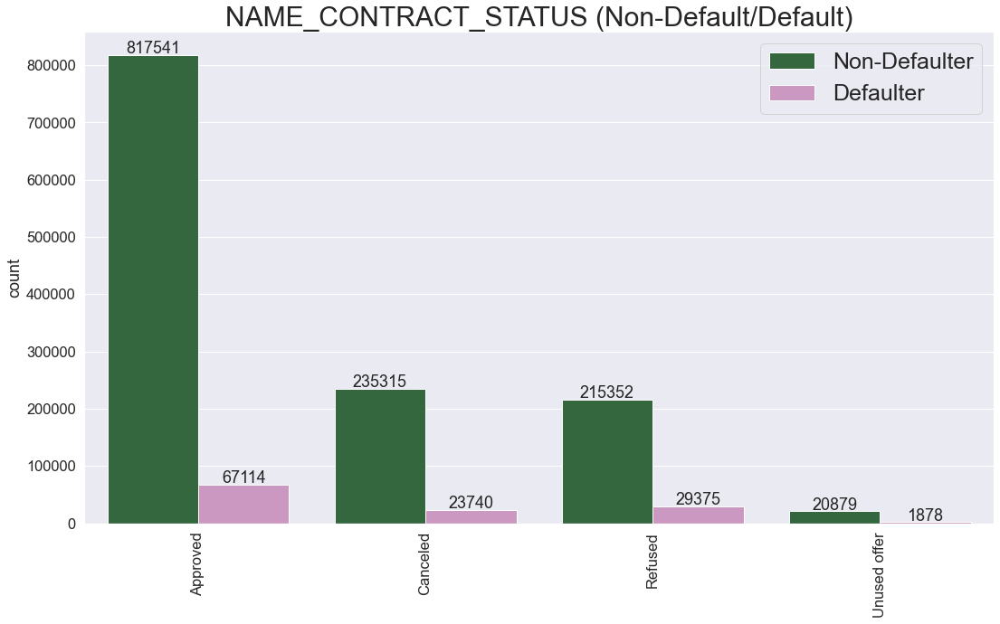

In [279]:
plt.figure(figsize=[18,10])
splot = sns.countplot(data=merged_df, x='NAME_CONTRACT_STATUS', hue='TARGET', palette='cubehelix') 
plt.title( 'NAME_CONTRACT_STATUS (Non-Default/Default)', fontdict={'fontsize':30})
plt.xlabel(None)
plt.xticks(rotation=90)
plt.legend(labels=['Non-Defaulter', 'Defaulter'], prop={'size':25})
bar_annot(splot)
plt.show()

In [280]:
calc_default_percent_merged('NAME_CONTRACT_STATUS')

Approved        7.586460
Canceled        9.164077
Refused        12.003171
Unused offer    8.252406
Name: NAME_CONTRACT_STATUS, dtype: float64

In [281]:
calc_default_percent_merged('NAME_CONTRACT_STATUS', 0)

Approved       92.413540
Canceled       90.835923
Refused        87.996829
Unused offer   91.747594
Name: NAME_CONTRACT_STATUS, dtype: float64

# Insight
<hr>

* About 90% of cancelled applications are of non-defaulting applicants<br><br>

* For defaulting applicants about 8% of total applicants who defaulted in previous loans have the loan status as approved<br><br> 

* While about 88% of the total refused loans are of non-defaulting applicants

# Inference
<hr>

* 90% of the cancelled applicants belong to non-defaulting clients, so reducing the interest rates could result in more non-defaulting applicants not cancelling the loan<br><br>

* 88% of the total refused applicants have actually repaid the loan without defaulting

###### NAME_PORTFOLIO

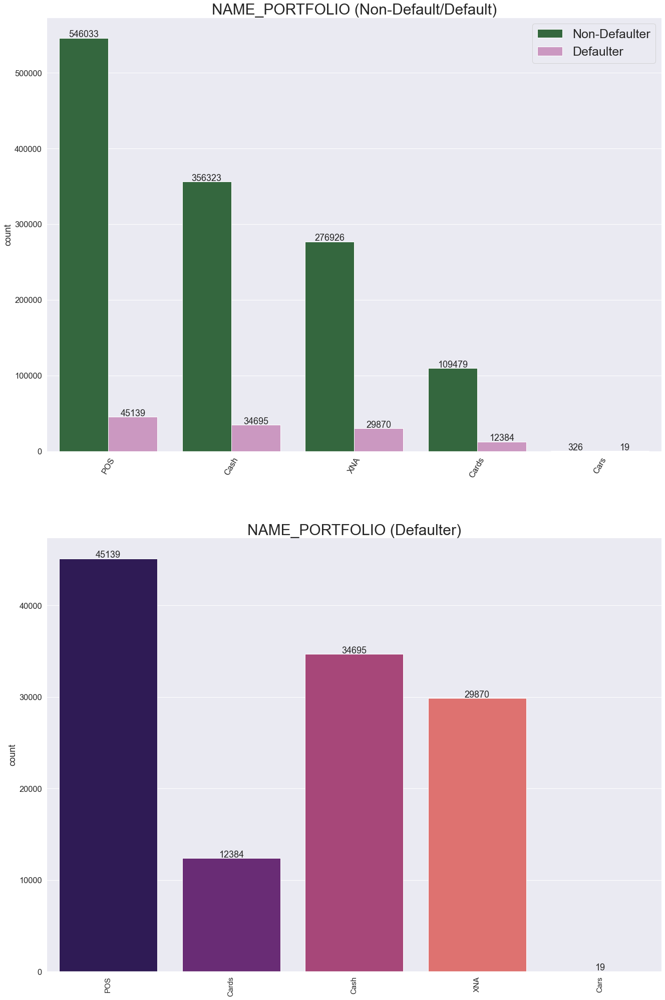

In [282]:
segmented_anlaysis_merged('NAME_PORTFOLIO')

In [283]:
calc_default_percent_merged('NAME_PORTFOLIO')

POS      7.635510
Cash     8.872993
XNA      9.736111
Cards   10.162231
Cars     5.507246
Name: NAME_PORTFOLIO, dtype: float64

In [284]:
calc_default_percent_merged('NAME_PORTFOLIO',0)

POS     92.364490
Cash    91.127007
XNA     90.263889
Cards   89.837769
Cars    94.492754
Name: NAME_PORTFOLIO, dtype: float64

# Insight
<hr>

* There are some mis-spelled entries <b><i>Cars</i></b> which are actually <b><i>Cards</i></b> but, because the number of mis-spelled entries is very very low we can leave them as it is.<br><br>

* In NAME_PORTFOLIO <b><i>Cards</i></b> have the highest percentage of defaulters<br><br>

* Also there are signigicant amount of unknown values

###### NAME_YIELD_GROUP

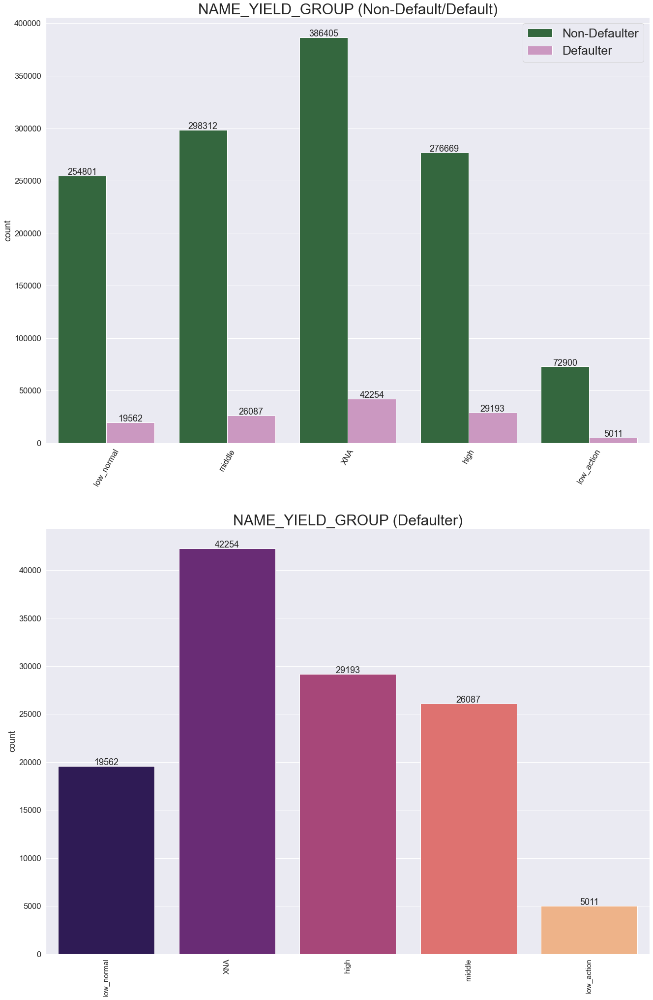

In [285]:
segmented_anlaysis_merged('NAME_YIELD_GROUP')

In [286]:
calc_default_percent_merged('NAME_YIELD_GROUP')

XNA          9.857253
high         9.544500
low_action   6.431698
low_normal   7.129970
middle       8.041640
Name: NAME_YIELD_GROUP, dtype: float64

In [287]:
calc_default_percent_merged('NAME_YIELD_GROUP',0)

XNA          90.142747
middle       91.958360
high         90.455500
low_normal   92.870030
low_action   93.568302
Name: NAME_YIELD_GROUP, dtype: float64

# Insight
<hr>

* Highest percentage of defaulters are in NAME_YIELD_GROUP <b><i>High</i></b>(~9%) and the lowest in <b><i>low_action</i></b>(<7%)

* There are signigicant amount of unknown values in NAME_YIELD_GROUP

# Inference
<hr>

* For application having high interest rates the probabilty of applicants defaulting is also higher while application having low_action interest rates have lower probabilty of applicants defaulting

* A non-defaulting applicants is more likely to default if interest rates are higher

# Conclusions
<hr>
<hr>

###### Attributes corresponding to applicant likely to default

* Applicants employed for less than 5 years 

* Applicants with NAME_FAMILY_STATUS as civil marriage 

* Applicants having highest level of education as Lower secondary 

* Applicants living in Rented apartment and With parents have high probability of defaulting

* Applicants having OCCUPATION_TYPE as Low-skill Laborers 

* Applicants having generally less paying job like Drivers, Security staff etc. are more likely to default

* Applicants with ORGANIZATION_TYPE as Transport: type 3

* Young applicants between age less than 30 have more probability of defaulting

* Applicants with income less than 200k are more likely to default



* In NAME_PORTFOLIO Cards have the highest percentage of defaulters

* A non-defaulting applicants is more likely to default if interest rates are higher

<hr>
<h6>Attributes corresponding to applicant likely to default</h6>

* Applicants who are employed for more than 40 years 

* Applicants having NAME_INCOME_TYPE as Businessman and Student have no history of defaulting and are more safer for loan approval

* Applicants having NAME_EDUCATION_TYPE Academic degree

* Applicants residing in regions with rating 1 has the least probability of defaulting 

* Applicants above age 60 have least probability of defaulting

* application having low_action interest rates have lower probability of applicants defaulting

* Applicants in higher income group, which are employed for more than 35-40 years are the safest for loan approval 


# Suggestions
<hr>

* Recording the Purpose of loans can help in a better analysis of defaulting/non-defaulting clients

* If an applicant has no history of defaulting, then offering a middle or low interest rate would result in less probability of that applicants defaulting

* For applicants having less paying jobs, If loan is approved applying higher interest rate can minimize loss if client defaulted

* For applicants with CNT_CHILDREN greater than 6 have higher probability of defaulting so higher interest can be applied to minimize loss 